# Digital Image Processing Functions: Reading and Point Operation

References：
Bilinear interpolation: https://en.wikipedia.org/wiki/Bilinear_interpolation

Nearest neighbor interpolation: https://en.wikipedia.org/wiki/Nearest-neighbor_interpolation

**Requirements**: The requirements of each assignment of this course at least include a) full document in PDF/Word format with implementation details and difficulties you met, 2) source code and the compiled file (in exe/dmg/sh) and its readme to indicate how to lunch it, and 3) key comments in your source code. If your code was referred from an existing source on the Internet, please cite it accordingly.

## 0.Image Reading



In [ ]:
!pip install rawpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.9 MB 11.0 MB/s 


In [ ]:
import numpy as np
import rawpy
import cv2
from matplotlib import pyplot as plt
import matplotlib.pyplot as pyplot
import ipywidgets as widgets
import scipy as sp
import imageio
from skimage import io
from PIL import Image
import math

###F16

ok


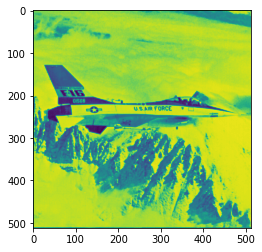

In [ ]:
rows=512
cols=512
#read raw format image with function 'fromfile' from numpy，assign the data type
img_16=np.fromfile(r'/content/F16.raw', dtype='uint8')
# read raw format image with function 'reshape' for array from numpy to rearrange the data
img_16=img_16.reshape(rows, cols)
# show image
pyplot.imshow(img_16)

# turn uint16 into uint8.
cv2.waitKey()
cv2.destroyAllWindows()
print('ok')

In [ ]:
img_16.shape = (512,512)
print(img_16.shape)
raw_16=img_16.astype(np.uint8)#Convert rawfile type from float32 into int8
print(raw_16.dtype)
imageio.imwrite("F16.png", raw_16)

(512, 512)
uint8


####Gamma-Correction

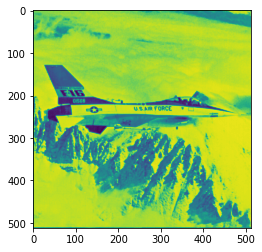

------------------------------------


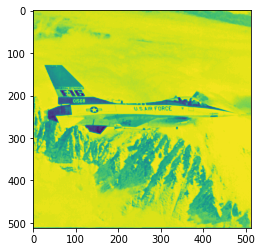

------------------------------------


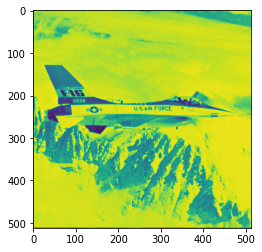

------------------------------------


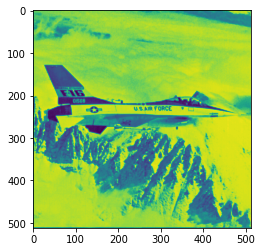

------------------------------------


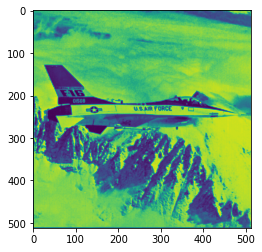

------------------------------------


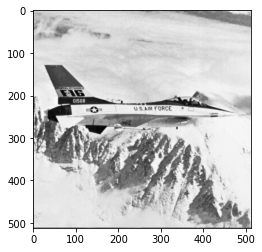

------------------------------------


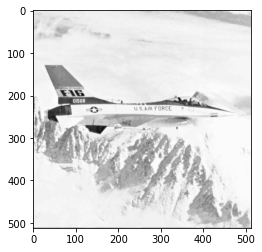

------------------------------------


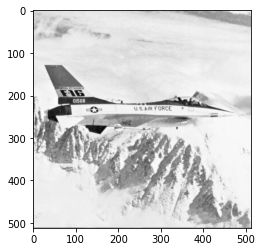

------------------------------------


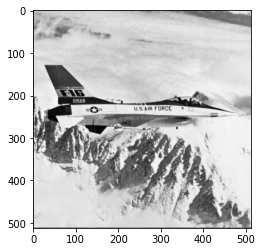

------------------------------------


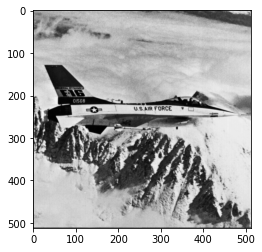

------------------------------------


In [ ]:
# Read an image
plt.imshow(raw_16)
plt.show() 
print("------------------------------------")

# Trying 4 gamma values.
for gamma in [0.1, 0.5, 1.2, 2.2]:
      
    # Apply gamma correction.
    gamma_image = 255*(raw_16 / 255) ** gamma
    # Specify the data type so that float value will be converted to int
    gamma_corrected = np.array(gamma_image, dtype = 'uint8')
  
    # Save edited images.
    cv2.imwrite('gamma_transformed_peppers'+str(gamma)+'.jpg', gamma_corrected)

    # Display both images
    plt.imshow(gamma_corrected)
    plt.show()
    print("------------------------------------")

# Read an image
plt.imshow(raw_16, cmap="gray")
plt.show() 
print("------------------------------------")

# Trying 4 gamma values in grayscale.
for gamma in [0.1, 0.5, 1.2, 2.2]:
      
    # Apply gamma correction.
    gamma_image = 255*(raw_16 / 255) ** gamma
    # Specify the data type so that float value will be converted to int
    gamma_corrected = np.array(gamma_image, dtype = 'uint8')
  
    # Save edited images.
    cv2.imwrite('gamma_transformed_peppers_Gray'+str(gamma)+'.jpg', gamma_corrected)

    # Display both images
    plt.imshow(gamma_corrected, cmap="gray")
    plt.show()
    print("------------------------------------")

請輸入檔案名稱(例如:dog.bmp):F16.png


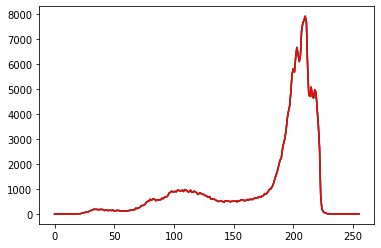

CSV檔產生


32512

In [ ]:
import csv
import os

filename = input('請輸入檔案名稱(例如:dog.bmp):')
try:
	im = cv2.imread(filename)
	#read the data in the range from 0 to 255 of RGB
	BHist = cv2.calcHist([im], [0], None,[256],[0,256])
	GHist = cv2.calcHist([im], [1], None,[256],[0,256])
	RHist = cv2.calcHist([im], [2], None,[256],[0,256])
	#curve plot
	plt.plot(BHist,color='b')
	plt.plot(GHist,color='g')
	plt.plot(RHist,color='r')
	plt.show()

	#convert into one dimension array and int
	RHist = np.hstack(RHist.astype(np.int64))
	GHist = np.hstack(GHist.astype(np.int64))
	BHist = np.hstack(BHist.astype(np.int64))

	#mean & sd 
	mean, std = cv2.meanStdDev(im)
	mean = np.hstack(np.around(mean, decimals=2))
	std = np.hstack(np.around(std, decimals=2))

	#save as CSV
	csvName = filename.split('.')[0]+".csv"
	with open(csvName, 'w', newline='') as csvfile:
		writer = csv.writer(csvfile)
		writer.writerow(['Index', 'R', 'G', 'B'])
		for i in range(256):
			writer.writerow([i, RHist[i], GHist[i], BHist[i]])
		writer.writerow(["Mean", mean[2], mean[1], mean[0]])
		writer.writerow(["STD", std[2], std[1], std[0]])
	print("CSV檔產生")

except:
	print("檔案不存在")
os.system('pause')

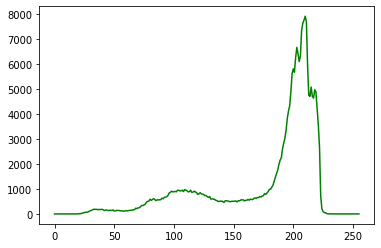

In [ ]:
	plt.plot(GHist,color='g')

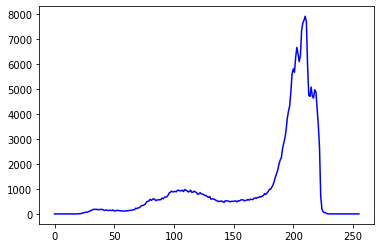

In [ ]:
plt.plot(BHist,color='b')

## 1.Histogram Equalization

In [ ]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

###Definition

In [ ]:
!pip install imtools

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 362 kB 31.6 MB/s 
  Created wheel for imtools: filename=imtools-2.0.1-py3-none-any.whl size=86843 sha256=b59f8eadf52f3c731a0ae30f157fa529596feaddf6607f5356522ea9f868f53b
  Stored in directory: /root/.cache/pip/wheels/89/39/1c/c79e077004b4ab47aaecef41ee9740387aaf52070c91e579a9
Successfully built imtools


In [ ]:
from contextlib import contextmanager
import sys
import warnings
import re
import functools
import os

__all__ = ['all_warnings', 'expected_warnings', 'warn']


# A version of `warnings.warn` with a default stacklevel of 2.
# functool is used so as not to increase the call stack accidentally
warn = functools.partial(warnings.warn, stacklevel=2)


@contextmanager
def all_warnings():
    """
    Context for use in testing to ensure that all warnings are raised.

    Examples
    --------
    >>> import warnings
    >>> def foo():
    ...     warnings.warn(RuntimeWarning("bar"), stacklevel=2)

    We raise the warning once, while the warning filter is set to "once".
    Hereafter, the warning is invisible, even with custom filters:

    >>> with warnings.catch_warnings():
    ...     warnings.simplefilter('once')
    ...     foo()                         # doctest: +SKIP

    We can now run ``foo()`` without a warning being raised:

    >>> from numpy.testing import assert_warns
    >>> foo()                             # doctest: +SKIP

    To catch the warning, we call in the help of ``all_warnings``:

    >>> with all_warnings():
    ...     assert_warns(RuntimeWarning, foo)
    """
    # _warnings.py is on the critical import path.
    # Since this is a testing only function, we lazy import inspect.
    import inspect
    # Whenever a warning is triggered, Python adds a __warningregistry__
    # member to the *calling* module.  The exercize here is to find
    # and eradicate all those breadcrumbs that were left lying around.
    #
    # We proceed by first searching all parent calling frames and explicitly
    # clearing their warning registries (necessary for the doctests above to
    # pass).  Then, we search for all submodules of skimage and clear theirs
    # as well (necessary for the skimage test suite to pass).

    frame = inspect.currentframe()
    if frame:
        for f in inspect.getouterframes(frame):
            f[0].f_locals['__warningregistry__'] = {}
    del frame

    for mod_name, mod in list(sys.modules.items()):
        try:
            mod.__warningregistry__.clear()
        except AttributeError:
            pass

    with warnings.catch_warnings(record=True) as w:
        warnings.simplefilter("always")
        yield w


@contextmanager
def expected_warnings(matching):
    r"""Context for use in testing to catch known warnings matching regexes

    Parameters
    ----------
    matching : None or a list of strings or compiled regexes
        Regexes for the desired warning to catch
        If matching is None, this behaves as a no-op.

    Examples
    --------
    >>> import numpy as np
    >>> rng = np.random.default_rng()
    >>> image = rng.integers(0, 2**16, size=(100, 100), dtype=np.uint16)
    >>> # rank filters are slow when bit-depth exceeds 10 bits
    >>> from skimage import filters
    >>> with expected_warnings(['Bad rank filter performance']):
    ...     median_filtered = filters.rank.median(image)

    Notes
    -----
    Uses `all_warnings` to ensure all warnings are raised.
    Upon exiting, it checks the recorded warnings for the desired matching
    pattern(s).
    Raises a ValueError if any match was not found or an unexpected
    warning was raised.
    Allows for three types of behaviors: `and`, `or`, and `optional` matches.
    This is done to accommodate different build environments or loop conditions
    that may produce different warnings.  The behaviors can be combined.
    If you pass multiple patterns, you get an orderless `and`, where all of the
    warnings must be raised.
    If you use the `|` operator in a pattern, you can catch one of several
    warnings.
    Finally, you can use `|\A\Z` in a pattern to signify it as optional.

    """
    if isinstance(matching, str):
        raise ValueError('``matching`` should be a list of strings and not '
                         'a string itself.')

    # Special case for disabling the context manager
    if matching is None:
        yield None
        return

    strict_warnings = os.environ.get('SKIMAGE_TEST_STRICT_WARNINGS', '1')
    if strict_warnings.lower() == 'true':
        strict_warnings = True
    elif strict_warnings.lower() == 'false':
        strict_warnings = False
    else:
        strict_warnings = bool(int(strict_warnings))

    with all_warnings() as w:
        # enter context
        yield w
        # exited user context, check the recorded warnings
        # Allow users to provide None
        while None in matching:
            matching.remove(None)
        remaining = [m for m in matching if r'\A\Z' not in m.split('|')]
        for warn in w:
            found = False
            for match in matching:
                if re.search(match, str(warn.message)) is not None:
                    found = True
                    if match in remaining:
                        remaining.remove(match)
            if strict_warnings and not found:
                raise ValueError('Unexpected warning: %s' % str(warn.message))
        if strict_warnings and (len(remaining) > 0):
            msg = 'No warning raised matching:\n%s' % '\n'.join(remaining)
            raise ValueError(msg)

In [ ]:
__all__ = ['img_as_float32', 'img_as_float64', 'img_as_float',
           'img_as_int', 'img_as_uint', 'img_as_ubyte',
           'img_as_bool', 'dtype_limits']

# For integers Numpy uses `_integer_types` basis internally, and builds a leaky
# `np.XintYY` abstraction on top of it. This leads to situations when, for
# example, there are two np.Xint64 dtypes with the same attributes but
# different object references. In order to avoid any potential issues,
# we use the basis dtypes here. For more information, see:
# - https://github.com/scikit-image/scikit-image/issues/3043
# For convenience, for these dtypes we indicate also the possible bit depths
# (some of them are platform specific). For the details, see:
# http://www.unix.org/whitepapers/64bit.html
_integer_types = (np.byte, np.ubyte,          # 8 bits
                  np.short, np.ushort,        # 16 bits
                  np.intc, np.uintc,          # 16 or 32 or 64 bits
                  int, np.int_, np.uint,      # 32 or 64 bits
                  np.longlong, np.ulonglong)  # 64 bits
_integer_ranges = {t: (np.iinfo(t).min, np.iinfo(t).max)
                   for t in _integer_types}
dtype_range = {bool: (False, True),
               np.bool_: (False, True),
               np.bool8: (False, True),
               float: (-1, 1),
               np.float_: (-1, 1),
               np.float16: (-1, 1),
               np.float32: (-1, 1),
               np.float64: (-1, 1)}
dtype_range.update(_integer_ranges)

_supported_types = list(dtype_range.keys())


def dtype_limits(image, clip_negative=False):
    """Return intensity limits, i.e. (min, max) tuple, of the image's dtype.

    Parameters
    ----------
    image : ndarray
        Input image.
    clip_negative : bool, optional
        If True, clip the negative range (i.e. return 0 for min intensity)
        even if the image dtype allows negative values.

    Returns
    -------
    imin, imax : tuple
        Lower and upper intensity limits.
    """
    imin, imax = dtype_range[image.dtype.type]
    if clip_negative:
        imin = 0
    return imin, imax


def _dtype_itemsize(itemsize, *dtypes):
    """Return first of `dtypes` with itemsize greater than `itemsize`

    Parameters
    ----------
    itemsize: int
        The data type object element size.

    Other Parameters
    ----------------
    *dtypes:
        Any Object accepted by `np.dtype` to be converted to a data
        type object

    Returns
    -------
    dtype: data type object
        First of `dtypes` with itemsize greater than `itemsize`.

    """
    return next(dt for dt in dtypes if np.dtype(dt).itemsize >= itemsize)


def _dtype_bits(kind, bits, itemsize=1):
    """Return dtype of `kind` that can store a `bits` wide unsigned int

    Parameters:
    kind: str
        Data type kind.
    bits: int
        Desired number of bits.
    itemsize: int
        The data type object element size.

    Returns
    -------
    dtype: data type object
        Data type of `kind` that can store a `bits` wide unsigned int

    """

    s = next(i for i in (itemsize, ) + (2, 4, 8) if
             bits < (i * 8) or (bits == (i * 8) and kind == 'u'))

    return np.dtype(kind + str(s))


def _scale(a, n, m, copy=True):
    """Scale an array of unsigned/positive integers from `n` to `m` bits.

    Numbers can be represented exactly only if `m` is a multiple of `n`.

    Parameters
    ----------
    a : ndarray
        Input image array.
    n : int
        Number of bits currently used to encode the values in `a`.
    m : int
        Desired number of bits to encode the values in `out`.
    copy : bool, optional
        If True, allocates and returns new array. Otherwise, modifies
        `a` in place.

    Returns
    -------
    out : array
        Output image array. Has the same kind as `a`.
    """
    kind = a.dtype.kind
    if n > m and a.max() < 2 ** m:
        mnew = int(np.ceil(m / 2) * 2)
        if mnew > m:
            dtype = f'int{mnew}'
        else:
            dtype = f'uint{mnew}'
        n = int(np.ceil(n / 2) * 2)
        warn(f'Downcasting {a.dtype} to {dtype} without scaling because max '
             f'value {a.max()} fits in {dtype}',
             stacklevel=3)
        return a.astype(_dtype_bits(kind, m))
    elif n == m:
        return a.copy() if copy else a
    elif n > m:
        # downscale with precision loss
        if copy:
            b = np.empty(a.shape, _dtype_bits(kind, m))
            np.floor_divide(a, 2**(n - m), out=b, dtype=a.dtype,
                            casting='unsafe')
            return b
        else:
            a //= 2**(n - m)
            return a
    elif m % n == 0:
        # exact upscale to a multiple of `n` bits
        if copy:
            b = np.empty(a.shape, _dtype_bits(kind, m))
            np.multiply(a, (2**m - 1) // (2**n - 1), out=b, dtype=b.dtype)
            return b
        else:
            a = a.astype(_dtype_bits(kind, m, a.dtype.itemsize), copy=False)
            a *= (2**m - 1) // (2**n - 1)
            return a
    else:
        # upscale to a multiple of `n` bits,
        # then downscale with precision loss
        o = (m // n + 1) * n
        if copy:
            b = np.empty(a.shape, _dtype_bits(kind, o))
            np.multiply(a, (2**o - 1) // (2**n - 1), out=b, dtype=b.dtype)
            b //= 2**(o - m)
            return b
        else:
            a = a.astype(_dtype_bits(kind, o, a.dtype.itemsize), copy=False)
            a *= (2**o - 1) // (2**n - 1)
            a //= 2**(o - m)
            return a


def _convert(image, dtype, force_copy=False, uniform=False):
    """
    Convert an image to the requested data-type.

    Warnings are issued in case of precision loss, or when negative values
    are clipped during conversion to unsigned integer types (sign loss).

    Floating point values are expected to be normalized and will be clipped
    to the range [0.0, 1.0] or [-1.0, 1.0] when converting to unsigned or
    signed integers respectively.

    Numbers are not shifted to the negative side when converting from
    unsigned to signed integer types. Negative values will be clipped when
    converting to unsigned integers.

    Parameters
    ----------
    image : ndarray
        Input image.
    dtype : dtype
        Target data-type.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.
    uniform : bool, optional
        Uniformly quantize the floating point range to the integer range.
        By default (uniform=False) floating point values are scaled and
        rounded to the nearest integers, which minimizes back and forth
        conversion errors.

    .. versionchanged:: 0.15
        ``_convert`` no longer warns about possible precision or sign
        information loss. See discussions on these warnings at:
        https://github.com/scikit-image/scikit-image/issues/2602
        https://github.com/scikit-image/scikit-image/issues/543#issuecomment-208202228
        https://github.com/scikit-image/scikit-image/pull/3575

    References
    ----------
    .. [1] DirectX data conversion rules.
           https://msdn.microsoft.com/en-us/library/windows/desktop/dd607323%28v=vs.85%29.aspx
    .. [2] Data Conversions. In "OpenGL ES 2.0 Specification v2.0.25",
           pp 7-8. Khronos Group, 2010.
    .. [3] Proper treatment of pixels as integers. A.W. Paeth.
           In "Graphics Gems I", pp 249-256. Morgan Kaufmann, 1990.
    .. [4] Dirty Pixels. J. Blinn. In "Jim Blinn's corner: Dirty Pixels",
           pp 47-57. Morgan Kaufmann, 1998.

    """
    image = np.asarray(image)
    dtypeobj_in = image.dtype
    if dtype is np.floating:
        dtypeobj_out = np.dtype('float64')
    else:
        dtypeobj_out = np.dtype(dtype)
    dtype_in = dtypeobj_in.type
    dtype_out = dtypeobj_out.type
    kind_in = dtypeobj_in.kind
    kind_out = dtypeobj_out.kind
    itemsize_in = dtypeobj_in.itemsize
    itemsize_out = dtypeobj_out.itemsize

    # Below, we do an `issubdtype` check.  Its purpose is to find out
    # whether we can get away without doing any image conversion.  This happens
    # when:
    #
    # - the output and input dtypes are the same or
    # - when the output is specified as a type, and the input dtype
    #   is a subclass of that type (e.g. `np.floating` will allow
    #   `float32` and `float64` arrays through)

    if np.issubdtype(dtype_in, np.obj2sctype(dtype)):
        if force_copy:
            image = image.copy()
        return image

    if not (dtype_in in _supported_types and dtype_out in _supported_types):
        raise ValueError(f'Cannot convert from {dtypeobj_in} to '
                         f'{dtypeobj_out}.')

    if kind_in in 'ui':
        imin_in = np.iinfo(dtype_in).min
        imax_in = np.iinfo(dtype_in).max
    if kind_out in 'ui':
        imin_out = np.iinfo(dtype_out).min
        imax_out = np.iinfo(dtype_out).max

    # any -> binary
    if kind_out == 'b':
        return image > dtype_in(dtype_range[dtype_in][1] / 2)

    # binary -> any
    if kind_in == 'b':
        result = image.astype(dtype_out)
        if kind_out != 'f':
            result *= dtype_out(dtype_range[dtype_out][1])
        return result

    # float -> any
    if kind_in == 'f':
        if kind_out == 'f':
            # float -> float
            return image.astype(dtype_out)

        if np.min(image) < -1.0 or np.max(image) > 1.0:
            raise ValueError("Images of type float must be between -1 and 1.")
        # floating point -> integer
        # use float type that can represent output integer type
        computation_type = _dtype_itemsize(itemsize_out, dtype_in,
                                           np.float32, np.float64)

        if not uniform:
            if kind_out == 'u':
                image_out = np.multiply(image, imax_out,
                                        dtype=computation_type)
            else:
                image_out = np.multiply(image, (imax_out - imin_out) / 2,
                                        dtype=computation_type)
                image_out -= 1.0 / 2.
            np.rint(image_out, out=image_out)
            np.clip(image_out, imin_out, imax_out, out=image_out)
        elif kind_out == 'u':
            image_out = np.multiply(image, imax_out + 1,
                                    dtype=computation_type)
            np.clip(image_out, 0, imax_out, out=image_out)
        else:
            image_out = np.multiply(image, (imax_out - imin_out + 1.0) / 2.0,
                                    dtype=computation_type)
            np.floor(image_out, out=image_out)
            np.clip(image_out, imin_out, imax_out, out=image_out)
        return image_out.astype(dtype_out)

    # signed/unsigned int -> float
    if kind_out == 'f':
        # use float type that can exactly represent input integers
        computation_type = _dtype_itemsize(itemsize_in, dtype_out,
                                           np.float32, np.float64)

        if kind_in == 'u':
            # using np.divide or np.multiply doesn't copy the data
            # until the computation time
            image = np.multiply(image, 1. / imax_in,
                                dtype=computation_type)
            # DirectX uses this conversion also for signed ints
            # if imin_in:
            #     np.maximum(image, -1.0, out=image)
        elif kind_in == 'i':
            # From DirectX conversions:
            # The most negative value maps to -1.0f
            # Every other value is converted to a float (call it c)
            # and then result = c * (1.0f / (2⁽ⁿ⁻¹⁾-1)).

            image = np.multiply(image, 1. / imax_in,
                                dtype=computation_type)
            np.maximum(image, -1.0, out=image)

        else:
            image = np.add(image, 0.5, dtype=computation_type)
            image *= 2 / (imax_in - imin_in)

        return np.asarray(image, dtype_out)

    # unsigned int -> signed/unsigned int
    if kind_in == 'u':
        if kind_out == 'i':
            # unsigned int -> signed int
            image = _scale(image, 8 * itemsize_in, 8 * itemsize_out - 1)
            return image.view(dtype_out)
        else:
            # unsigned int -> unsigned int
            return _scale(image, 8 * itemsize_in, 8 * itemsize_out)

    # signed int -> unsigned int
    if kind_out == 'u':
        image = _scale(image, 8 * itemsize_in - 1, 8 * itemsize_out)
        result = np.empty(image.shape, dtype_out)
        np.maximum(image, 0, out=result, dtype=image.dtype, casting='unsafe')
        return result

    # signed int -> signed int
    if itemsize_in > itemsize_out:
        return _scale(image, 8 * itemsize_in - 1, 8 * itemsize_out - 1)

    image = image.astype(_dtype_bits('i', itemsize_out * 8))
    image -= imin_in
    image = _scale(image, 8 * itemsize_in, 8 * itemsize_out, copy=False)
    image += imin_out
    return image.astype(dtype_out)


def convert(image, dtype, force_copy=False, uniform=False):
    warn("The use of this function is discouraged as its behavior may change "
         "dramatically in scikit-image 1.0. This function will be removed "
         "in scikit-image 1.0.", FutureWarning, stacklevel=2)
    return _convert(image=image, dtype=dtype,
                    force_copy=force_copy, uniform=uniform)


if _convert.__doc__ is not None:
    convert.__doc__ = _convert.__doc__ + """

    Warns
    -----
    FutureWarning:
        .. versionadded:: 0.17

        The use of this function is discouraged as its behavior may change
        dramatically in scikit-image 1.0. This function will be removed
        in scikit-image 1.0.
    """


def img_as_float32(image, force_copy=False):
    """Convert an image to single-precision (32-bit) floating point format.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of float32
        Output image.

    Notes
    -----
    The range of a floating point image is [0.0, 1.0] or [-1.0, 1.0] when
    converting from unsigned or signed datatypes, respectively.
    If the input image has a float type, intensity values are not modified
    and can be outside the ranges [0.0, 1.0] or [-1.0, 1.0].

    """
    return _convert(image, np.float32, force_copy)


def img_as_float64(image, force_copy=False):
    """Convert an image to double-precision (64-bit) floating point format.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of float64
        Output image.

    Notes
    -----
    The range of a floating point image is [0.0, 1.0] or [-1.0, 1.0] when
    converting from unsigned or signed datatypes, respectively.
    If the input image has a float type, intensity values are not modified
    and can be outside the ranges [0.0, 1.0] or [-1.0, 1.0].

    """
    return _convert(image, np.float64, force_copy)


def img_as_float(image, force_copy=False):
    """Convert an image to floating point format.

    This function is similar to `img_as_float64`, but will not convert
    lower-precision floating point arrays to `float64`.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of float
        Output image.

    Notes
    -----
    The range of a floating point image is [0.0, 1.0] or [-1.0, 1.0] when
    converting from unsigned or signed datatypes, respectively.
    If the input image has a float type, intensity values are not modified
    and can be outside the ranges [0.0, 1.0] or [-1.0, 1.0].

    """
    return _convert(image, np.floating, force_copy)


def img_as_uint(image, force_copy=False):
    """Convert an image to 16-bit unsigned integer format.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of uint16
        Output image.

    Notes
    -----
    Negative input values will be clipped.
    Positive values are scaled between 0 and 65535.

    """
    return _convert(image, np.uint16, force_copy)


def img_as_int(image, force_copy=False):
    """Convert an image to 16-bit signed integer format.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of int16
        Output image.

    Notes
    -----
    The values are scaled between -32768 and 32767.
    If the input data-type is positive-only (e.g., uint8), then
    the output image will still only have positive values.

    """
    return _convert(image, np.int16, force_copy)


def img_as_ubyte(image, force_copy=False):
    """Convert an image to 8-bit unsigned integer format.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of ubyte (uint8)
        Output image.

    Notes
    -----
    Negative input values will be clipped.
    Positive values are scaled between 0 and 255.

    """
    return _convert(image, np.uint8, force_copy)


def img_as_bool(image, force_copy=False):
    """Convert an image to boolean format.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of bool (`bool_`)
        Output image.

    Notes
    -----
    The upper half of the input dtype's positive range is True, and the lower
    half is False. All negative values (if present) are False.

    """
    return _convert(image, bool, force_copy)

In [ ]:
import inspect
import functools
import sys
import warnings
from collections.abc import Iterable

import numpy as np
import scipy
from numpy.lib import NumpyVersion

__all__ = ['deprecated', 'get_bound_method_class', 'all_warnings',
           'safe_as_int', 'check_shape_equality', 'check_nD', 'warn',
           'reshape_nd', 'identity', 'slice_at_axis']


class skimage_deprecation(Warning):
    """Create our own deprecation class, since Python >= 2.7
    silences deprecations by default.

    """
    pass


def _get_stack_rank(func):
    """Return function rank in the call stack."""
    if _is_wrapped(func):
        return 1 + _get_stack_rank(func.__wrapped__)
    else:
        return 0


def _is_wrapped(func):
    return "__wrapped__" in dir(func)


def _get_stack_length(func):
    """Return function call stack length."""
    return _get_stack_rank(func.__globals__.get(func.__name__, func))


class _DecoratorBaseClass:
    """Used to manage decorators' warnings stacklevel.

    The `_stack_length` class variable is used to store the number of
    times a function is wrapped by a decorator.

    Let `stack_length` be the total number of times a decorated
    function is wrapped, and `stack_rank` be the rank of the decorator
    in the decorators stack. The stacklevel of a warning is then
    `stacklevel = 1 + stack_length - stack_rank`.
    """

    _stack_length = {}

    def get_stack_length(self, func):
        return self._stack_length.get(func.__name__,
                                      _get_stack_length(func))


class change_default_value(_DecoratorBaseClass):
    """Decorator for changing the default value of an argument.

    Parameters
    ----------
    arg_name: str
        The name of the argument to be updated.
    new_value: any
        The argument new value.
    changed_version : str
        The package version in which the change will be introduced.
    warning_msg: str
        Optional warning message. If None, a generic warning message
        is used.

    """

    def __init__(self, arg_name, *, new_value, changed_version,
                 warning_msg=None):
        self.arg_name = arg_name
        self.new_value = new_value
        self.warning_msg = warning_msg
        self.changed_version = changed_version

    def __call__(self, func):
        parameters = inspect.signature(func).parameters
        arg_idx = list(parameters.keys()).index(self.arg_name)
        old_value = parameters[self.arg_name].default

        stack_rank = _get_stack_rank(func)

        if self.warning_msg is None:
            self.warning_msg = (
                f'The new recommended value for {self.arg_name} is '
                f'{self.new_value}. Until version {self.changed_version}, '
                f'the default {self.arg_name} value is {old_value}. '
                f'From version {self.changed_version}, the {self.arg_name} '
                f'default value will be {self.new_value}. To avoid '
                f'this warning, please explicitly set {self.arg_name} value.')

        @functools.wraps(func)
        def fixed_func(*args, **kwargs):
            stacklevel = 1 + self.get_stack_length(func) - stack_rank
            if len(args) < arg_idx + 1 and self.arg_name not in kwargs.keys():
                # warn that arg_name default value changed:
                warnings.warn(self.warning_msg, FutureWarning,
                              stacklevel=stacklevel)
            return func(*args, **kwargs)

        return fixed_func


class remove_arg(_DecoratorBaseClass):
    """Decorator to remove an argument from function's signature.

    Parameters
    ----------
    arg_name: str
        The name of the argument to be removed.
    changed_version : str
        The package version in which the warning will be replaced by
        an error.
    help_msg: str
        Optional message appended to the generic warning message.

    """

    def __init__(self, arg_name, *, changed_version, help_msg=None):
        self.arg_name = arg_name
        self.help_msg = help_msg
        self.changed_version = changed_version

    def __call__(self, func):

        parameters = inspect.signature(func).parameters
        arg_idx = list(parameters.keys()).index(self.arg_name)
        warning_msg = (
            f'{self.arg_name} argument is deprecated and will be removed '
            f'in version {self.changed_version}. To avoid this warning, '
            f'please do not use the {self.arg_name} argument. Please '
            f'see {func.__name__} documentation for more details.')

        if self.help_msg is not None:
            warning_msg += f' {self.help_msg}'

        stack_rank = _get_stack_rank(func)

        @functools.wraps(func)
        def fixed_func(*args, **kwargs):
            stacklevel = 1 + self.get_stack_length(func) - stack_rank
            if len(args) > arg_idx or self.arg_name in kwargs.keys():
                # warn that arg_name is deprecated
                warnings.warn(warning_msg, FutureWarning,
                              stacklevel=stacklevel)
            return func(*args, **kwargs)

        return fixed_func


def docstring_add_deprecated(func, kwarg_mapping, deprecated_version):
    """Add deprecated kwarg(s) to the "Other Params" section of a docstring.

    Parameters
    ---------
    func : function
        The function whose docstring we wish to update.
    kwarg_mapping : dict
        A dict containing {old_arg: new_arg} key/value pairs as used by
        `deprecate_kwarg`.
    deprecated_version : str
        A major.minor version string specifying when old_arg was
        deprecated.

    Returns
    -------
    new_doc : str
        The updated docstring. Returns the original docstring if numpydoc is
        not available.
    """
    if func.__doc__ is None:
        return None
    try:
        from numpydoc.docscrape import FunctionDoc, Parameter
    except ImportError:
        # Return an unmodified docstring if numpydoc is not available.
        return func.__doc__

    Doc = FunctionDoc(func)
    for old_arg, new_arg in kwarg_mapping.items():
        desc = [f'Deprecated in favor of `{new_arg}`.',
                f'',
                f'.. deprecated:: {deprecated_version}']
        Doc['Other Parameters'].append(
            Parameter(name=old_arg,
                      type='DEPRECATED',
                      desc=desc)
        )
    new_docstring = str(Doc)

    # new_docstring will have a header starting with:
    #
    # .. function:: func.__name__
    #
    # and some additional blank lines. We strip these off below.
    split = new_docstring.split('\n')
    no_header = split[1:]
    while not no_header[0].strip():
        no_header.pop(0)

    # Store the initial description before any of the Parameters fields.
    # Usually this is a single line, but the while loop covers any case
    # where it is not.
    descr = no_header.pop(0)
    while no_header[0].strip():
        descr += '\n    ' + no_header.pop(0)
    descr += '\n\n'
    # '\n    ' rather than '\n' here to restore the original indentation.
    final_docstring = descr + '\n    '.join(no_header)
    # strip any extra spaces from ends of lines
    final_docstring = '\n'.join(
        [line.rstrip() for line in final_docstring.split('\n')]
    )
    return final_docstring


class deprecate_kwarg(_DecoratorBaseClass):
    """Decorator ensuring backward compatibility when argument names are
    modified in a function definition.

    Parameters
    ----------
    kwarg_mapping: dict
        Mapping between the function's old argument names and the new
        ones.
    deprecated_version : str
        The package version in which the argument was first deprecated.
    warning_msg: str
        Optional warning message. If None, a generic warning message
        is used.
    removed_version : str
        The package version in which the deprecated argument will be
        removed.

    """

    def __init__(self, kwarg_mapping, deprecated_version, warning_msg=None,
                 removed_version=None):
        self.kwarg_mapping = kwarg_mapping
        if warning_msg is None:
            self.warning_msg = ("`{old_arg}` is a deprecated argument name "
                                "for `{func_name}`. ")
            if removed_version is not None:
                self.warning_msg += (f'It will be removed in '
                                     f'version {removed_version}. ')
            self.warning_msg += "Please use `{new_arg}` instead."
        else:
            self.warning_msg = warning_msg

        self.deprecated_version = deprecated_version

    def __call__(self, func):

        stack_rank = _get_stack_rank(func)

        @functools.wraps(func)
        def fixed_func(*args, **kwargs):
            stacklevel = 1 + self.get_stack_length(func) - stack_rank

            for old_arg, new_arg in self.kwarg_mapping.items():
                if old_arg in kwargs:
                    #  warn that the function interface has changed:
                    warnings.warn(self.warning_msg.format(
                        old_arg=old_arg, func_name=func.__name__,
                        new_arg=new_arg), FutureWarning,
                        stacklevel=stacklevel)
                    # Substitute new_arg to old_arg
                    kwargs[new_arg] = kwargs.pop(old_arg)

            # Call the function with the fixed arguments
            return func(*args, **kwargs)

        if func.__doc__ is not None:
            newdoc = docstring_add_deprecated(func, self.kwarg_mapping,
                                              self.deprecated_version)
            fixed_func.__doc__ = newdoc
        return fixed_func


class deprecate_multichannel_kwarg(deprecate_kwarg):
    """Decorator for deprecating multichannel keyword in favor of channel_axis.

    Parameters
    ----------
    removed_version : str
        The package version in which the deprecated argument will be
        removed.

    """

    def __init__(self, removed_version='1.0', multichannel_position=None):
        super().__init__(
            kwarg_mapping={'multichannel': 'channel_axis'},
            deprecated_version='0.19',
            warning_msg=None,
            removed_version=removed_version)
        self.position = multichannel_position

    def __call__(self, func):

        stack_rank = _get_stack_rank(func)

        @functools.wraps(func)
        def fixed_func(*args, **kwargs):
            stacklevel = 1 + self.get_stack_length(func) - stack_rank

            if self.position is not None and len(args) > self.position:
                warning_msg = (
                    "Providing the `multichannel` argument positionally to "
                    "{func_name} is deprecated. Use the `channel_axis` kwarg "
                    "instead."
                )
                warnings.warn(warning_msg.format(func_name=func.__name__),
                              FutureWarning,
                              stacklevel=stacklevel)
                if 'channel_axis' in kwargs:
                    raise ValueError(
                        "Cannot provide both a `channel_axis` kwarg and a "
                        "positional `multichannel` value."
                    )
                else:
                    channel_axis = -1 if args[self.position] else None
                    kwargs['channel_axis'] = channel_axis

            if 'multichannel' in kwargs:
                #  warn that the function interface has changed:
                warnings.warn(self.warning_msg.format(
                    old_arg='multichannel', func_name=func.__name__,
                    new_arg='channel_axis'), FutureWarning,
                    stacklevel=stacklevel)

                # multichannel = True -> last axis corresponds to channels
                convert = {True: -1, False: None}
                kwargs['channel_axis'] = convert[kwargs.pop('multichannel')]

            # Call the function with the fixed arguments
            return func(*args, **kwargs)

        if func.__doc__ is not None:
            newdoc = docstring_add_deprecated(
                func, {'multichannel': 'channel_axis'}, '0.19')
            fixed_func.__doc__ = newdoc
        return fixed_func


class channel_as_last_axis:
    """Decorator for automatically making channels axis last for all arrays.

    This decorator reorders axes for compatibility with functions that only
    support channels along the last axis. After the function call is complete
    the channels axis is restored back to its original position.

    Parameters
    ----------
    channel_arg_positions : tuple of int, optional
        Positional arguments at the positions specified in this tuple are
        assumed to be multichannel arrays. The default is to assume only the
        first argument to the function is a multichannel array.
    channel_kwarg_names : tuple of str, optional
        A tuple containing the names of any keyword arguments corresponding to
        multichannel arrays.
    multichannel_output : bool, optional
        A boolean that should be True if the output of the function is not a
        multichannel array and False otherwise. This decorator does not
        currently support the general case of functions with multiple outputs
        where some or all are multichannel.

    """
    def __init__(self, channel_arg_positions=(0,), channel_kwarg_names=(),
                 multichannel_output=True):
        self.arg_positions = set(channel_arg_positions)
        self.kwarg_names = set(channel_kwarg_names)
        self.multichannel_output = multichannel_output

    def __call__(self, func):

        @functools.wraps(func)
        def fixed_func(*args, **kwargs):

            channel_axis = kwargs.get('channel_axis', None)

            if channel_axis is None:
                return func(*args, **kwargs)

            # TODO: convert scalars to a tuple in anticipation of eventually
            #       supporting a tuple of channel axes. Right now, only an
            #       integer or a single-element tuple is supported, though.
            if np.isscalar(channel_axis):
                channel_axis = (channel_axis,)
            if len(channel_axis) > 1:
                raise ValueError(
                    "only a single channel axis is currently suported")

            if channel_axis == (-1,) or channel_axis == -1:
                return func(*args, **kwargs)

            if self.arg_positions:
                new_args = []
                for pos, arg in enumerate(args):
                    if pos in self.arg_positions:
                        new_args.append(np.moveaxis(arg, channel_axis[0], -1))
                    else:
                        new_args.append(arg)
                new_args = tuple(new_args)
            else:
                new_args = args

            for name in self.kwarg_names:
                kwargs[name] = np.moveaxis(kwargs[name], channel_axis[0], -1)

            # now that we have moved the channels axis to the last position,
            # change the channel_axis argument to -1
            kwargs["channel_axis"] = -1

            # Call the function with the fixed arguments
            out = func(*new_args, **kwargs)
            if self.multichannel_output:
                out = np.moveaxis(out, -1, channel_axis[0])
            return out

        return fixed_func


class deprecated:
    """Decorator to mark deprecated functions with warning.

    Adapted from <http://wiki.python.org/moin/PythonDecoratorLibrary>.

    Parameters
    ----------
    alt_func : str
        If given, tell user what function to use instead.
    behavior : {'warn', 'raise'}
        Behavior during call to deprecated function: 'warn' = warn user that
        function is deprecated; 'raise' = raise error.
    removed_version : str
        The package version in which the deprecated function will be removed.
    """

    def __init__(self, alt_func=None, behavior='warn', removed_version=None):
        self.alt_func = alt_func
        self.behavior = behavior
        self.removed_version = removed_version

    def __call__(self, func):

        alt_msg = ''
        if self.alt_func is not None:
            alt_msg = ' Use ``%s`` instead.' % self.alt_func
        rmv_msg = ''
        if self.removed_version is not None:
            rmv_msg = (' and will be removed in version %s' %
                       self.removed_version)

        msg = ('Function ``%s`` is deprecated' % func.__name__ +
               rmv_msg + '.' + alt_msg)

        @functools.wraps(func)
        def wrapped(*args, **kwargs):
            if self.behavior == 'warn':
                func_code = func.__code__
                warnings.simplefilter('always', skimage_deprecation)
                warnings.warn_explicit(msg,
                                       category=skimage_deprecation,
                                       filename=func_code.co_filename,
                                       lineno=func_code.co_firstlineno + 1)
            elif self.behavior == 'raise':
                raise skimage_deprecation(msg)
            return func(*args, **kwargs)

        # modify doc string to display deprecation warning
        doc = '**Deprecated function**.' + alt_msg
        if wrapped.__doc__ is None:
            wrapped.__doc__ = doc
        else:
            wrapped.__doc__ = doc + '\n\n    ' + wrapped.__doc__

        return wrapped


def get_bound_method_class(m):
    """Return the class for a bound method.

    """
    return m.im_class if sys.version < '3' else m.__self__.__class__


def safe_as_int(val, atol=1e-3):
    """
    Attempt to safely cast values to integer format.

    Parameters
    ----------
    val : scalar or iterable of scalars
        Number or container of numbers which are intended to be interpreted as
        integers, e.g., for indexing purposes, but which may not carry integer
        type.
    atol : float
        Absolute tolerance away from nearest integer to consider values in
        ``val`` functionally integers.

    Returns
    -------
    val_int : NumPy scalar or ndarray of dtype `np.int64`
        Returns the input value(s) coerced to dtype `np.int64` assuming all
        were within ``atol`` of the nearest integer.

    Notes
    -----
    This operation calculates ``val`` modulo 1, which returns the mantissa of
    all values. Then all mantissas greater than 0.5 are subtracted from one.
    Finally, the absolute tolerance from zero is calculated. If it is less
    than ``atol`` for all value(s) in ``val``, they are rounded and returned
    in an integer array. Or, if ``val`` was a scalar, a NumPy scalar type is
    returned.

    If any value(s) are outside the specified tolerance, an informative error
    is raised.

    Examples
    --------
    >>> safe_as_int(7.0)
    7

    >>> safe_as_int([9, 4, 2.9999999999])
    array([9, 4, 3])

    >>> safe_as_int(53.1)
    Traceback (most recent call last):
        ...
    ValueError: Integer argument required but received 53.1, check inputs.

    >>> safe_as_int(53.01, atol=0.01)
    53

    """
    mod = np.asarray(val) % 1                # Extract mantissa

    # Check for and subtract any mod values > 0.5 from 1
    if mod.ndim == 0:                        # Scalar input, cannot be indexed
        if mod > 0.5:
            mod = 1 - mod
    else:                                    # Iterable input, now ndarray
        mod[mod > 0.5] = 1 - mod[mod > 0.5]  # Test on each side of nearest int

    try:
        np.testing.assert_allclose(mod, 0, atol=atol)
    except AssertionError:
        raise ValueError(f'Integer argument required but received '
                         f'{val}, check inputs.')

    return np.round(val).astype(np.int64)


def check_shape_equality(im1, im2):
    """Raise an error if the shape do not match."""
    if not im1.shape == im2.shape:
        raise ValueError('Input images must have the same dimensions.')
    return


def slice_at_axis(sl, axis):
    """
    Construct tuple of slices to slice an array in the given dimension.

    Parameters
    ----------
    sl : slice
        The slice for the given dimension.
    axis : int
        The axis to which `sl` is applied. All other dimensions are left
        "unsliced".

    Returns
    -------
    sl : tuple of slices
        A tuple with slices matching `shape` in length.

    Examples
    --------
    >>> slice_at_axis(slice(None, 3, -1), 1)
    (slice(None, None, None), slice(None, 3, -1), Ellipsis)
    """
    return (slice(None),) * axis + (sl,) + (...,)


def reshape_nd(arr, ndim, dim):
    """Reshape a 1D array to have n dimensions, all singletons but one.

    Parameters
    ----------
    arr : array, shape (N,)
        Input array
    ndim : int
        Number of desired dimensions of reshaped array.
    dim : int
        Which dimension/axis will not be singleton-sized.

    Returns
    -------
    arr_reshaped : array, shape ([1, ...], N, [1,...])
        View of `arr` reshaped to the desired shape.

    Examples
    --------
    >>> rng = np.random.default_rng()
    >>> arr = rng.random(7)
    >>> reshape_nd(arr, 2, 0).shape
    (7, 1)
    >>> reshape_nd(arr, 3, 1).shape
    (1, 7, 1)
    >>> reshape_nd(arr, 4, -1).shape
    (1, 1, 1, 7)
    """
    if arr.ndim != 1:
        raise ValueError("arr must be a 1D array")
    new_shape = [1] * ndim
    new_shape[dim] = -1
    return np.reshape(arr, new_shape)


def check_nD(array, ndim, arg_name='image'):
    """
    Verify an array meets the desired ndims and array isn't empty.

    Parameters
    ----------
    array : array-like
        Input array to be validated
    ndim : int or iterable of ints
        Allowable ndim or ndims for the array.
    arg_name : str, optional
        The name of the array in the original function.

    """
    array = np.asanyarray(array)
    msg_incorrect_dim = "The parameter `%s` must be a %s-dimensional array"
    msg_empty_array = "The parameter `%s` cannot be an empty array"
    if isinstance(ndim, int):
        ndim = [ndim]
    if array.size == 0:
        raise ValueError(msg_empty_array % (arg_name))
    if array.ndim not in ndim:
        raise ValueError(
            msg_incorrect_dim % (arg_name, '-or-'.join([str(n) for n in ndim]))
        )

def img_as_float(image, force_copy=False):
    """Convert an image to floating point format.
    This function is similar to `img_as_float64`, but will not convert
    lower-precision floating point arrays to `float64`.
    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.
    Returns
    -------
    out : ndarray of float
        Output image.
    Notes
    -----
    The range of a floating point image is [0.0, 1.0] or [-1.0, 1.0] when
    converting from unsigned or signed datatypes, respectively.
    If the input image has a float type, intensity values are not modified
    and can be outside the ranges [0.0, 1.0] or [-1.0, 1.0].
    """
    return _convert(image, np.floating, force_copy)

def convert_to_float(image, preserve_range):
    """Convert input image to float image with the appropriate range.

    Parameters
    ----------
    image : ndarray
        Input image.
    preserve_range : bool
        Determines if the range of the image should be kept or transformed
        using img_as_float. Also see
        https://scikit-image.org/docs/dev/user_guide/data_types.html

    Notes
    -----
    * Input images with `float32` data type are not upcast.

    Returns
    -------
    image : ndarray
        Transformed version of the input.

    """
    if image.dtype == np.float16:
        return image.astype(np.float32)
    if preserve_range:
        # Convert image to double only if it is not single or double
        # precision float
        if image.dtype.char not in 'df':
            image = image.astype(float)
    else:
        import img_as_float
        image = img_as_float(image)
    return image


def _validate_interpolation_order(image_dtype, order):
    """Validate and return spline interpolation's order.

    Parameters
    ----------
    image_dtype : dtype
        Image dtype.
    order : int, optional
        The order of the spline interpolation. The order has to be in
        the range 0-5. See `skimage.transform.warp` for detail.

    Returns
    -------
    order : int
        if input order is None, returns 0 if image_dtype is bool and 1
        otherwise. Otherwise, image_dtype is checked and input order
        is validated accordingly (order > 0 is not supported for bool
        image dtype)

    """

    if order is None:
        return 0 if image_dtype == bool else 1

    if order < 0 or order > 5:
        raise ValueError("Spline interpolation order has to be in the "
                         "range 0-5.")

    if image_dtype == bool and order != 0:
        raise ValueError(
            "Input image dtype is bool. Interpolation is not defined "
             "with bool data type. Please set order to 0 or explicitely "
             "cast input image to another data type.")

    return order


def _to_np_mode(mode):
    """Convert padding modes from `ndi.correlate` to `np.pad`."""
    mode_translation_dict = dict(nearest='edge', reflect='symmetric',
                                 mirror='reflect')
    if mode in mode_translation_dict:
        mode = mode_translation_dict[mode]
    return mode


def _to_ndimage_mode(mode):
    """Convert from `numpy.pad` mode name to the corresponding ndimage mode."""
    mode_translation_dict = dict(constant='constant', edge='nearest',
                                 symmetric='reflect', reflect='mirror',
                                 wrap='wrap')
    if mode not in mode_translation_dict:
        raise ValueError(
            (f"Unknown mode: '{mode}', or cannot translate mode. The "
             f"mode should be one of 'constant', 'edge', 'symmetric', "
             f"'reflect', or 'wrap'. See the documentation of numpy.pad for "
             f"more info."))
    return _fix_ndimage_mode(mode_translation_dict[mode])


def _fix_ndimage_mode(mode):
    # SciPy 1.6.0 introduced grid variants of constant and wrap which
    # have less surprising behavior for images. Use these when available
    grid_modes = {'constant': 'grid-constant', 'wrap': 'grid-wrap'}
    if NumpyVersion(scipy.__version__) >= '1.6.0':
        mode = grid_modes.get(mode, mode)
    return mode


new_float_type = {
    # preserved types
    np.float32().dtype.char: np.float32,
    np.float64().dtype.char: np.float64,
    np.complex64().dtype.char: np.complex64,
    np.complex128().dtype.char: np.complex128,
    # altered types
    np.float16().dtype.char: np.float32,
    'g': np.float64,      # np.float128 ; doesn't exist on windows
    'G': np.complex128,   # np.complex256 ; doesn't exist on windows
}


def _supported_float_type(input_dtype, allow_complex=False):
    """Return an appropriate floating-point dtype for a given dtype.

    float32, float64, complex64, complex128 are preserved.
    float16 is promoted to float32.
    complex256 is demoted to complex128.
    Other types are cast to float64.

    Parameters
    ----------
    input_dtype : np.dtype or Iterable of np.dtype
        The input dtype. If a sequence of multiple dtypes is provided, each
        dtype is first converted to a supported floating point type and the
        final dtype is then determined by applying `np.result_type` on the
        sequence of supported floating point types.
    allow_complex : bool, optional
        If False, raise a ValueError on complex-valued inputs.

    Returns
    -------
    float_type : dtype
        Floating-point dtype for the image.
    """
    if isinstance(input_dtype, Iterable) and not isinstance(input_dtype, str):
        return np.result_type(*(_supported_float_type(d) for d in input_dtype))
    input_dtype = np.dtype(input_dtype)
    if not allow_complex and input_dtype.kind == 'c':
        raise ValueError("complex valued input is not supported")
    return new_float_type.get(input_dtype.char, np.float64)


def identity(image, *args, **kwargs):
    """Returns the first argument unmodified."""
    return image

In [ ]:
def histeq(im,nbr_bins=256):
    """    Histogram equalization of a grayscale image. """
    
    # get image histogram
    imhist,bins = np.histogram(im.flatten(),nbr_bins,normed=True)
    cdf = imhist.cumsum() # cumulative distribution function
    cdf = 255 * cdf / cdf[-1] # normalize
    
    # use linear interpolation of cdf to find new pixel values
    im2 = np.interp(im.flatten(),bins[:-1],cdf)
    
    return im2.reshape(im.shape), cdf

def disk(radius, dtype=np.uint8):
    """Generates a flat, disk-shaped footprint.
    A pixel is within the neighborhood if the Euclidean distance between
    it and the origin is no greater than radius.
    Parameters
    ----------
    radius : int
        The radius of the disk-shaped footprint.
    Other Parameters
    ----------------
    dtype : data-type
        The data type of the footprint.
    Returns
    -------
    footprint : ndarray
        The footprint where elements of the neighborhood are 1 and 0 otherwise.
    """
    L = np.arange(-radius, radius + 1)
    X, Y = np.meshgrid(L, L)
    return np.array((X ** 2 + Y ** 2) <= radius ** 2, dtype=dtype)

def ball(radius, dtype=np.uint8):
    """Generates a ball-shaped footprint.
    This is the 3D equivalent of a disk.
    A pixel is within the neighborhood if the Euclidean distance between
    it and the origin is no greater than radius.
    Parameters
    ----------
    radius : int
        The radius of the ball-shaped footprint.
    Other Parameters
    ----------------
    dtype : data-type
        The data type of the footprint.
    Returns
    -------
    footprint : ndarray
        The footprint where elements of the neighborhood are 1 and 0 otherwise.
    """
    n = 2 * radius + 1
    Z, Y, X = np.mgrid[-radius:radius:n * 1j,
                       -radius:radius:n * 1j,
                       -radius:radius:n * 1j]
    s = X ** 2 + Y ** 2 + Z ** 2
    return np.array(s <= radius * radius, dtype=dtype)


def _apply_scalar_per_pixel(func, image, footprint, out, mask, shift_x,
                            shift_y, out_dtype=None):
    """Process the specific cython function to the image.
    Parameters
    ----------
    func : function
        Cython function to apply.
    image : 2-D array (integer or float)
        Input image.
    footprint : 2-D array (integer or float)
        The neighborhood expressed as a 2-D array of 1's and 0's.
    out : 2-D array (integer or float)
        If None, a new array is allocated.
    mask : ndarray (integer or float)
        Mask array that defines (>0) area of the image included in the local
        neighborhood. If None, the complete image is used (default).
    shift_x, shift_y : int
        Offset added to the footprint center point. Shift is bounded to the
        footprint sizes (center must be inside the given footprint).
    out_dtype : data-type, optional
        Desired output data-type. Default is None, which means we cast output
        in input dtype.
    """
    # preprocess and verify the input
    image, footprint, out, mask, n_bins = _preprocess_input(image, footprint,
                                                            out, mask,
                                                            out_dtype)

    # apply cython function
    func(image, footprint, shift_x=shift_x, shift_y=shift_y, mask=mask,
         out=out, n_bins=n_bins)

    return np.squeeze(out, axis=-1)

def check_nD(array, ndim, arg_name='image'):
    """
    Verify an array meets the desired ndims and array isn't empty.
    Parameters
    ----------
    array : array-like
        Input array to be validated
    ndim : int or iterable of ints
        Allowable ndim or ndims for the array.
    arg_name : str, optional
        The name of the array in the original function.
    """
    array = np.asanyarray(array)
    msg_incorrect_dim = "The parameter `%s` must be a %s-dimensional array"
    msg_empty_array = "The parameter `%s` cannot be an empty array"
    if isinstance(ndim, int):
        ndim = [ndim]
    if array.size == 0:
        raise ValueError(msg_empty_array % (arg_name))
    if array.ndim not in ndim:
        raise ValueError(
            msg_incorrect_dim % (arg_name, '-or-'.join([str(n) for n in ndim]))
        )

def _handle_input_3D(image, footprint=None, out=None, mask=None,
                     out_dtype=None, pixel_size=1):
    """Preprocess and verify input for filters.rank methods.
    Parameters
    ----------
    image : 3-D array (integer or float)
        Input image.
    footprint : 3-D array (integer or float), optional
        The neighborhood expressed as a 3-D array of 1's and 0's.
    out : 3-D array (integer or float), optional
        If None, a new array is allocated.
    mask : ndarray (integer or float), optional
        Mask array that defines (>0) area of the image included in the local
        neighborhood. If None, the complete image is used (default).
    out_dtype : data-type, optional
        Desired output data-type. Default is None, which means we cast output
        in input dtype.
    pixel_size : int, optional
        Dimension of each pixel. Default value is 1.
    Returns
    -------
    image : 3-D array (np.uint8 or np.uint16)
    footprint : 3-D array (np.uint8)
        The neighborhood expressed as a binary 3-D array.
    out : 3-D array (same dtype out_dtype or as input)
        Output array. The two first dimensions are the spatial ones, the third
        one is the pixel vector (length 1 by default).
    mask : 3-D array (np.uint8)
        Mask array that defines (>0) area of the image included in the local
        neighborhood.
    n_bins : int
        Number of histogram bins.
    """
    check_nD(image, 3)
    if image.dtype not in (np.uint8, np.uint16):
        message = (f'Possible precision loss converting image of type '
                   f'{image.dtype} to uint8 as required by rank filters. '
                   f'Convert manually using skimage.util.img_as_ubyte to '
                   f'silence this warning.')
        warn(message, stacklevel=2)
        image = img_as_ubyte(image)

    footprint = np.ascontiguousarray(img_as_ubyte(footprint > 0))
    if footprint.ndim != image.ndim:
        raise ValueError('Image dimensions and neighborhood dimensions'
                         'do not match')
    image = np.ascontiguousarray(image)

    if mask is None:
        mask = np.ones(image.shape, dtype=np.uint8)
    else:
        mask = img_as_ubyte(mask)
        mask = np.ascontiguousarray(mask)

    if image is out:
        raise NotImplementedError("Cannot perform rank operation in place.")

    if out is None:
        if out_dtype is None:
            out_dtype = image.dtype
        out = np.empty(image.shape + (pixel_size,), dtype=out_dtype)
    else:
        out = out.reshape(out.shape + (pixel_size,))

    is_8bit = image.dtype in (np.uint8, np.int8)

    if is_8bit:
        n_bins = 256
    else:
        # Convert to a Python int to avoid the potential overflow when we add
        # 1 to the maximum of the image.
        n_bins = int(max(3, image.max())) + 1

    if n_bins > 2**10:
        warn(f'Bad rank filter performance is expected due to a '
             f'large number of bins ({n_bins}), equivalent to an approximate '
             f'bitdepth of {np.log2(n_bins):.1f}.',
             stacklevel=2)

    return image, footprint, out, mask, n_bins

def _apply_scalar_per_pixel_3D(func, image, footprint, out, mask, shift_x,
                               shift_y, shift_z, out_dtype=None):

    image, footprint, out, mask, n_bins = _handle_input_3D(
        image, footprint, out, mask, out_dtype
    )

    func(image, footprint, shift_x=shift_x, shift_y=shift_y, shift_z=shift_z,
         mask=mask, out=out, n_bins=n_bins)

    return out.reshape(out.shape[:3])


@deprecate_kwarg(kwarg_mapping={'selem': 'footprint'}, removed_version="1.0",
                 deprecated_version="0.19")
def equalize(image, footprint, out=None, mask=None,
             shift_x=False, shift_y=False, shift_z=False):
    """Equalize image using local histogram.
    Parameters
    ----------
    image : ([P,] M, N) ndarray (uint8, uint16)
        Input image.
    footprint : ndarray
        The neighborhood expressed as an ndarray of 1's and 0's.
    out : ([P,] M, N) array (same dtype as input)
        If None, a new array is allocated.
    mask : ndarray (integer or float), optional
        Mask array that defines (>0) area of the image included in the local
        neighborhood. If None, the complete image is used (default).
    shift_x, shift_y, shift_z : int
        Offset added to the footprint center point. Shift is bounded to the
        footprint sizes (center must be inside the given footprint).
    Returns
    -------
    out : ([P,] M, N) ndarray (same dtype as input image)
        Output image.
    Examples
    --------
    >>> from skimage import data
    >>> from skimage.morphology import disk, ball
    >>> from skimage.filters.rank import equalize
    >>> import numpy as np
    >>> img = data.camera()
    >>> rng = np.random.default_rng()
    >>> volume = rng.integers(0, 255, size=(10,10,10), dtype=np.uint8)
    >>> equ = equalize(img, disk(5))
    >>> equ_vol = equalize(volume, ball(5))
    """

    np_image = np.asanyarray(image)
    if np_image.ndim == 2:
        return _apply_scalar_per_pixel(_equalize, image, footprint,
                                       out=out, mask=mask,
                                       shift_x=shift_x, shift_y=shift_y)
    else:
        return _apply_scalar_per_pixel_3D(_equalize_3D, image,
                                          footprint, out=out, mask=mask,
                                          shift_x=shift_x, shift_y=shift_y,
                                          shift_z=shift_z)

In [ ]:
__all__ = ['histogram', 'cumulative_distribution', 'equalize_hist',
           'rescale_intensity', 'adjust_gamma', 'adjust_log', 'adjust_sigmoid']


DTYPE_RANGE = dtype_range.copy()
DTYPE_RANGE.update((d.__name__, limits) for d, limits in dtype_range.items())
DTYPE_RANGE.update({'uint10': (0, 2 ** 10 - 1),
                    'uint12': (0, 2 ** 12 - 1),
                    'uint14': (0, 2 ** 14 - 1),
                    'bool': dtype_range[bool],
                    'float': dtype_range[np.float64]})


def _offset_array(arr, low_boundary, high_boundary):
    """Offset the array to get the lowest value at 0 if negative."""
    if low_boundary < 0:
        offset = low_boundary
        dyn_range = high_boundary - low_boundary
        # get smallest dtype that can hold both minimum and offset maximum
        offset_dtype = np.promote_types(np.min_scalar_type(dyn_range),
                                        np.min_scalar_type(low_boundary))
        if arr.dtype != offset_dtype:
            # prevent overflow errors when offsetting
            arr = arr.astype(offset_dtype)
        arr = arr - offset
    else:
        offset = 0
    return arr, offset


def _bincount_histogram_centers(image, source_range):
    """Compute bin centers for bincount-based histogram."""
    if source_range not in ['image', 'dtype']:
        raise ValueError(
            f'Incorrect value for `source_range` argument: {source_range}'
        )
    if source_range == 'image':
        image_min = int(image.min().astype(np.int64))
        image_max = int(image.max().astype(np.int64))
    elif source_range == 'dtype':
        image_min, image_max = dtype_limits(image, clip_negative=False)
    bin_centers = np.arange(image_min, image_max + 1)
    return bin_centers


def _bincount_histogram(image, source_range, bin_centers=None):
    """
    Efficient histogram calculation for an image of integers.

    This function is significantly more efficient than np.histogram but
    works only on images of integers. It is based on np.bincount.

    Parameters
    ----------
    image : array
        Input image.
    source_range : string
        'image' determines the range from the input image.
        'dtype' determines the range from the expected range of the images
        of that data type.

    Returns
    -------
    hist : array
        The values of the histogram.
    bin_centers : array
        The values at the center of the bins.
    """
    if bin_centers is None:
        bin_centers = _bincount_histogram_centers(image, source_range)
    image_min, image_max = bin_centers[0], bin_centers[-1]
    image, offset = _offset_array(image, image_min, image_max)
    hist = np.bincount(image.ravel(), minlength=image_max - image_min + 1)
    if source_range == 'image':
        idx = max(image_min, 0)
        hist = hist[idx:]
    return hist, bin_centers


def _get_outer_edges(image, hist_range):
    """Determine the outer bin edges to use for `numpy.histogram`.

    These are obtained from either the image or hist_range.

    Parameters
    ----------
    image : ndarray
        Image for which the histogram is to be computed.
    hist_range: 2-tuple of int or None
        Range of values covered by the histogram bins. If None, the minimum
        and maximum values of `image` are used.

    Returns
    -------
    first_edge, last_edge : int
        The range spanned by the histogram bins.

    Notes
    -----
    This function is adapted from ``np.lib.histograms._get_outer_edges``.
    """
    if hist_range is not None:
        first_edge, last_edge = hist_range
        if first_edge > last_edge:
            raise ValueError(
                "max must be larger than min in hist_range parameter."
            )
        if not (np.isfinite(first_edge) and np.isfinite(last_edge)):
            raise ValueError(
                f'supplied hist_range of [{first_edge}, {last_edge}] is '
                f'not finite'
            )
    elif image.size == 0:
        # handle empty arrays. Can't determine hist_range, so use 0-1.
        first_edge, last_edge = 0, 1
    else:
        first_edge, last_edge = image.min(), image.max()
        if not (np.isfinite(first_edge) and np.isfinite(last_edge)):
            raise ValueError(
                f'autodetected hist_range of [{first_edge}, {last_edge}] is '
                f'not finite'
            )

    # expand empty hist_range to avoid divide by zero
    if first_edge == last_edge:
        first_edge = first_edge - 0.5
        last_edge = last_edge + 0.5

    return first_edge, last_edge


def _get_bin_edges(image, nbins, hist_range):
    """Computes histogram bins for use with `numpy.histogram`.

    Parameters
    ----------
    image : ndarray
        Image for which the histogram is to be computed.
    nbins : int
        The number of bins.
    hist_range: 2-tuple of int
        Range of values covered by the histogram bins.

    Returns
    -------
    bin_edges : ndarray
        The histogram bin edges.

    Notes
    -----
    This function is a simplified version of
    ``np.lib.histograms._get_bin_edges`` that only supports uniform bins.
    """
    first_edge, last_edge = _get_outer_edges(image, hist_range)
    # numpy/gh-10322 means that type resolution rules are dependent on array
    # shapes. To avoid this causing problems, we pick a type now and stick
    # with it throughout.
    bin_type = np.result_type(first_edge, last_edge, image)
    if np.issubdtype(bin_type, np.integer):
        bin_type = np.result_type(bin_type, float)

    # compute bin edges
    bin_edges = np.linspace(
        first_edge, last_edge, nbins + 1, endpoint=True, dtype=bin_type
    )
    return bin_edges


def _get_numpy_hist_range(image, source_range):
    if source_range == 'image':
        hist_range = None
    elif source_range == 'dtype':
        hist_range = dtype_limits(image, clip_negative=False)
    else:
        ValueError('Wrong value for the `source_range` argument')
    return hist_range


@channel_as_last_axis(multichannel_output=False)
def histogram(image, nbins=256, source_range='image', normalize=False, *,
              channel_axis=None):
    """Return histogram of image.

    Unlike `numpy.histogram`, this function returns the centers of bins and
    does not rebin integer arrays. For integer arrays, each integer value has
    its own bin, which improves speed and intensity-resolution.

    If `channel_axis` is not set, the histogram is computed on the flattened
    image. For color or multichannel images, set ``channel_axis`` to use a
    common binning for all channels. Alternatively, one may apply the function
    separately on each channel to obtain a histogram for each color channel
    with separate binning.

    Parameters
    ----------
    image : array
        Input image.
    nbins : int, optional
        Number of bins used to calculate histogram. This value is ignored for
        integer arrays.
    source_range : string, optional
        'image' (default) determines the range from the input image.
        'dtype' determines the range from the expected range of the images
        of that data type.
    normalize : bool, optional
        If True, normalize the histogram by the sum of its values.
    channel_axis : int or None, optional
        If None, the image is assumed to be a grayscale (single channel) image.
        Otherwise, this parameter indicates which axis of the array corresponds
        to channels.

    Returns
    -------
    hist : array
        The values of the histogram. When ``channel_axis`` is not None, hist
        will be a 2D array where the first axis corresponds to channels.
    bin_centers : array
        The values at the center of the bins.

    See Also
    --------
    cumulative_distribution

    Examples
    --------
    >>> from skimage import data, exposure, img_as_float
    >>> image = img_as_float(data.camera())
    >>> np.histogram(image, bins=2)
    (array([ 93585, 168559]), array([0. , 0.5, 1. ]))
    >>> exposure.histogram(image, nbins=2)
    (array([ 93585, 168559]), array([0.25, 0.75]))
    """
    sh = image.shape
    if len(sh) == 3 and sh[-1] < 4 and channel_axis is None:
        warn('This might be a color image. The histogram will be '
                   'computed on the flattened image. You can instead '
                   'apply this function to each color channel, or set '
                   'channel_axis.')

    if channel_axis is not None:
        channels = sh[-1]
        hist = []

        # compute bins based on the raveled array
        if np.issubdtype(image.dtype, np.integer):
            # here bins corresponds to the bin centers
            bins = _bincount_histogram_centers(image, source_range)
        else:
            # determine the bin edges for np.histogram
            hist_range = _get_numpy_hist_range(image, source_range)
            bins = _get_bin_edges(image, nbins, hist_range)

        for chan in range(channels):
            h, bc = _histogram(image[..., chan], bins, source_range, normalize)
            hist.append(h)
        # Convert to numpy arrays
        bin_centers = np.asarray(bc)
        hist = np.stack(hist, axis=0)
    else:
        hist, bin_centers = _histogram(image, nbins, source_range, normalize)

    return hist, bin_centers


def _histogram(image, bins, source_range, normalize):
    """

    Parameters
    ----------
    image : ndarray
        Image for which the histogram is to be computed.
    bins : int or ndarray
        The number of histogram bins. For images with integer dtype, an array
        containing the bin centers can also be provided. For images with
        floating point dtype, this can be an array of bin_edges for use by
        ``np.histogram``.
    source_range : string, optional
        'image' (default) determines the range from the input image.
        'dtype' determines the range from the expected range of the images
        of that data type.
    normalize : bool, optional
        If True, normalize the histogram by the sum of its values.
    """

    image = image.flatten()
    # For integer types, histogramming with bincount is more efficient.
    if np.issubdtype(image.dtype, np.integer):
        bin_centers = bins if isinstance(bins, np.ndarray) else None
        hist, bin_centers = _bincount_histogram(
            image, source_range, bin_centers
        )
    else:
        hist_range = _get_numpy_hist_range(image, source_range)
        hist, bin_edges = np.histogram(image, bins=bins, range=hist_range)
        bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2.

    if normalize:
        hist = hist / np.sum(hist)
    return hist, bin_centers


def cumulative_distribution(image, nbins=256):
    """Return cumulative distribution function (cdf) for the given image.

    Parameters
    ----------
    image : array
        Image array.
    nbins : int, optional
        Number of bins for image histogram.

    Returns
    -------
    img_cdf : array
        Values of cumulative distribution function.
    bin_centers : array
        Centers of bins.

    See Also
    --------
    histogram

    References
    ----------
    .. [1] https://en.wikipedia.org/wiki/Cumulative_distribution_function

    Examples
    --------
    >>> from skimage import data, exposure, img_as_float
    >>> image = img_as_float(data.camera())
    >>> hi = exposure.histogram(image)
    >>> cdf = exposure.cumulative_distribution(image)
    >>> np.alltrue(cdf[0] == np.cumsum(hi[0])/float(image.size))
    True
    """
    hist, bin_centers = histogram(image, nbins)
    img_cdf = hist.cumsum()
    img_cdf = img_cdf / float(img_cdf[-1])

    # cast img_cdf to single precision for float32 or float16 inputs
    cdf_dtype = _supported_float_type(image.dtype)
    img_cdf = img_cdf.astype(cdf_dtype, copy=False)

    return img_cdf, bin_centers


def equalize_hist(image, nbins=256, mask=None):
    """Return image after histogram equalization.

    Parameters
    ----------
    image : array
        Image array.
    nbins : int, optional
        Number of bins for image histogram. Note: this argument is
        ignored for integer images, for which each integer is its own
        bin.
    mask : ndarray of bools or 0s and 1s, optional
        Array of same shape as `image`. Only points at which mask == True
        are used for the equalization, which is applied to the whole image.

    Returns
    -------
    out : float array
        Image array after histogram equalization.

    Notes
    -----
    This function is adapted from [1]_ with the author's permission.

    References
    ----------
    .. [1] http://www.janeriksolem.net/histogram-equalization-with-python-and.html
    .. [2] https://en.wikipedia.org/wiki/Histogram_equalization

    """
    if mask is not None:
        mask = np.array(mask, dtype=bool)
        cdf, bin_centers = cumulative_distribution(image[mask], nbins)
    else:
        cdf, bin_centers = cumulative_distribution(image, nbins)
    out = np.interp(image.flat, bin_centers, cdf)
    out = out.reshape(image.shape)
    # Unfortunately, np.interp currently always promotes to float64, so we
    # have to cast back to single precision when float32 output is desired
    return out.astype(_supported_float_type(image.dtype), copy=False)


def intensity_range(image, range_values='image', clip_negative=False):
    """Return image intensity range (min, max) based on desired value type.

    Parameters
    ----------
    image : array
        Input image.
    range_values : str or 2-tuple, optional
        The image intensity range is configured by this parameter.
        The possible values for this parameter are enumerated below.

        'image'
            Return image min/max as the range.
        'dtype'
            Return min/max of the image's dtype as the range.
        dtype-name
            Return intensity range based on desired `dtype`. Must be valid key
            in `DTYPE_RANGE`. Note: `image` is ignored for this range type.
        2-tuple
            Return `range_values` as min/max intensities. Note that there's no
            reason to use this function if you just want to specify the
            intensity range explicitly. This option is included for functions
            that use `intensity_range` to support all desired range types.

    clip_negative : bool, optional
        If True, clip the negative range (i.e. return 0 for min intensity)
        even if the image dtype allows negative values.
    """
    if range_values == 'dtype':
        range_values = image.dtype.type

    if range_values == 'image':
        i_min = np.min(image)
        i_max = np.max(image)
    elif range_values in DTYPE_RANGE:
        i_min, i_max = DTYPE_RANGE[range_values]
        if clip_negative:
            i_min = 0
    else:
        i_min, i_max = range_values
    return i_min, i_max


def _output_dtype(dtype_or_range, image_dtype):
    """Determine the output dtype for rescale_intensity.

    The dtype is determined according to the following rules:
    - if ``dtype_or_range`` is a dtype, that is the output dtype.
    - if ``dtype_or_range`` is a dtype string, that is the dtype used, unless
      it is not a NumPy data type (e.g. 'uint12' for 12-bit unsigned integers),
      in which case the data type that can contain it will be used
      (e.g. uint16 in this case).
    - if ``dtype_or_range`` is a pair of values, the output data type will be
      ``_supported_float_type(image_dtype)``. This preserves float32 output for
      float32 inputs.

    Parameters
    ----------
    dtype_or_range : type, string, or 2-tuple of int/float
        The desired range for the output, expressed as either a NumPy dtype or
        as a (min, max) pair of numbers.
    image_dtype : np.dtype
        The input image dtype.

    Returns
    -------
    out_dtype : type
        The data type appropriate for the desired output.
    """
    if type(dtype_or_range) in [list, tuple, np.ndarray]:
        # pair of values: always return float.
        return _supported_float_type(image_dtype)
    if type(dtype_or_range) == type:
        # already a type: return it
        return dtype_or_range
    if dtype_or_range in DTYPE_RANGE:
        # string key in DTYPE_RANGE dictionary
        try:
            # if it's a canonical numpy dtype, convert
            return np.dtype(dtype_or_range).type
        except TypeError:  # uint10, uint12, uint14
            # otherwise, return uint16
            return np.uint16
    else:
        raise ValueError(
            'Incorrect value for out_range, should be a valid image data '
            f'type or a pair of values, got {dtype_or_range}.'
        )


def rescale_intensity(image, in_range='image', out_range='dtype'):
    """Return image after stretching or shrinking its intensity levels.

    The desired intensity range of the input and output, `in_range` and
    `out_range` respectively, are used to stretch or shrink the intensity range
    of the input image. See examples below.

    Parameters
    ----------
    image : array
        Image array.
    in_range, out_range : str or 2-tuple, optional
        Min and max intensity values of input and output image.
        The possible values for this parameter are enumerated below.

        'image'
            Use image min/max as the intensity range.
        'dtype'
            Use min/max of the image's dtype as the intensity range.
        dtype-name
            Use intensity range based on desired `dtype`. Must be valid key
            in `DTYPE_RANGE`.
        2-tuple
            Use `range_values` as explicit min/max intensities.

    Returns
    -------
    out : array
        Image array after rescaling its intensity. This image is the same dtype
        as the input image.

    Notes
    -----
    .. versionchanged:: 0.17
        The dtype of the output array has changed to match the input dtype, or
        float if the output range is specified by a pair of floats.

    See Also
    --------
    equalize_hist

    Examples
    --------
    By default, the min/max intensities of the input image are stretched to
    the limits allowed by the image's dtype, since `in_range` defaults to
    'image' and `out_range` defaults to 'dtype':

    >>> image = np.array([51, 102, 153], dtype=np.uint8)
    >>> rescale_intensity(image)
    array([  0, 127, 255], dtype=uint8)

    It's easy to accidentally convert an image dtype from uint8 to float:

    >>> 1.0 * image
    array([ 51., 102., 153.])

    Use `rescale_intensity` to rescale to the proper range for float dtypes:

    >>> image_float = 1.0 * image
    >>> rescale_intensity(image_float)
    array([0. , 0.5, 1. ])

    To maintain the low contrast of the original, use the `in_range` parameter:

    >>> rescale_intensity(image_float, in_range=(0, 255))
    array([0.2, 0.4, 0.6])

    If the min/max value of `in_range` is more/less than the min/max image
    intensity, then the intensity levels are clipped:

    >>> rescale_intensity(image_float, in_range=(0, 102))
    array([0.5, 1. , 1. ])

    If you have an image with signed integers but want to rescale the image to
    just the positive range, use the `out_range` parameter. In that case, the
    output dtype will be float:

    >>> image = np.array([-10, 0, 10], dtype=np.int8)
    >>> rescale_intensity(image, out_range=(0, 127))
    array([  0. ,  63.5, 127. ])

    To get the desired range with a specific dtype, use ``.astype()``:

    >>> rescale_intensity(image, out_range=(0, 127)).astype(np.int8)
    array([  0,  63, 127], dtype=int8)

    If the input image is constant, the output will be clipped directly to the
    output range:
    >>> image = np.array([130, 130, 130], dtype=np.int32)
    >>> rescale_intensity(image, out_range=(0, 127)).astype(np.int32)
    array([127, 127, 127], dtype=int32)
    """
    if out_range in ['dtype', 'image']:
        out_dtype = _output_dtype(image.dtype.type, image.dtype)
    else:
        out_dtype = _output_dtype(out_range, image.dtype)

    imin, imax = map(float, intensity_range(image, in_range))
    omin, omax = map(float, intensity_range(image, out_range,
                                            clip_negative=(imin >= 0)))

    if np.any(np.isnan([imin, imax, omin, omax])):
        warn(
            "One or more intensity levels are NaN. Rescaling will broadcast "
            "NaN to the full image. Provide intensity levels yourself to "
            "avoid this. E.g. with np.nanmin(image), np.nanmax(image).",
            stacklevel=2
        )

    image = np.clip(image, imin, imax)

    if imin != imax:
        image = (image - imin) / (imax - imin)
        return np.asarray(image * (omax - omin) + omin, dtype=out_dtype)
    else:
        return np.clip(image, omin, omax).astype(out_dtype)


def _assert_non_negative(image):

    if np.any(image < 0):
        raise ValueError('Image Correction methods work correctly only on '
                         'images with non-negative values. Use '
                         'skimage.exposure.rescale_intensity.')


def _adjust_gamma_u8(image, gamma, gain):
    """LUT based implementation of gamma adjustment.

    """
    lut = (255 * gain * (np.linspace(0, 1, 256) ** gamma))
    lut = np.minimum(lut, 255).astype('uint8')
    return lut[image]


def adjust_gamma(image, gamma=1, gain=1):
    """Performs Gamma Correction on the input image.

    Also known as Power Law Transform.
    This function transforms the input image pixelwise according to the
    equation ``O = I**gamma`` after scaling each pixel to the range 0 to 1.

    Parameters
    ----------
    image : ndarray
        Input image.
    gamma : float, optional
        Non negative real number. Default value is 1.
    gain : float, optional
        The constant multiplier. Default value is 1.

    Returns
    -------
    out : ndarray
        Gamma corrected output image.

    See Also
    --------
    adjust_log

    Notes
    -----
    For gamma greater than 1, the histogram will shift towards left and
    the output image will be darker than the input image.

    For gamma less than 1, the histogram will shift towards right and
    the output image will be brighter than the input image.

    References
    ----------
    .. [1] https://en.wikipedia.org/wiki/Gamma_correction

    Examples
    --------
    >>> from skimage import data, exposure, img_as_float
    >>> image = img_as_float(data.moon())
    >>> gamma_corrected = exposure.adjust_gamma(image, 2)
    >>> # Output is darker for gamma > 1
    >>> image.mean() > gamma_corrected.mean()
    True
    """
    if gamma < 0:
        raise ValueError("Gamma should be a non-negative real number.")

    dtype = image.dtype.type

    if dtype is np.uint8:
        out = _adjust_gamma_u8(image, gamma, gain)
    else:
        _assert_non_negative(image)

        scale = float(dtype_limits(image, True)[1]
                      - dtype_limits(image, True)[0])

        out = (((image / scale) ** gamma) * scale * gain).astype(dtype)

    return out


def adjust_log(image, gain=1, inv=False):
    """Performs Logarithmic correction on the input image.

    This function transforms the input image pixelwise according to the
    equation ``O = gain*log(1 + I)`` after scaling each pixel to the range
    0 to 1. For inverse logarithmic correction, the equation is
    ``O = gain*(2**I - 1)``.

    Parameters
    ----------
    image : ndarray
        Input image.
    gain : float, optional
        The constant multiplier. Default value is 1.
    inv : float, optional
        If True, it performs inverse logarithmic correction,
        else correction will be logarithmic. Defaults to False.

    Returns
    -------
    out : ndarray
        Logarithm corrected output image.

    See Also
    --------
    adjust_gamma

    References
    ----------
    .. [1] http://www.ece.ucsb.edu/Faculty/Manjunath/courses/ece178W03/EnhancePart1.pdf

    """
    _assert_non_negative(image)
    dtype = image.dtype.type
    scale = float(dtype_limits(image, True)[1] - dtype_limits(image, True)[0])

    if inv:
        out = (2 ** (image / scale) - 1) * scale * gain
        return dtype(out)

    out = np.log2(1 + image / scale) * scale * gain
    return out.astype(dtype)


def adjust_sigmoid(image, cutoff=0.5, gain=10, inv=False):
    """Performs Sigmoid Correction on the input image.

    Also known as Contrast Adjustment.
    This function transforms the input image pixelwise according to the
    equation ``O = 1/(1 + exp*(gain*(cutoff - I)))`` after scaling each pixel
    to the range 0 to 1.

    Parameters
    ----------
    image : ndarray
        Input image.
    cutoff : float, optional
        Cutoff of the sigmoid function that shifts the characteristic curve
        in horizontal direction. Default value is 0.5.
    gain : float, optional
        The constant multiplier in exponential's power of sigmoid function.
        Default value is 10.
    inv : bool, optional
        If True, returns the negative sigmoid correction. Defaults to False.

    Returns
    -------
    out : ndarray
        Sigmoid corrected output image.

    See Also
    --------
    adjust_gamma

    References
    ----------
    .. [1] Gustav J. Braun, "Image Lightness Rescaling Using Sigmoidal Contrast
           Enhancement Functions",
           http://markfairchild.org/PDFs/PAP07.pdf

    """
    _assert_non_negative(image)
    dtype = image.dtype.type
    scale = float(dtype_limits(image, True)[1] - dtype_limits(image, True)[0])

    if inv:
        out = (1 - 1 / (1 + np.exp(gain * (cutoff - image / scale)))) * scale
        return dtype(out)

    out = (1 / (1 + np.exp(gain * (cutoff - image / scale)))) * scale
    return out.astype(dtype)


def is_low_contrast(image, fraction_threshold=0.05, lower_percentile=1,
                    upper_percentile=99, method='linear'):
    """Determine if an image is low contrast.

    Parameters
    ----------
    image : array-like
        The image under test.
    fraction_threshold : float, optional
        The low contrast fraction threshold. An image is considered low-
        contrast when its range of brightness spans less than this
        fraction of its data type's full range. [1]_
    lower_percentile : float, optional
        Disregard values below this percentile when computing image contrast.
    upper_percentile : float, optional
        Disregard values above this percentile when computing image contrast.
    method : str, optional
        The contrast determination method.  Right now the only available
        option is "linear".

    Returns
    -------
    out : bool
        True when the image is determined to be low contrast.

    Notes
    -----
    For boolean images, this function returns False only if all values are
    the same (the method, threshold, and percentile arguments are ignored).

    References
    ----------
    .. [1] https://scikit-image.org/docs/dev/user_guide/data_types.html

    Examples
    --------
    >>> image = np.linspace(0, 0.04, 100)
    >>> is_low_contrast(image)
    True
    >>> image[-1] = 1
    >>> is_low_contrast(image)
    True
    >>> is_low_contrast(image, upper_percentile=100)
    False
    """
    image = np.asanyarray(image)

    if image.dtype == bool:
        return not ((image.max() == 1) and (image.min() == 0))

    if image.ndim == 3:
        import rgb2gray, rgba2rgb  # avoid circular import

        if image.shape[2] == 4:
            image = rgba2rgb(image)
        if image.shape[2] == 3:
            image = rgb2gray(image)

    dlimits = dtype_limits(image, clip_negative=False)
    limits = np.percentile(image, [lower_percentile, upper_percentile])
    ratio = (limits[1] - limits[0]) / (dlimits[1] - dlimits[0])

    return ratio < fraction_threshold

###Global Histogram Equalization

In [ ]:
from PIL import Image

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: VisibleDeprecationWarning: Passing `normed=True` on non-uniform bins has always been broken, and computes neither the probability density function nor the probability mass function. The result is only correct if the bins are uniform, when density=True will produce the same result anyway. The argument will be removed in a future version of numpy.
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: VisibleDeprecationWarning: Passing `normed=True` on non-uniform bins has always been broken, and computes neither the probability density function nor the probability mass function. The result is only correct if the bins are uniform, when density=True will produce the same result anyway. The argument will be removed in a future version of numpy.
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: VisibleDeprecationWarning: Passing `normed=True` on non-uniform bins has always been broken, and com

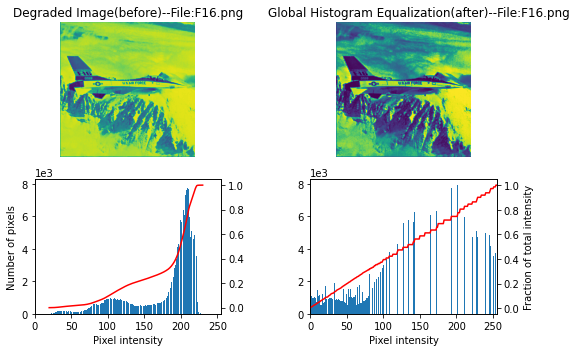

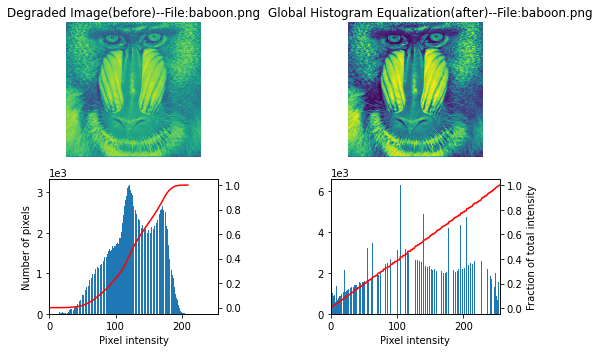

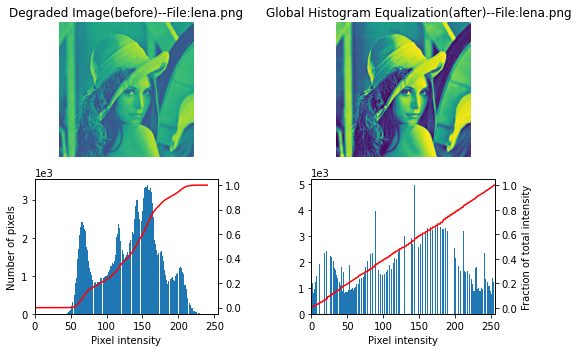

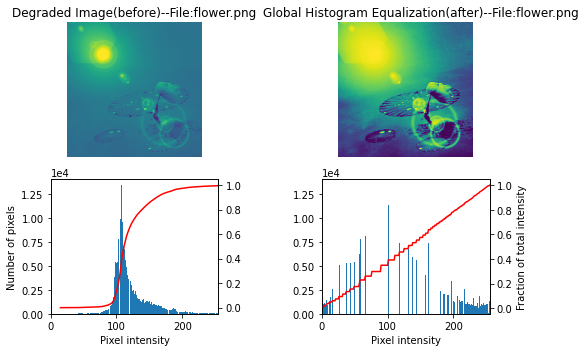

In [ ]:
# Trying 5 local window sizes.

#original
def plot_img_and_hist(image, axes, bins=256):
    """Plot an image along with its histogram and cumulative histogram.

    """
    ax_img, ax_hist = axes
    ax_cdf = ax_hist.twinx()

    # Display image
    ax_img.imshow(image)
    ax_img.set_axis_off()

    # Display histogram
    ax_hist.hist(image.ravel(), bins=bins)
    ax_hist.ticklabel_format(axis='y', style='scientific', scilimits=(0, 0))
    ax_hist.set_xlabel('Pixel intensity')

    xmin, xmax = dtype_range[image.dtype.type]
    ax_hist.set_xlim(xmin, xmax)

    # Display cumulative distribution
    img_cdf, bins = cumulative_distribution(image, bins)
    ax_cdf.plot(bins, img_cdf, 'r')

    return ax_img, ax_hist, ax_cdf

for name in ['F16.png', 'baboon.png', 'lena.png', 'flower.png']:

    matplotlib.rcParams['font.size'] = 10
        
    # Read image
    im = np.array(Image.open(name).convert('L'), dtype = 'uint8')

    # Global Histogram Equalization
    im2,cdf = histeq(im)

    # Specify the data type so that float value will be converted to int
    im2 = np.array(im2, dtype = 'uint8')
    
    # Display both images
    fig = plt.figure(figsize=(8, 5))
    axes = np.zeros((2, 2), dtype=object)
    axes[0, 0] = plt.subplot(2, 2, 1)
    axes[0, 1] = plt.subplot(2, 2, 2, sharex=axes[0, 0], sharey=axes[0, 0])
    axes[1, 0] = plt.subplot(2, 2, 3)
    axes[1, 1] = plt.subplot(2, 2, 4)

    ax_img, ax_hist, ax_cdf = plot_img_and_hist(im, axes[:, 0])
    ax_img.set_title('Degraded Image(before)'+'--File:'+str(name))
    ax_hist.set_ylabel('Number of pixels')

    ax_img, ax_hist, ax_cdf = plot_img_and_hist(im2, axes[:, 1])
    ax_img.set_title('        Global Histogram Equalization(after)'+'--File:'+str(name))
    ax_cdf.set_ylabel('Fraction of total intensity')
 
    # prevent overlap of y-axis labels
    fig.tight_layout()

    # Save edited images.
    cv2.imwrite('Local Histogram Equalization'+str(name)+'.jpg', im2)

###Local Histogram Equalization

In [ ]:
from skimage.filters import rank


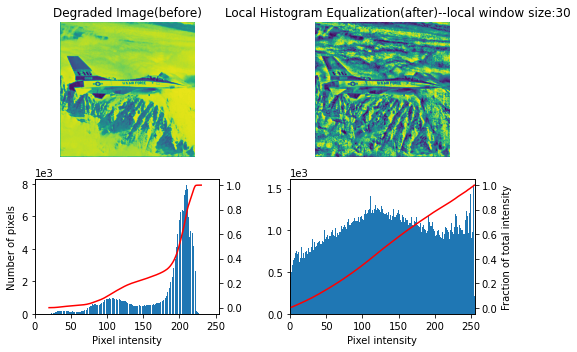

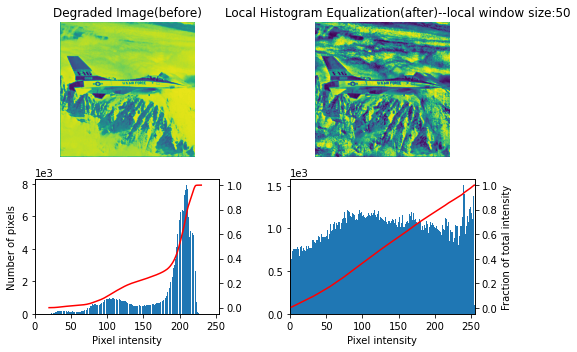

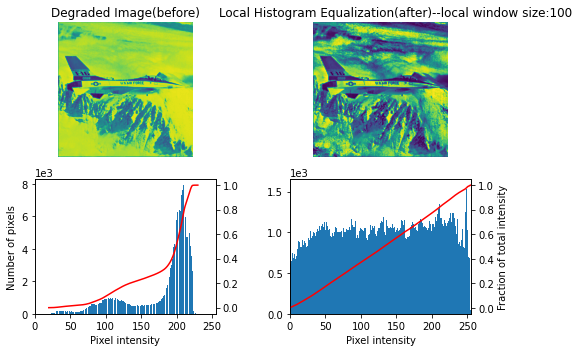

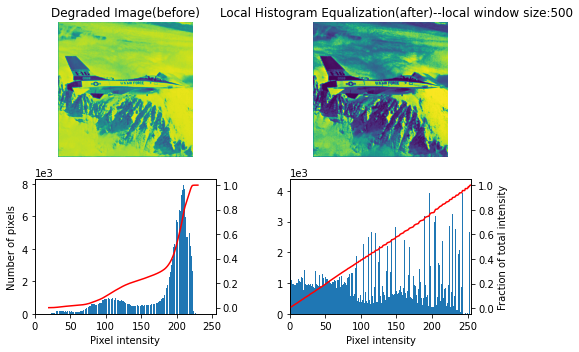

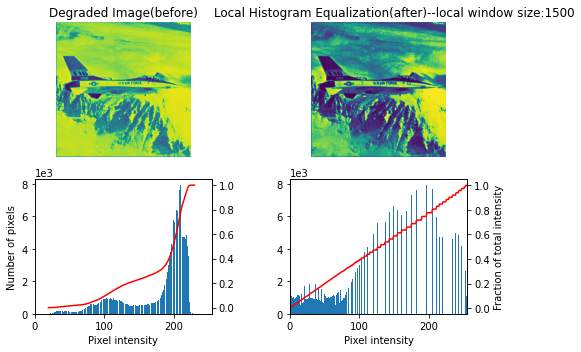

...

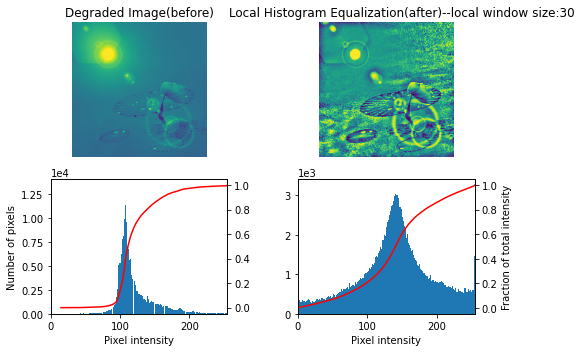

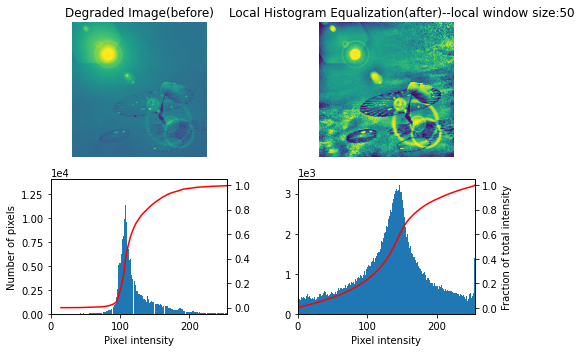

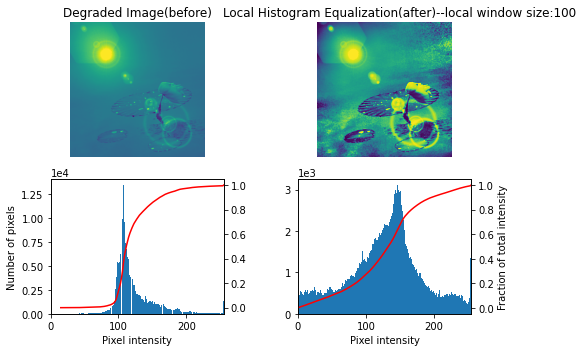

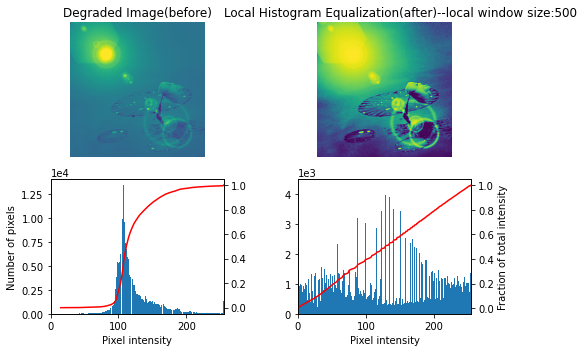

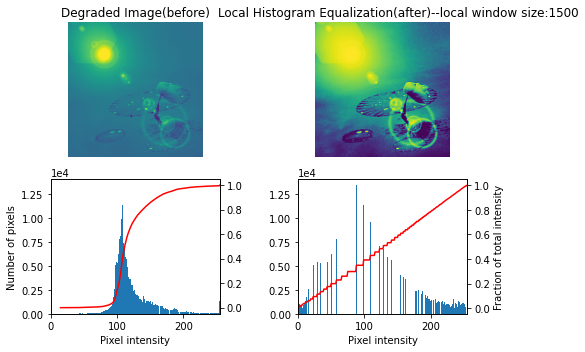

In [ ]:
# Trying 5 local window sizes.

#original
def plot_img_and_hist(image, axes, bins=256):
    """Plot an image along with its histogram and cumulative histogram.

    """
    ax_img, ax_hist = axes
    ax_cdf = ax_hist.twinx()

    # Display image
    ax_img.imshow(image)
    ax_img.set_axis_off()

    # Display histogram
    ax_hist.hist(image.ravel(), bins=bins)
    ax_hist.ticklabel_format(axis='y', style='scientific', scilimits=(0, 0))
    ax_hist.set_xlabel('Pixel intensity')

    xmin, xmax = dtype_range[image.dtype.type]
    ax_hist.set_xlim(xmin, xmax)

    # Display cumulative distribution
    img_cdf, bins = cumulative_distribution(image, bins)
    ax_cdf.plot(bins, img_cdf, 'r')

    return ax_img, ax_hist, ax_cdf
    
for name in ['F16.png', 'baboon.png', 'lena.png', 'flower.png']:
    
    matplotlib.rcParams['font.size'] = 10    
    # Read image
    im = np.array(Image.open(name).convert('L'), dtype = 'uint8')

    for size in [30, 50, 100, 500, 1500]:
        # Local Histogram Equalization
        footprint = disk(size)
        img_eq = rank.equalize(im, footprint)

        # Specify the data type so that float value will be converted to int
        img_eq_l = np.array(img_eq, dtype = 'uint8')
        
        # Display both images
        fig = plt.figure(figsize=(8, 5))
        axes = np.zeros((2, 2), dtype=object)
        axes[0, 0] = plt.subplot(2, 2, 1)
        axes[0, 1] = plt.subplot(2, 2, 2, sharex=axes[0, 0], sharey=axes[0, 0])
        axes[1, 0] = plt.subplot(2, 2, 3)
        axes[1, 1] = plt.subplot(2, 2, 4)

        ax_img, ax_hist, ax_cdf = plot_img_and_hist(im, axes[:, 0])
        ax_img.set_title('Degraded Image(before)')
        ax_hist.set_ylabel('Number of pixels')

        ax_img, ax_hist, ax_cdf = plot_img_and_hist(img_eq, axes[:, 1])
        ax_img.set_title('        Local Histogram Equalization(after)'+'--local window size:'+str(size))
        ax_cdf.set_ylabel('Fraction of total intensity')
    
        # prevent overlap of y-axis labels
        fig.tight_layout()

        # Save edited images.
        cv2.imwrite('Local Histogram Equalization'+str(size)+'.jpg', img_eq_l)

###Histogram Matching

In [ ]:
def _match_cumulative_cdf(source, template):
    """
    Return modified source array so that the cumulative density function of
    its values matches the cumulative density function of the template.
    """
    src_values, src_unique_indices, src_counts = np.unique(source.ravel(),
                                                           return_inverse=True,
                                                           return_counts=True)
    tmpl_values, tmpl_counts = np.unique(template.ravel(), return_counts=True)

    # calculate normalized quantiles for each array
    src_quantiles = np.cumsum(src_counts) / source.size
    tmpl_quantiles = np.cumsum(tmpl_counts) / template.size

    interp_a_values = np.interp(src_quantiles, tmpl_quantiles, tmpl_values)
    return interp_a_values[src_unique_indices].reshape(source.shape)

In [ ]:
def match_histograms(image, reference, *, channel_axis=None,
                     multichannel=False):
    """Adjust an image so that its cumulative histogram matches that of another.
    The adjustment is applied separately for each channel.
    Parameters
    ----------
    image : ndarray
        Input image. Can be gray-scale or in color.
    reference : ndarray
        Image to match histogram of. Must have the same number of channels as
        image.
    channel_axis : int or None, optional
        If None, the image is assumed to be a grayscale (single channel) image.
        Otherwise, this parameter indicates which axis of the array corresponds
        to channels.
    multichannel : bool, optional
        Apply the matching separately for each channel. This argument is
        deprecated: specify `channel_axis` instead.
    Returns
    -------
    matched : ndarray
        Transformed input image.
    Raises
    ------
    ValueError
        Thrown when the number of channels in the input image and the reference
        differ.
    References
    ----------
    .. [1] http://paulbourke.net/miscellaneous/equalisation/
    """
    if image.ndim != reference.ndim:
        raise ValueError('Image and reference must have the same number '
                         'of channels.')

    if channel_axis is not None:
        if image.shape[-1] != reference.shape[-1]:
            raise ValueError('Number of channels in the input image and '
                             'reference image must match!')

        matched = np.empty(image.shape, dtype=image.dtype)
        for channel in range(image.shape[-1]):
            matched_channel = _match_cumulative_cdf(image[..., channel],
                                                    reference[..., channel])
            matched[..., channel] = matched_channel
    else:
        # _match_cumulative_cdf will always return float64 due to np.interp
        matched = _match_cumulative_cdf(image, reference)

    if matched.dtype.kind == 'f':
        # output a float32 result when the input is float16 or float32
        out_dtype = _supported_float_type(image.dtype)
        matched = matched.astype(out_dtype, copy=False)
    return matched

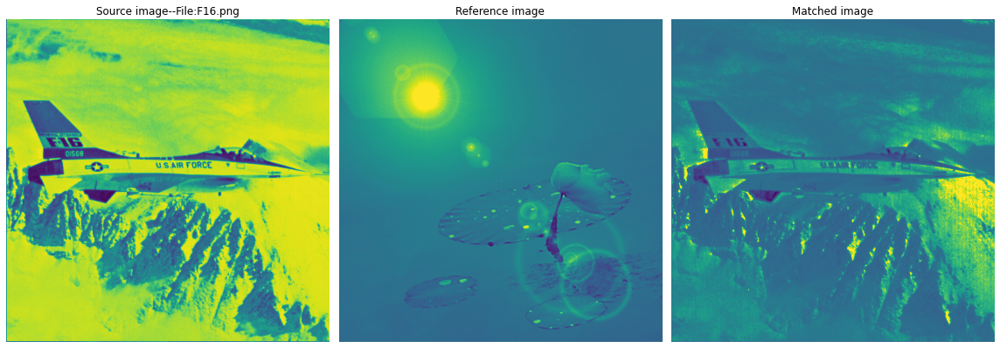

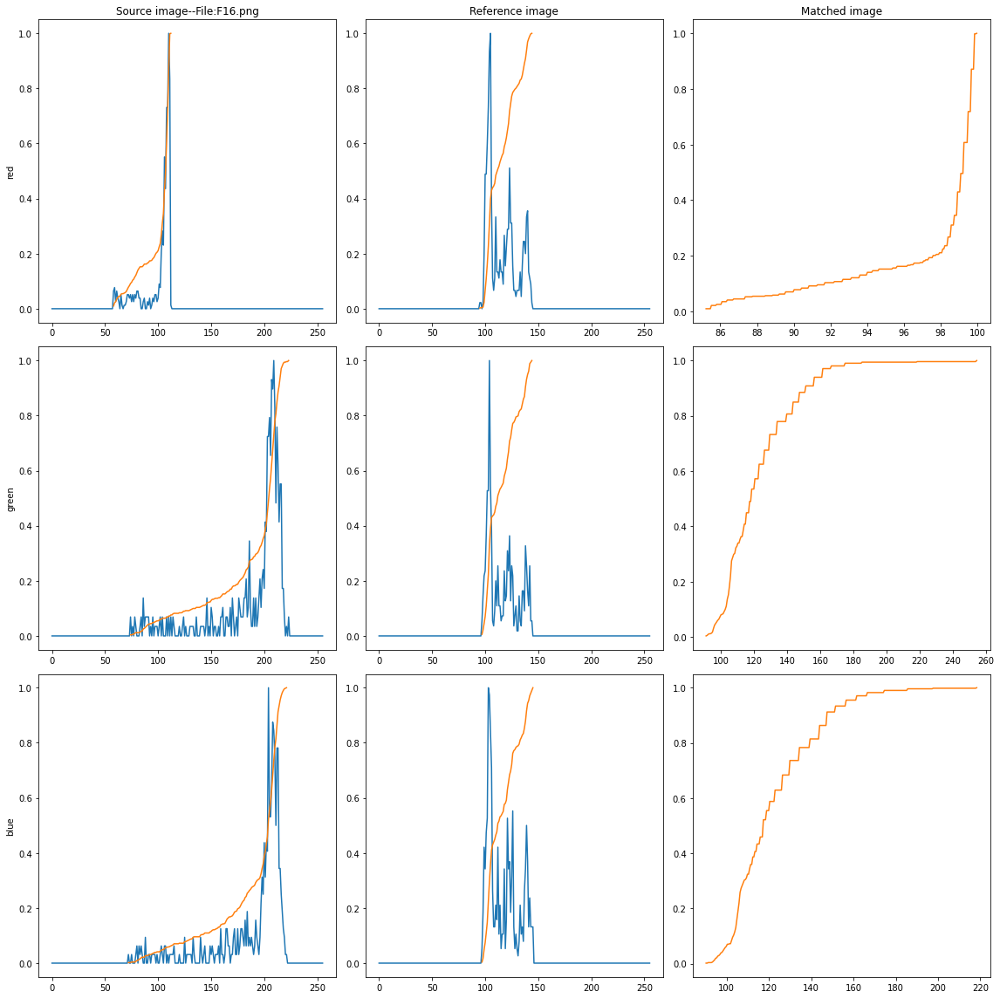

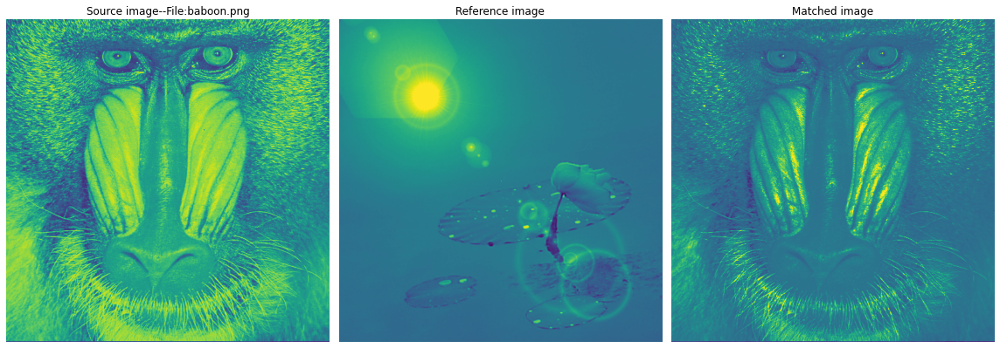

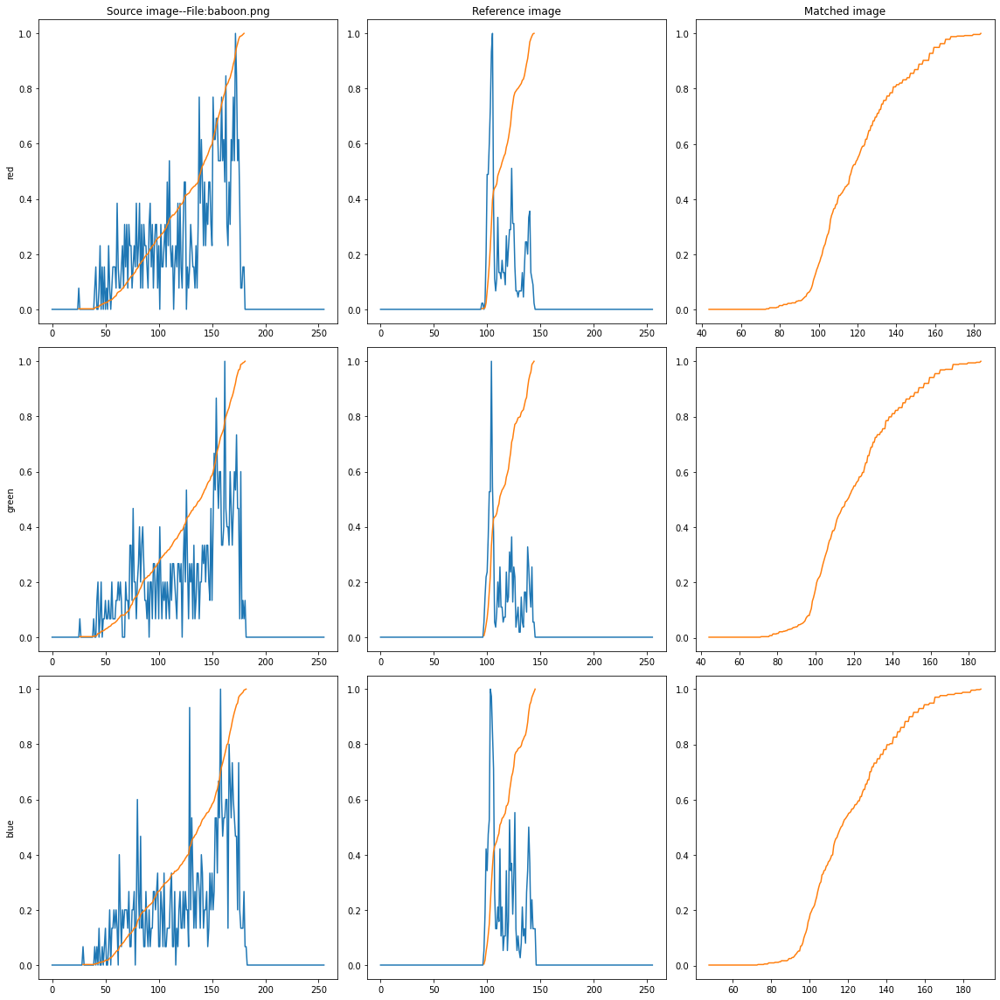

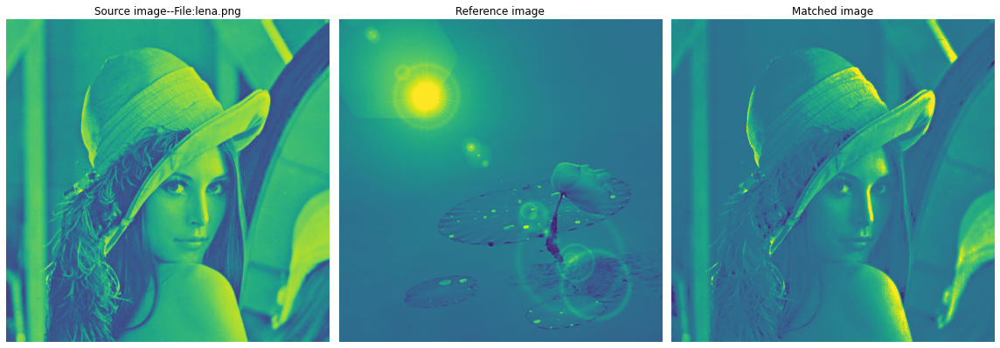

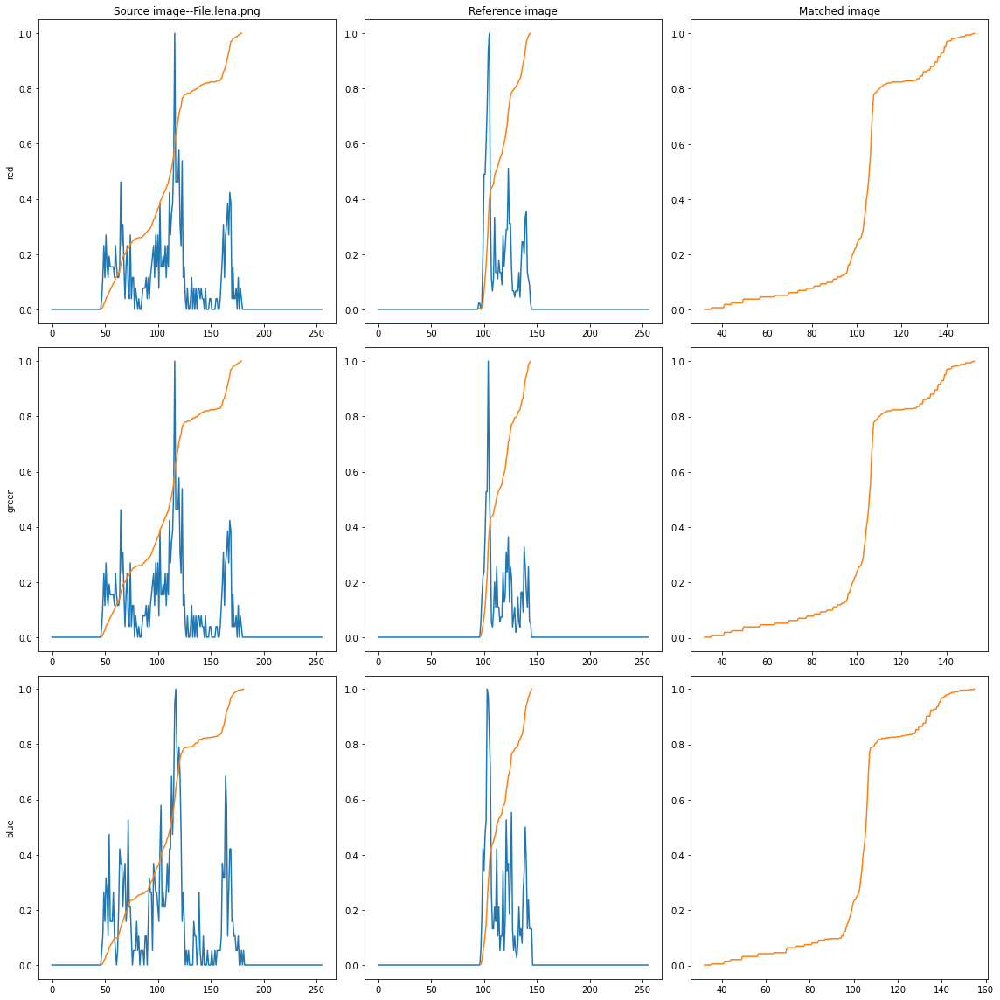

In [ ]:
np.seterr(divide='ignore',invalid='ignore')

# Read image
reference = np.array(Image.open('flower.png').convert('L'), dtype = 'uint8')

for name in ['F16.png', 'baboon.png', 'lena.png']:
    matplotlib.rcParams['font.size'] = 10    
    # Read image
    image = np.array(Image.open(name).convert('L'), dtype = 'uint8')
  
    # matching histograms
    matched = match_histograms(image, reference, multichannel=True)
      
    fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, 
                                        ncols=3, 
                                        figsize=(16, 10),
                                        sharex=True, 
                                        sharey=True)
    for aa in (ax1, ax2, ax3):
        aa.set_axis_off()
      
    # displaying images
    ax1.imshow(image)
    ax1.set_title('Source image'+'--File:'+str(name))
    ax2.imshow(reference)
    ax2.set_title('Reference image')
    ax3.imshow(matched)
    ax3.set_title('Matched image')
      
    plt.tight_layout()
    plt.show()

    # displaying histograms.
    fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(16, 16))
      
    for i, img in enumerate((image, reference, matched)):
        for c, c_color in enumerate(('red', 'green', 'blue')):
            img_hist, bins = histogram(img[..., c],source_range='dtype')
            axes[c, i].plot(bins, img_hist / img_hist.max())
            img_cdf, bins = cumulative_distribution(img[..., c])
            axes[c, i].plot(bins, img_cdf)
            axes[c, 0].set_ylabel(c_color)
      
    axes[0, 0].set_title('Source image'+'--File:'+str(name))
    axes[0, 1].set_title('Reference image')
    axes[0, 2].set_title('Matched image')
      
    plt.tight_layout()
    plt.show()

##2.Convolution

####Definition


In [ ]:
import numpy as np
import cv2
from scipy import signal
from scipy import misc
import math
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

In [ ]:
def _preprocess_resize_output_shape(image, output_shape):
    """Validate resize output shape according to input image.
    Parameters
    ----------
    image: ndarray
        Image to be resized.
    output_shape: iterable
        Size of the generated output image `(rows, cols[, ...][, dim])`. If
        `dim` is not provided, the number of channels is preserved.
    Returns
    -------
    image: ndarray
        The input image, but with additional singleton dimensions appended in
        the case where ``len(output_shape) > input.ndim``.
    output_shape: tuple
        The output image converted to tuple.
    Raises
    ------
    ValueError:
        If output_shape length is smaller than the image number of
        dimensions
    Notes
    -----
    The input image is reshaped if its number of dimensions is not
    equal to output_shape_length.
    """
    output_shape = tuple(output_shape)
    output_ndim = len(output_shape)
    input_shape = image.shape
    if output_ndim > image.ndim:
        # append dimensions to input_shape
        input_shape += (1, ) * (output_ndim - image.ndim)
        image = np.reshape(image, input_shape)
    elif output_ndim == image.ndim - 1:
        # multichannel case: append shape of last axis
        output_shape = output_shape + (image.shape[-1], )
    elif output_ndim < image.ndim:
        raise ValueError("output_shape length cannot be smaller than the "
                         "image number of dimensions")

    return image, 

In [ ]:
def resize(image, output_shape, order=None, mode='reflect', cval=0, clip=True,
           preserve_range=False, anti_aliasing=None, anti_aliasing_sigma=None, interpolation = cv2.INTER_AREA):
    """Resize image to match a certain size.
    Performs interpolation to up-size or down-size N-dimensional images. Note
    that anti-aliasing should be enabled when down-sizing images to avoid
    aliasing artifacts. For downsampling with an integer factor also see
    `skimage.transform.downscale_local_mean`.
    Parameters
    ----------
    image : ndarray
        Input image.
    output_shape : iterable
        Size of the generated output image `(rows, cols[, ...][, dim])`. If
        `dim` is not provided, the number of channels is preserved. In case the
        number of input channels does not equal the number of output channels a
        n-dimensional interpolation is applied.
    Returns
    -------
    resized : ndarray
        Resized version of the input.
    Other parameters
    ----------------
    order : int, optional
        The order of the spline interpolation, default is 0 if
        image.dtype is bool and 1 otherwise. The order has to be in
        the range 0-5. See `skimage.transform.warp` for detail.
    mode : {'constant', 'edge', 'symmetric', 'reflect', 'wrap'}, optional
        Points outside the boundaries of the input are filled according
        to the given mode.  Modes match the behaviour of `numpy.pad`.
    cval : float, optional
        Used in conjunction with mode 'constant', the value outside
        the image boundaries.
    clip : bool, optional
        Whether to clip the output to the range of values of the input image.
        This is enabled by default, since higher order interpolation may
        produce values outside the given input range.
    preserve_range : bool, optional
        Whether to keep the original range of values. Otherwise, the input
        image is converted according to the conventions of `img_as_float`.
        Also see https://scikit-image.org/docs/dev/user_guide/data_types.html
    anti_aliasing : bool, optional
        Whether to apply a Gaussian filter to smooth the image prior
        to downsampling. It is crucial to filter when downsampling
        the image to avoid aliasing artifacts. If not specified, it is set to
        True when downsampling an image whose data type is not bool.
    anti_aliasing_sigma : {float, tuple of floats}, optional
        Standard deviation for Gaussian filtering used when anti-aliasing.
        By default, this value is chosen as (s - 1) / 2 where s is the
        downsampling factor, where s > 1. For the up-size case, s < 1, no
        anti-aliasing is performed prior to rescaling.
    Notes
    -----
    Modes 'reflect' and 'symmetric' are similar, but differ in whether the edge
    pixels are duplicated during the reflection.  As an example, if an array
    has values [0, 1, 2] and was padded to the right by four values using
    symmetric, the result would be [0, 1, 2, 2, 1, 0, 0], while for reflect it
    would be [0, 1, 2, 1, 0, 1, 2].
    Examples
    --------
    >>> from skimage import data
    >>> from skimage.transform import resize
    >>> image = data.camera()
    >>> resize(image, (100, 100)).shape
    (100, 100)
    """

    image, output_shape = _preprocess_resize_output_shape(image, output_shape)
    input_shape = image.shape
    input_type = image.dtype

    if input_type == np.float16:
        image = image.astype(np.float32)

    if anti_aliasing is None:
        anti_aliasing = (not input_type == bool and
                         any(x < y for x, y in zip(output_shape, input_shape)))

    if input_type == bool and anti_aliasing:
        raise ValueError("anti_aliasing must be False for boolean images")

    factors = np.divide(input_shape, output_shape)
    order = _validate_interpolation_order(input_type, order)
    if order > 0:
        image = convert_to_float(image, preserve_range)

    # Save input value range for clip
    img_bounds = np.array([image.min(), image.max()]) if clip else None

    # Translate modes used by np.pad to those used by scipy.ndimage
    ndi_mode = _to_ndimage_mode(mode)
    if anti_aliasing:
        if anti_aliasing_sigma is None:
            anti_aliasing_sigma = np.maximum(0, (factors - 1) / 2)
        else:
            anti_aliasing_sigma = \
                np.atleast_1d(anti_aliasing_sigma) * np.ones_like(factors)
            if np.any(anti_aliasing_sigma < 0):
                raise ValueError("Anti-aliasing standard deviation must be "
                                 "greater than or equal to zero")
            elif np.any((anti_aliasing_sigma > 0) & (factors <= 1)):
                warn("Anti-aliasing standard deviation greater than zero but "
                     "not down-sampling along all axes")
        image = ndi.gaussian_filter(image, anti_aliasing_sigma,
                                    cval=cval, mode=ndi_mode)

    if NumpyVersion(scipy.__version__) >= '1.6.0':
        # The grid_mode kwarg was introduced in SciPy 1.6.0
        zoom_factors = [1 / f for f in factors]
        out = ndi.zoom(image, zoom_factors, order=order, mode=ndi_mode,
                       cval=cval, grid_mode=True)

    # TODO: Remove the fallback code below once SciPy >= 1.6.0 is required.

    # 2-dimensional interpolation
    elif len(output_shape) == 2 or (len(output_shape) == 3 and
                                    output_shape[2] == input_shape[2]):
        rows = output_shape[0]
        cols = output_shape[1]
        input_rows = input_shape[0]
        input_cols = input_shape[1]
        if rows == 1 and cols == 1:
            tform = AffineTransform(translation=(input_cols / 2.0 - 0.5,
                                                 input_rows / 2.0 - 0.5))
        else:
            # 3 control points necessary to estimate exact AffineTransform
            src_corners = np.array([[1, 1], [1, rows], [cols, rows]]) - 1
            dst_corners = np.zeros(src_corners.shape, dtype=np.double)
            # take into account that 0th pixel is at position (0.5, 0.5)
            dst_corners[:, 0] = factors[1] * (src_corners[:, 0] + 0.5) - 0.5
            dst_corners[:, 1] = factors[0] * (src_corners[:, 1] + 0.5) - 0.5

            tform = AffineTransform()
            tform.estimate(src_corners, dst_corners)

        # Make sure the transform is exactly metric, to ensure fast warping.
        tform.params[2] = (0, 0, 1)
        tform.params[0, 1] = 0
        tform.params[1, 0] = 0

        # clip outside of warp to clip w.r.t input values, not filtered values.
        out = warp(image, tform, output_shape=output_shape, order=order,
                   mode=mode, cval=cval, clip=False,
                   preserve_range=preserve_range)

    else:  # n-dimensional interpolation

        coord_arrays = [factors[i] * (np.arange(d) + 0.5) - 0.5
                        for i, d in enumerate(output_shape)]

        coord_map = np.array(np.meshgrid(*coord_arrays,
                                         sparse=False,
                                         indexing='ij'))

        out = ndi.map_coordinates(image, coord_map, order=order,
                                  mode=ndi_mode, cval=cval)

    _clip_warp_output(img_bounds, out, mode, cval, clip)

    return out

In [ ]:
def dnorm(x, mu, sd):
    return 1 / (np.sqrt(2 * np.pi) * sd) * np.e ** (-np.power((x - mu) / sd, 2) / 2)


def gaussian_kernel(size, sigma=1, verbose=False):
    kernel_1D = np.linspace(-(size // 2), size // 2, size)
    for i in range(size):
        kernel_1D[i] = dnorm(kernel_1D[i], 0, sigma)
    kernel_2D = np.outer(kernel_1D.T, kernel_1D.T)

    kernel_2D *= 1.0 / kernel_2D.max()

    if verbose:
        plt.imshow(kernel_2D, interpolation='none', cmap='gray')
        plt.title("Kernel ( {}X{} )".format(size, size))
        plt.show()

    return kernel_2D

def convolution(image, kernel, average=False, verbose=False):
    if len(image.shape) == 3:
        print("Found 3 Channels : {}".format(image.shape))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        print("Converted to Gray Channel. Size : {}".format(image.shape))
    else:
        print("Image Shape : {}".format(image.shape))

    print("Kernel Shape : {}".format(kernel.shape))

    if verbose:
        plt.imshow(image, cmap='gray')
        plt.title("Image")
        plt.show()

    image_row, image_col = image.shape
    kernel_row, kernel_col = kernel.shape

    output = np.zeros(image.shape)

    pad_height = int((kernel_row - 1) / 2)
    pad_width = int((kernel_col - 1) / 2)

    padded_image = np.zeros((image_row + (2 * pad_height), image_col + (2 * pad_width)))

    padded_image[pad_height:padded_image.shape[0] - pad_height, pad_width:padded_image.shape[1] - pad_width] = image

    if verbose:
        plt.imshow(padded_image, cmap='gray')
        plt.title("Padded Image")
        plt.show()

    for row in range(image_row):
        for col in range(image_col):
            output[row, col] = np.sum(kernel * padded_image[row:row + kernel_row, col:col + kernel_col])
            if average:
                output[row, col] /= kernel.shape[0] * kernel.shape[1]

    print("Output Image size : {}".format(output.shape))

    if verbose:
        plt.imshow(output, cmap='gray')
        plt.title("Output Image using {}X{} Kernel".format(kernel_row, kernel_col))
        plt.show()

    return output

def gaussian_blur(image, kernel_size, verbose=False):
    kernel = gaussian_kernel(kernel_size, sigma=math.sqrt(kernel_size), verbose=verbose)
    return convolution(image, kernel, average=True, verbose=verbose)

####Gassian Filter 

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import math
 
 
def dnorm(x, mu, sd):
    return 1 / (np.sqrt(2 * np.pi) * sd) * np.e ** (-np.power((x - mu) / sd, 2) / 2)
 
#n*n Gassian filter 
def gaussian_kernel(size, sigma=1, verbose=False):
    kernel_1D = np.linspace(-(size // 2), size // 2, size)
    for i in range(size):
        kernel_1D[i] = dnorm(kernel_1D[i], 0, sigma)
    kernel_2D = np.outer(kernel_1D.T, kernel_1D.T)
 
    kernel_2D *= 1.0 / kernel_2D.max()
 
    if verbose:
        plt.imshow(kernel_2D, interpolation='none', cmap='gray')
        plt.title("Kernel ( {}X{} )".format(size, size))
        plt.show()
 
    return kernel_2D
 
 
def gaussian_blur(image, kernel_size, verbose=False):
    kernel = gaussian_kernel(kernel_size, sigma=math.sqrt(kernel_size), verbose=verbose)
    return convolution(image, kernel, average=True, verbose=verbose)

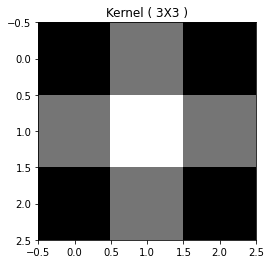

Image Shape : (512, 512)
Kernel Shape : (3, 3)


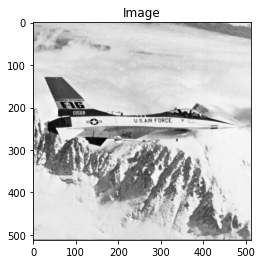

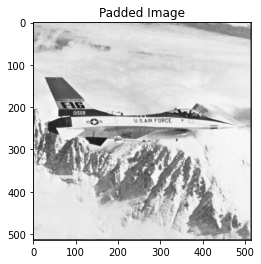

Output Image size : (512, 512)


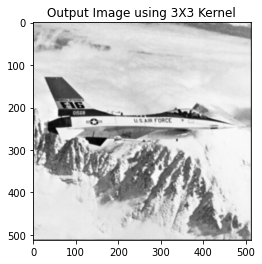

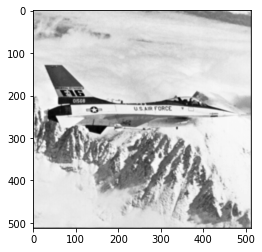

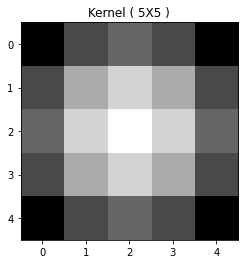

Image Shape : (512, 512)
Kernel Shape : (5, 5)


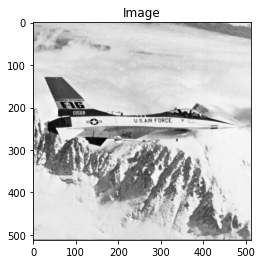

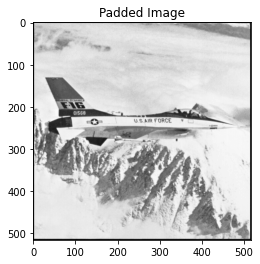

Output Image size : (512, 512)


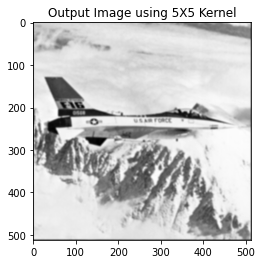

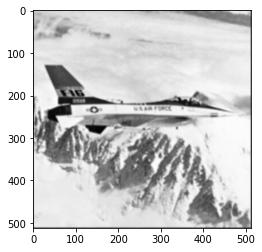

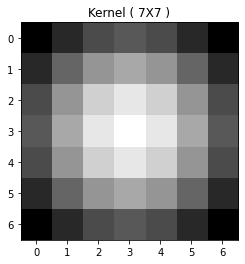

Image Shape : (512, 512)
Kernel Shape : (7, 7)


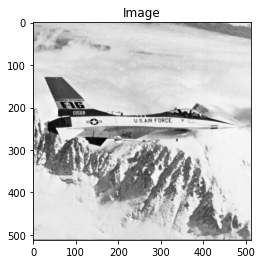

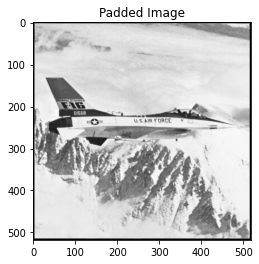

Output Image size : (512, 512)


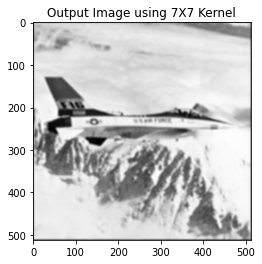

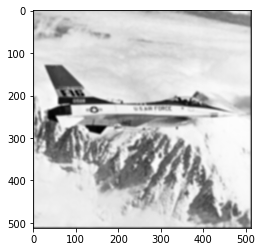

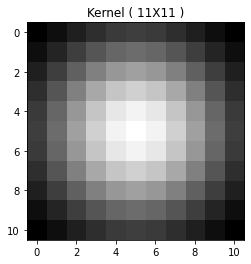

Image Shape : (512, 512)
Kernel Shape : (11, 11)


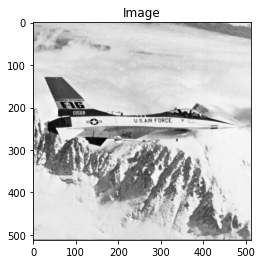

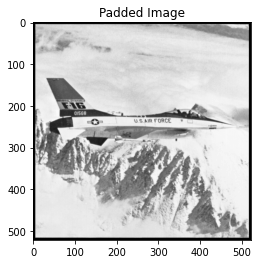

Output Image size : (512, 512)


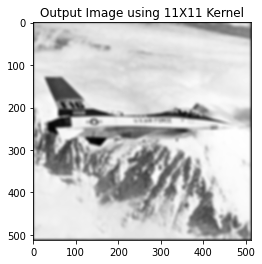

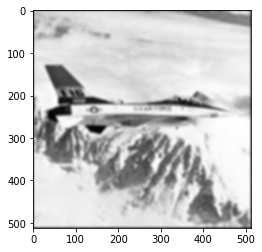

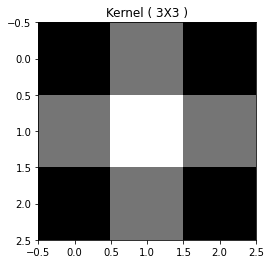

Image Shape : (512, 512)
Kernel Shape : (3, 3)


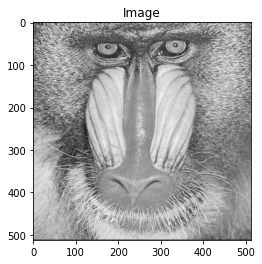

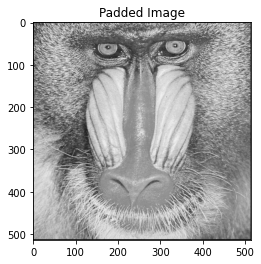

Output Image size : (512, 512)


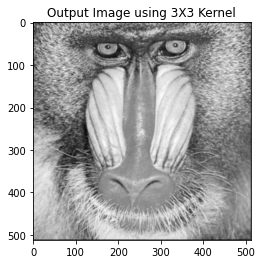

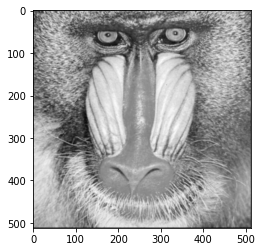

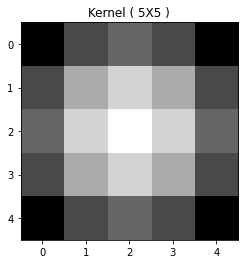

Image Shape : (512, 512)
Kernel Shape : (5, 5)


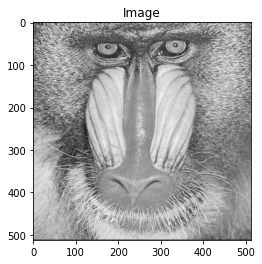

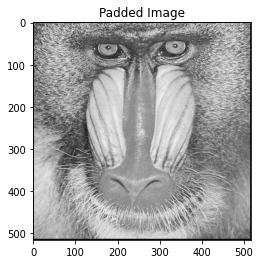

Output Image size : (512, 512)


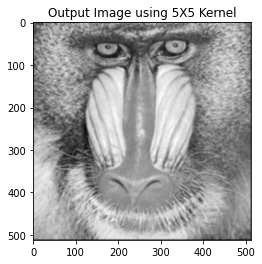

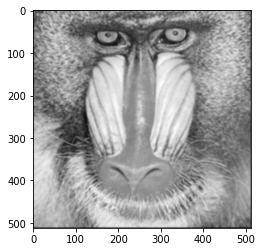

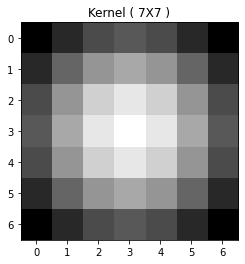

Image Shape : (512, 512)
Kernel Shape : (7, 7)


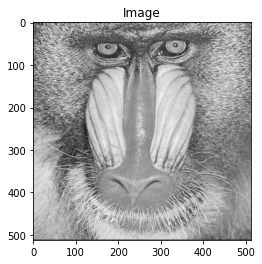

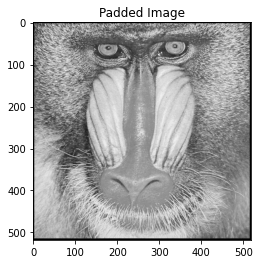

Output Image size : (512, 512)


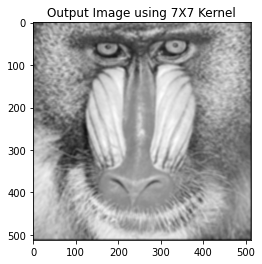

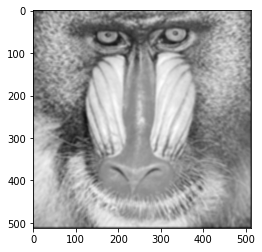

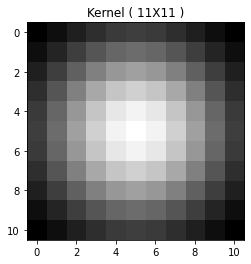

Image Shape : (512, 512)
Kernel Shape : (11, 11)


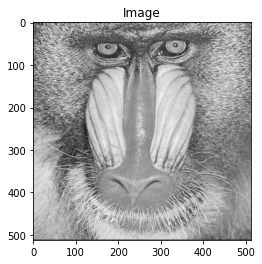

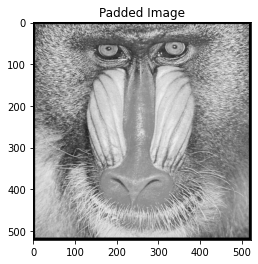

Output Image size : (512, 512)


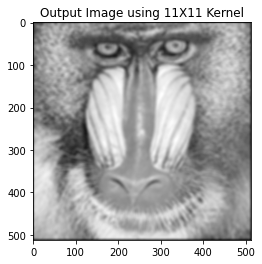

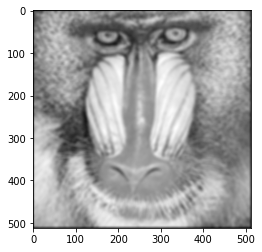

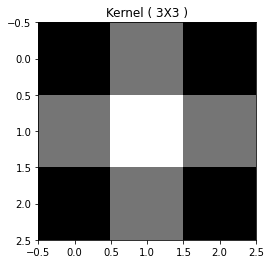

Image Shape : (512, 512)
Kernel Shape : (3, 3)


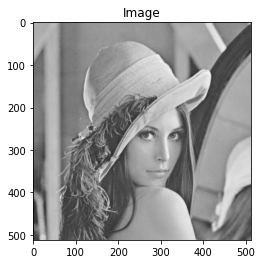

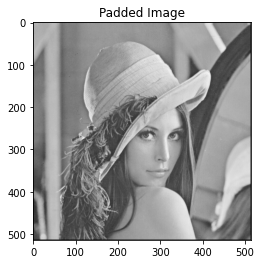

Output Image size : (512, 512)


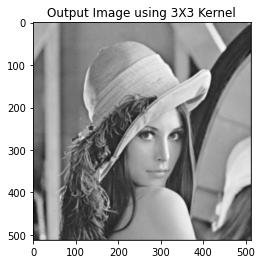

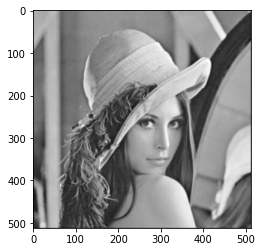

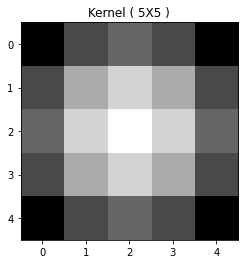

Image Shape : (512, 512)
Kernel Shape : (5, 5)


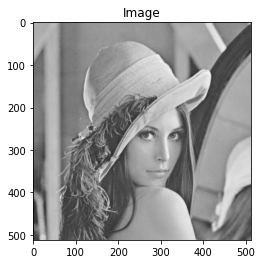

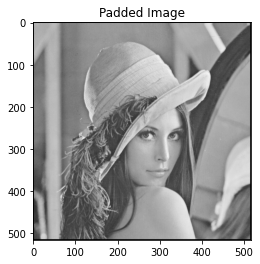

Output Image size : (512, 512)


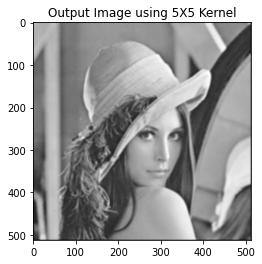

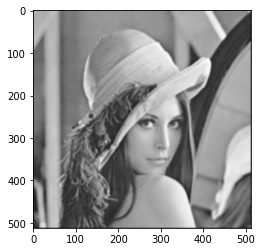

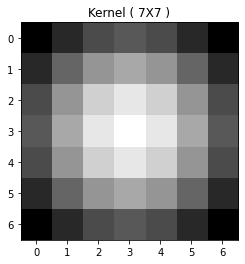

Image Shape : (512, 512)
Kernel Shape : (7, 7)


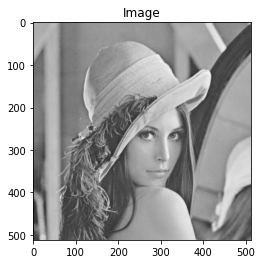

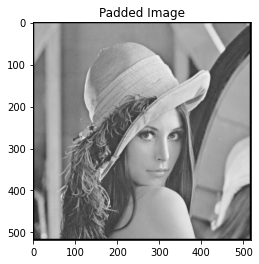

Output Image size : (512, 512)


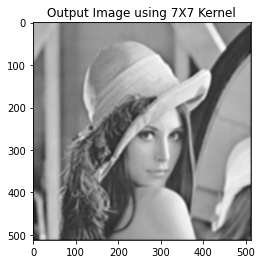

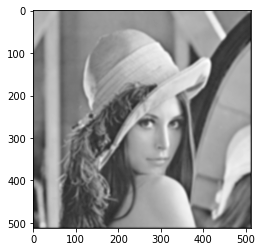

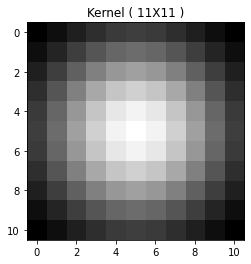

Image Shape : (512, 512)
Kernel Shape : (11, 11)


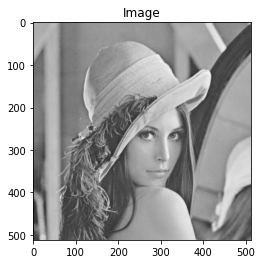

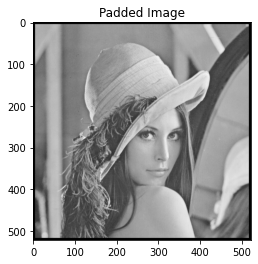

Output Image size : (512, 512)


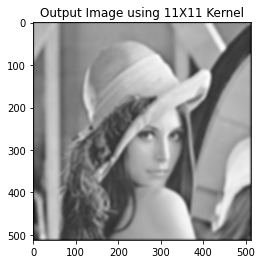

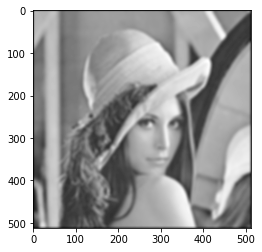

In [ ]:
for name in ['F16.png', 'baboon.png', 'lena.png']:
   
        matplotlib.rcParams['font.size'] = 10
                
        # Read image
        im = np.array(Image.open(name).convert('L'), dtype = 'uint8')

        for i in [3, 5, 7, 11]:


            #Gassian filter blur
            blur= gaussian_blur(im, i, verbose=True)

            pyplot.imshow(blur)
            pyplot.show()            

####Averaging Filter

In [ ]:
import numpy

In [ ]:
def AvgFilter(im):
    img = im
    w = 2

    for i in range(2,im.shape[0]-2):
        for j in range(2,im.shape[1]-2):
            block = im[i-w:i+w+1, j-w:j+w+1]
            m = numpy.mean(block,dtype=numpy.float32)
            img[i][j] = int(m)
    return img

---------------File:F16.png-------------


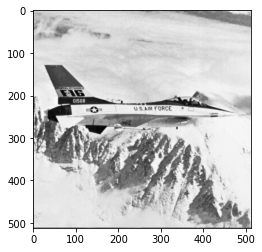

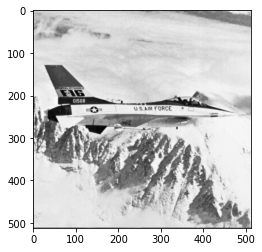

-------------Averaging Filter--Kernel Size:3-------------


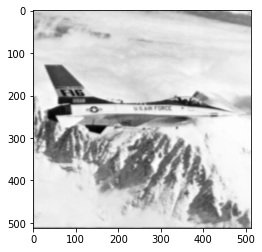

-------------Averaging Filter--Kernel Size:5-------------


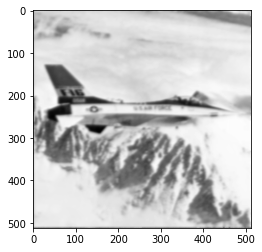

-------------Averaging Filter--Kernel Size:7-------------


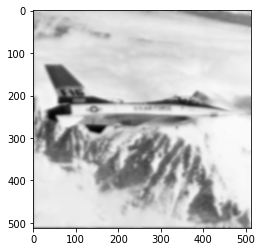

-------------Averaging Filter--Kernel Size:11-------------


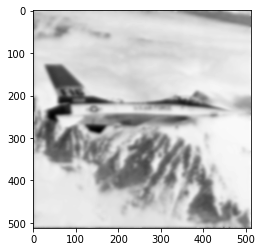

---------------File:baboon.png-------------


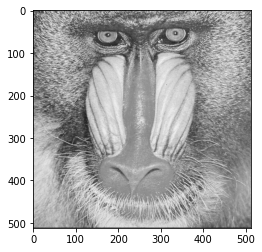

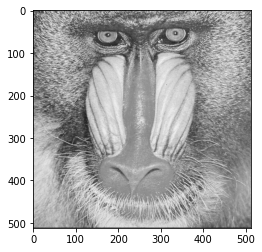

-------------Averaging Filter--Kernel Size:3-------------


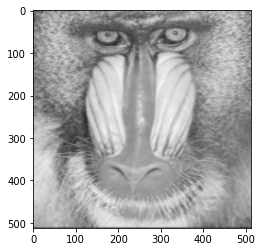

-------------Averaging Filter--Kernel Size:5-------------


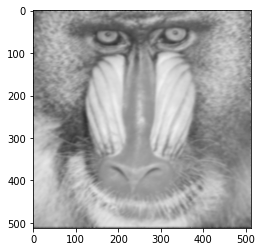

-------------Averaging Filter--Kernel Size:7-------------


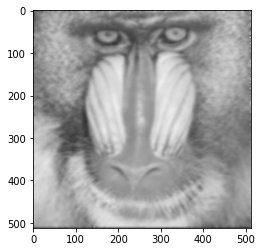

-------------Averaging Filter--Kernel Size:11-------------


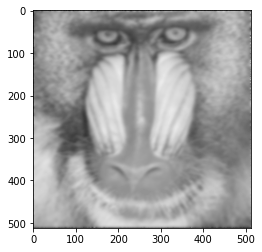

---------------File:lena.png-------------


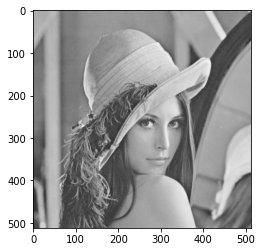

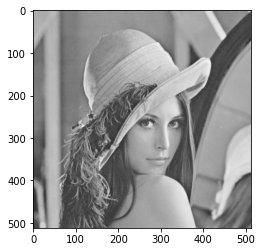

-------------Averaging Filter--Kernel Size:3-------------


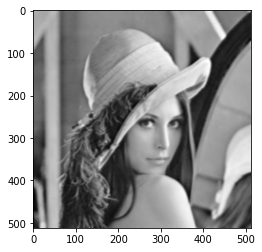

-------------Averaging Filter--Kernel Size:5-------------


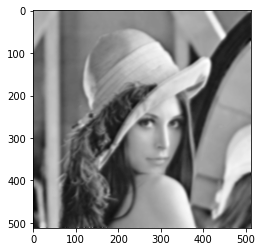

-------------Averaging Filter--Kernel Size:7-------------


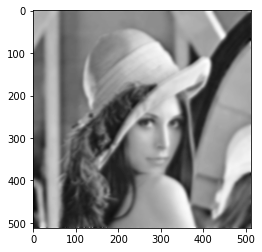

-------------Averaging Filter--Kernel Size:11-------------


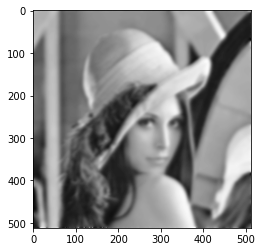

In [ ]:
for name in ['F16.png', 'baboon.png', 'lena.png']:
   
        matplotlib.rcParams['font.size'] = 10
                
        # Read image
        im = np.array(Image.open(name).convert('L'), dtype = 'uint8')

        print('---------------File:'+str(name)+'-------------')   
        pyplot.imshow(im)
        pyplot.show() 
        pyplot.imshow(im, cmap=plt.cm.gray)
        pyplot.show() 
        
        for i in [3, 5, 7, 11]:


            #Gassian filter blur
            avg= AvgFilter(im)

            cv2.imwrite('avg_blurred_'+str(name)+'.png', avg)

            
            print('-------------'+'Averaging Filter'+'--Kernel Size:'+str(i)+'-------------')
            pyplot.imshow(avg, cmap=plt.cm.gray)
            pyplot.show()

####Unsharp Mask Filter

In [ ]:
import numpy as np
from warnings import warn


__all__ = ['img_as_float32', 'img_as_float64', 'img_as_float',
           'img_as_int', 'img_as_uint', 'img_as_ubyte',
           'img_as_bool', 'dtype_limits']

# For integers Numpy uses `_integer_types` basis internally, and builds a leaky
# `np.XintYY` abstraction on top of it. This leads to situations when, for
# example, there are two np.Xint64 dtypes with the same attributes but
# different object references. In order to avoid any potential issues,
# we use the basis dtypes here. For more information, see:
# - https://github.com/scikit-image/scikit-image/issues/3043
# For convenience, for these dtypes we indicate also the possible bit depths
# (some of them are platform specific). For the details, see:
# http://www.unix.org/whitepapers/64bit.html
_integer_types = (np.byte, np.ubyte,          # 8 bits
                  np.short, np.ushort,        # 16 bits
                  np.intc, np.uintc,          # 16 or 32 or 64 bits
                  int, np.int_, np.uint,      # 32 or 64 bits
                  np.longlong, np.ulonglong)  # 64 bits
_integer_ranges = {t: (np.iinfo(t).min, np.iinfo(t).max)
                   for t in _integer_types}
dtype_range = {bool: (False, True),
               np.bool_: (False, True),
               np.bool8: (False, True),
               float: (-1, 1),
               np.float_: (-1, 1),
               np.float16: (-1, 1),
               np.float32: (-1, 1),
               np.float64: (-1, 1)}
dtype_range.update(_integer_ranges)

_supported_types = list(dtype_range.keys())


def dtype_limits(image, clip_negative=False):
    """Return intensity limits, i.e. (min, max) tuple, of the image's dtype.

    Parameters
    ----------
    image : ndarray
        Input image.
    clip_negative : bool, optional
        If True, clip the negative range (i.e. return 0 for min intensity)
        even if the image dtype allows negative values.

    Returns
    -------
    imin, imax : tuple
        Lower and upper intensity limits.
    """
    imin, imax = dtype_range[image.dtype.type]
    if clip_negative:
        imin = 0
    return imin, imax


def _dtype_itemsize(itemsize, *dtypes):
    """Return first of `dtypes` with itemsize greater than `itemsize`

    Parameters
    ----------
    itemsize: int
        The data type object element size.

    Other Parameters
    ----------------
    *dtypes:
        Any Object accepted by `np.dtype` to be converted to a data
        type object

    Returns
    -------
    dtype: data type object
        First of `dtypes` with itemsize greater than `itemsize`.

    """
    return next(dt for dt in dtypes if np.dtype(dt).itemsize >= itemsize)


def _dtype_bits(kind, bits, itemsize=1):
    """Return dtype of `kind` that can store a `bits` wide unsigned int

    Parameters:
    kind: str
        Data type kind.
    bits: int
        Desired number of bits.
    itemsize: int
        The data type object element size.

    Returns
    -------
    dtype: data type object
        Data type of `kind` that can store a `bits` wide unsigned int

    """

    s = next(i for i in (itemsize, ) + (2, 4, 8) if
             bits < (i * 8) or (bits == (i * 8) and kind == 'u'))

    return np.dtype(kind + str(s))


def _scale(a, n, m, copy=True):
    """Scale an array of unsigned/positive integers from `n` to `m` bits.

    Numbers can be represented exactly only if `m` is a multiple of `n`.

    Parameters
    ----------
    a : ndarray
        Input image array.
    n : int
        Number of bits currently used to encode the values in `a`.
    m : int
        Desired number of bits to encode the values in `out`.
    copy : bool, optional
        If True, allocates and returns new array. Otherwise, modifies
        `a` in place.

    Returns
    -------
    out : array
        Output image array. Has the same kind as `a`.
    """
    kind = a.dtype.kind
    if n > m and a.max() < 2 ** m:
        mnew = int(np.ceil(m / 2) * 2)
        if mnew > m:
            dtype = f'int{mnew}'
        else:
            dtype = f'uint{mnew}'
        n = int(np.ceil(n / 2) * 2)
        warn(f'Downcasting {a.dtype} to {dtype} without scaling because max '
             f'value {a.max()} fits in {dtype}',
             stacklevel=3)
        return a.astype(_dtype_bits(kind, m))
    elif n == m:
        return a.copy() if copy else a
    elif n > m:
        # downscale with precision loss
        if copy:
            b = np.empty(a.shape, _dtype_bits(kind, m))
            np.floor_divide(a, 2**(n - m), out=b, dtype=a.dtype,
                            casting='unsafe')
            return b
        else:
            a //= 2**(n - m)
            return a
    elif m % n == 0:
        # exact upscale to a multiple of `n` bits
        if copy:
            b = np.empty(a.shape, _dtype_bits(kind, m))
            np.multiply(a, (2**m - 1) // (2**n - 1), out=b, dtype=b.dtype)
            return b
        else:
            a = a.astype(_dtype_bits(kind, m, a.dtype.itemsize), copy=False)
            a *= (2**m - 1) // (2**n - 1)
            return a
    else:
        # upscale to a multiple of `n` bits,
        # then downscale with precision loss
        o = (m // n + 1) * n
        if copy:
            b = np.empty(a.shape, _dtype_bits(kind, o))
            np.multiply(a, (2**o - 1) // (2**n - 1), out=b, dtype=b.dtype)
            b //= 2**(o - m)
            return b
        else:
            a = a.astype(_dtype_bits(kind, o, a.dtype.itemsize), copy=False)
            a *= (2**o - 1) // (2**n - 1)
            a //= 2**(o - m)
            return a


def _convert(image, dtype, force_copy=False, uniform=False):
    """
    Convert an image to the requested data-type.

    Warnings are issued in case of precision loss, or when negative values
    are clipped during conversion to unsigned integer types (sign loss).

    Floating point values are expected to be normalized and will be clipped
    to the range [0.0, 1.0] or [-1.0, 1.0] when converting to unsigned or
    signed integers respectively.

    Numbers are not shifted to the negative side when converting from
    unsigned to signed integer types. Negative values will be clipped when
    converting to unsigned integers.

    Parameters
    ----------
    image : ndarray
        Input image.
    dtype : dtype
        Target data-type.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.
    uniform : bool, optional
        Uniformly quantize the floating point range to the integer range.
        By default (uniform=False) floating point values are scaled and
        rounded to the nearest integers, which minimizes back and forth
        conversion errors.

    .. versionchanged:: 0.15
        ``_convert`` no longer warns about possible precision or sign
        information loss. See discussions on these warnings at:
        https://github.com/scikit-image/scikit-image/issues/2602
        https://github.com/scikit-image/scikit-image/issues/543#issuecomment-208202228
        https://github.com/scikit-image/scikit-image/pull/3575

    References
    ----------
    .. [1] DirectX data conversion rules.
           https://msdn.microsoft.com/en-us/library/windows/desktop/dd607323%28v=vs.85%29.aspx
    .. [2] Data Conversions. In "OpenGL ES 2.0 Specification v2.0.25",
           pp 7-8. Khronos Group, 2010.
    .. [3] Proper treatment of pixels as integers. A.W. Paeth.
           In "Graphics Gems I", pp 249-256. Morgan Kaufmann, 1990.
    .. [4] Dirty Pixels. J. Blinn. In "Jim Blinn's corner: Dirty Pixels",
           pp 47-57. Morgan Kaufmann, 1998.

    """
    image = np.asarray(image)
    dtypeobj_in = image.dtype
    if dtype is np.floating:
        dtypeobj_out = np.dtype('float64')
    else:
        dtypeobj_out = np.dtype(dtype)
    dtype_in = dtypeobj_in.type
    dtype_out = dtypeobj_out.type
    kind_in = dtypeobj_in.kind
    kind_out = dtypeobj_out.kind
    itemsize_in = dtypeobj_in.itemsize
    itemsize_out = dtypeobj_out.itemsize

    # Below, we do an `issubdtype` check.  Its purpose is to find out
    # whether we can get away without doing any image conversion.  This happens
    # when:
    #
    # - the output and input dtypes are the same or
    # - when the output is specified as a type, and the input dtype
    #   is a subclass of that type (e.g. `np.floating` will allow
    #   `float32` and `float64` arrays through)

    if np.issubdtype(dtype_in, np.obj2sctype(dtype)):
        if force_copy:
            image = image.copy()
        return image

    if not (dtype_in in _supported_types and dtype_out in _supported_types):
        raise ValueError(f'Cannot convert from {dtypeobj_in} to '
                         f'{dtypeobj_out}.')

    if kind_in in 'ui':
        imin_in = np.iinfo(dtype_in).min
        imax_in = np.iinfo(dtype_in).max
    if kind_out in 'ui':
        imin_out = np.iinfo(dtype_out).min
        imax_out = np.iinfo(dtype_out).max

    # any -> binary
    if kind_out == 'b':
        return image > dtype_in(dtype_range[dtype_in][1] / 2)

    # binary -> any
    if kind_in == 'b':
        result = image.astype(dtype_out)
        if kind_out != 'f':
            result *= dtype_out(dtype_range[dtype_out][1])
        return result

    # float -> any
    if kind_in == 'f':
        if kind_out == 'f':
            # float -> float
            return image.astype(dtype_out)

        if np.min(image) < -1.0 or np.max(image) > 1.0:
            raise ValueError("Images of type float must be between -1 and 1.")
        # floating point -> integer
        # use float type that can represent output integer type
        computation_type = _dtype_itemsize(itemsize_out, dtype_in,
                                           np.float32, np.float64)

        if not uniform:
            if kind_out == 'u':
                image_out = np.multiply(image, imax_out,
                                        dtype=computation_type)
            else:
                image_out = np.multiply(image, (imax_out - imin_out) / 2,
                                        dtype=computation_type)
                image_out -= 1.0 / 2.
            np.rint(image_out, out=image_out)
            np.clip(image_out, imin_out, imax_out, out=image_out)
        elif kind_out == 'u':
            image_out = np.multiply(image, imax_out + 1,
                                    dtype=computation_type)
            np.clip(image_out, 0, imax_out, out=image_out)
        else:
            image_out = np.multiply(image, (imax_out - imin_out + 1.0) / 2.0,
                                    dtype=computation_type)
            np.floor(image_out, out=image_out)
            np.clip(image_out, imin_out, imax_out, out=image_out)
        return image_out.astype(dtype_out)

    # signed/unsigned int -> float
    if kind_out == 'f':
        # use float type that can exactly represent input integers
        computation_type = _dtype_itemsize(itemsize_in, dtype_out,
                                           np.float32, np.float64)

        if kind_in == 'u':
            # using np.divide or np.multiply doesn't copy the data
            # until the computation time
            image = np.multiply(image, 1. / imax_in,
                                dtype=computation_type)
            # DirectX uses this conversion also for signed ints
            # if imin_in:
            #     np.maximum(image, -1.0, out=image)
        elif kind_in == 'i':
            # From DirectX conversions:
            # The most negative value maps to -1.0f
            # Every other value is converted to a float (call it c)
            # and then result = c * (1.0f / (2⁽ⁿ⁻¹⁾-1)).

            image = np.multiply(image, 1. / imax_in,
                                dtype=computation_type)
            np.maximum(image, -1.0, out=image)

        else:
            image = np.add(image, 0.5, dtype=computation_type)
            image *= 2 / (imax_in - imin_in)

        return np.asarray(image, dtype_out)

    # unsigned int -> signed/unsigned int
    if kind_in == 'u':
        if kind_out == 'i':
            # unsigned int -> signed int
            image = _scale(image, 8 * itemsize_in, 8 * itemsize_out - 1)
            return image.view(dtype_out)
        else:
            # unsigned int -> unsigned int
            return _scale(image, 8 * itemsize_in, 8 * itemsize_out)

    # signed int -> unsigned int
    if kind_out == 'u':
        image = _scale(image, 8 * itemsize_in - 1, 8 * itemsize_out)
        result = np.empty(image.shape, dtype_out)
        np.maximum(image, 0, out=result, dtype=image.dtype, casting='unsafe')
        return result

    # signed int -> signed int
    if itemsize_in > itemsize_out:
        return _scale(image, 8 * itemsize_in - 1, 8 * itemsize_out - 1)

    image = image.astype(_dtype_bits('i', itemsize_out * 8))
    image -= imin_in
    image = _scale(image, 8 * itemsize_in, 8 * itemsize_out, copy=False)
    image += imin_out
    return image.astype(dtype_out)


def convert(image, dtype, force_copy=False, uniform=False):
    warn("The use of this function is discouraged as its behavior may change "
         "dramatically in scikit-image 1.0. This function will be removed "
         "in scikit-image 1.0.", FutureWarning, stacklevel=2)
    return _convert(image=image, dtype=dtype,
                    force_copy=force_copy, uniform=uniform)


if _convert.__doc__ is not None:
    convert.__doc__ = _convert.__doc__ + """

    Warns
    -----
    FutureWarning:
        .. versionadded:: 0.17

        The use of this function is discouraged as its behavior may change
        dramatically in scikit-image 1.0. This function will be removed
        in scikit-image 1.0.
    """


def img_as_float32(image, force_copy=False):
    """Convert an image to single-precision (32-bit) floating point format.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of float32
        Output image.

    Notes
    -----
    The range of a floating point image is [0.0, 1.0] or [-1.0, 1.0] when
    converting from unsigned or signed datatypes, respectively.
    If the input image has a float type, intensity values are not modified
    and can be outside the ranges [0.0, 1.0] or [-1.0, 1.0].

    """
    return _convert(image, np.float32, force_copy)


def img_as_float64(image, force_copy=False):
    """Convert an image to double-precision (64-bit) floating point format.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of float64
        Output image.

    Notes
    -----
    The range of a floating point image is [0.0, 1.0] or [-1.0, 1.0] when
    converting from unsigned or signed datatypes, respectively.
    If the input image has a float type, intensity values are not modified
    and can be outside the ranges [0.0, 1.0] or [-1.0, 1.0].

    """
    return _convert(image, np.float64, force_copy)


def img_as_float(image, force_copy=False):
    """Convert an image to floating point format.

    This function is similar to `img_as_float64`, but will not convert
    lower-precision floating point arrays to `float64`.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of float
        Output image.

    Notes
    -----
    The range of a floating point image is [0.0, 1.0] or [-1.0, 1.0] when
    converting from unsigned or signed datatypes, respectively.
    If the input image has a float type, intensity values are not modified
    and can be outside the ranges [0.0, 1.0] or [-1.0, 1.0].

    """
    return _convert(image, np.floating, force_copy)


def img_as_uint(image, force_copy=False):
    """Convert an image to 16-bit unsigned integer format.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of uint16
        Output image.

    Notes
    -----
    Negative input values will be clipped.
    Positive values are scaled between 0 and 65535.

    """
    return _convert(image, np.uint16, force_copy)


def img_as_int(image, force_copy=False):
    """Convert an image to 16-bit signed integer format.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of int16
        Output image.

    Notes
    -----
    The values are scaled between -32768 and 32767.
    If the input data-type is positive-only (e.g., uint8), then
    the output image will still only have positive values.

    """
    return _convert(image, np.int16, force_copy)


def img_as_ubyte(image, force_copy=False):
    """Convert an image to 8-bit unsigned integer format.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of ubyte (uint8)
        Output image.

    Notes
    -----
    Negative input values will be clipped.
    Positive values are scaled between 0 and 255.

    """
    return _convert(image, np.uint8, force_copy)


def img_as_bool(image, force_copy=False):
    """Convert an image to boolean format.

    Parameters
    ----------
    image : ndarray
        Input image.
    force_copy : bool, optional
        Force a copy of the data, irrespective of its current dtype.

    Returns
    -------
    out : ndarray of bool (`bool_`)
        Output image.

    Notes
    -----
    The upper half of the input dtype's positive range is True, and the lower
    half is False. All negative values (if present) are False.

    """
    return _convert(image, bool, force_copy)

In [ ]:
import inspect
import functools
import sys
import warnings
from collections.abc import Iterable

import numpy as np
import scipy
from numpy.lib import NumpyVersion




__all__ = ['deprecated', 'get_bound_method_class', 'all_warnings',
           'safe_as_int', 'check_shape_equality', 'check_nD', 'warn',
           'reshape_nd', 'identity', 'slice_at_axis']


class skimage_deprecation(Warning):
    """Create our own deprecation class, since Python >= 2.7
    silences deprecations by default.

    """
    pass


def _get_stack_rank(func):
    """Return function rank in the call stack."""
    if _is_wrapped(func):
        return 1 + _get_stack_rank(func.__wrapped__)
    else:
        return 0


def _is_wrapped(func):
    return "__wrapped__" in dir(func)


def _get_stack_length(func):
    """Return function call stack length."""
    return _get_stack_rank(func.__globals__.get(func.__name__, func))


class _DecoratorBaseClass:
    """Used to manage decorators' warnings stacklevel.

    The `_stack_length` class variable is used to store the number of
    times a function is wrapped by a decorator.

    Let `stack_length` be the total number of times a decorated
    function is wrapped, and `stack_rank` be the rank of the decorator
    in the decorators stack. The stacklevel of a warning is then
    `stacklevel = 1 + stack_length - stack_rank`.
    """

    _stack_length = {}

    def get_stack_length(self, func):
        return self._stack_length.get(func.__name__,
                                      _get_stack_length(func))


class change_default_value(_DecoratorBaseClass):
    """Decorator for changing the default value of an argument.

    Parameters
    ----------
    arg_name: str
        The name of the argument to be updated.
    new_value: any
        The argument new value.
    changed_version : str
        The package version in which the change will be introduced.
    warning_msg: str
        Optional warning message. If None, a generic warning message
        is used.

    """

    def __init__(self, arg_name, *, new_value, changed_version,
                 warning_msg=None):
        self.arg_name = arg_name
        self.new_value = new_value
        self.warning_msg = warning_msg
        self.changed_version = changed_version

    def __call__(self, func):
        parameters = inspect.signature(func).parameters
        arg_idx = list(parameters.keys()).index(self.arg_name)
        old_value = parameters[self.arg_name].default

        stack_rank = _get_stack_rank(func)

        if self.warning_msg is None:
            self.warning_msg = (
                f'The new recommended value for {self.arg_name} is '
                f'{self.new_value}. Until version {self.changed_version}, '
                f'the default {self.arg_name} value is {old_value}. '
                f'From version {self.changed_version}, the {self.arg_name} '
                f'default value will be {self.new_value}. To avoid '
                f'this warning, please explicitly set {self.arg_name} value.')

        @functools.wraps(func)
        def fixed_func(*args, **kwargs):
            stacklevel = 1 + self.get_stack_length(func) - stack_rank
            if len(args) < arg_idx + 1 and self.arg_name not in kwargs.keys():
                # warn that arg_name default value changed:
                warnings.warn(self.warning_msg, FutureWarning,
                              stacklevel=stacklevel)
            return func(*args, **kwargs)

        return fixed_func


class remove_arg(_DecoratorBaseClass):
    """Decorator to remove an argument from function's signature.

    Parameters
    ----------
    arg_name: str
        The name of the argument to be removed.
    changed_version : str
        The package version in which the warning will be replaced by
        an error.
    help_msg: str
        Optional message appended to the generic warning message.

    """

    def __init__(self, arg_name, *, changed_version, help_msg=None):
        self.arg_name = arg_name
        self.help_msg = help_msg
        self.changed_version = changed_version

    def __call__(self, func):

        parameters = inspect.signature(func).parameters
        arg_idx = list(parameters.keys()).index(self.arg_name)
        warning_msg = (
            f'{self.arg_name} argument is deprecated and will be removed '
            f'in version {self.changed_version}. To avoid this warning, '
            f'please do not use the {self.arg_name} argument. Please '
            f'see {func.__name__} documentation for more details.')

        if self.help_msg is not None:
            warning_msg += f' {self.help_msg}'

        stack_rank = _get_stack_rank(func)

        @functools.wraps(func)
        def fixed_func(*args, **kwargs):
            stacklevel = 1 + self.get_stack_length(func) - stack_rank
            if len(args) > arg_idx or self.arg_name in kwargs.keys():
                # warn that arg_name is deprecated
                warnings.warn(warning_msg, FutureWarning,
                              stacklevel=stacklevel)
            return func(*args, **kwargs)

        return fixed_func


def docstring_add_deprecated(func, kwarg_mapping, deprecated_version):
    """Add deprecated kwarg(s) to the "Other Params" section of a docstring.

    Parameters
    ---------
    func : function
        The function whose docstring we wish to update.
    kwarg_mapping : dict
        A dict containing {old_arg: new_arg} key/value pairs as used by
        `deprecate_kwarg`.
    deprecated_version : str
        A major.minor version string specifying when old_arg was
        deprecated.

    Returns
    -------
    new_doc : str
        The updated docstring. Returns the original docstring if numpydoc is
        not available.
    """
    if func.__doc__ is None:
        return None
    try:
        from numpydoc.docscrape import FunctionDoc, Parameter
    except ImportError:
        # Return an unmodified docstring if numpydoc is not available.
        return func.__doc__

    Doc = FunctionDoc(func)
    for old_arg, new_arg in kwarg_mapping.items():
        desc = [f'Deprecated in favor of `{new_arg}`.',
                f'',
                f'.. deprecated:: {deprecated_version}']
        Doc['Other Parameters'].append(
            Parameter(name=old_arg,
                      type='DEPRECATED',
                      desc=desc)
        )
    new_docstring = str(Doc)

    # new_docstring will have a header starting with:
    #
    # .. function:: func.__name__
    #
    # and some additional blank lines. We strip these off below.
    split = new_docstring.split('\n')
    no_header = split[1:]
    while not no_header[0].strip():
        no_header.pop(0)

    # Store the initial description before any of the Parameters fields.
    # Usually this is a single line, but the while loop covers any case
    # where it is not.
    descr = no_header.pop(0)
    while no_header[0].strip():
        descr += '\n    ' + no_header.pop(0)
    descr += '\n\n'
    # '\n    ' rather than '\n' here to restore the original indentation.
    final_docstring = descr + '\n    '.join(no_header)
    # strip any extra spaces from ends of lines
    final_docstring = '\n'.join(
        [line.rstrip() for line in final_docstring.split('\n')]
    )
    return final_docstring


class deprecate_kwarg(_DecoratorBaseClass):
    """Decorator ensuring backward compatibility when argument names are
    modified in a function definition.

    Parameters
    ----------
    kwarg_mapping: dict
        Mapping between the function's old argument names and the new
        ones.
    deprecated_version : str
        The package version in which the argument was first deprecated.
    warning_msg: str
        Optional warning message. If None, a generic warning message
        is used.
    removed_version : str
        The package version in which the deprecated argument will be
        removed.

    """

    def __init__(self, kwarg_mapping, deprecated_version, warning_msg=None,
                 removed_version=None):
        self.kwarg_mapping = kwarg_mapping
        if warning_msg is None:
            self.warning_msg = ("`{old_arg}` is a deprecated argument name "
                                "for `{func_name}`. ")
            if removed_version is not None:
                self.warning_msg += (f'It will be removed in '
                                     f'version {removed_version}. ')
            self.warning_msg += "Please use `{new_arg}` instead."
        else:
            self.warning_msg = warning_msg

        self.deprecated_version = deprecated_version

    def __call__(self, func):

        stack_rank = _get_stack_rank(func)

        @functools.wraps(func)
        def fixed_func(*args, **kwargs):
            stacklevel = 1 + self.get_stack_length(func) - stack_rank

            for old_arg, new_arg in self.kwarg_mapping.items():
                if old_arg in kwargs:
                    #  warn that the function interface has changed:
                    warnings.warn(self.warning_msg.format(
                        old_arg=old_arg, func_name=func.__name__,
                        new_arg=new_arg), FutureWarning,
                        stacklevel=stacklevel)
                    # Substitute new_arg to old_arg
                    kwargs[new_arg] = kwargs.pop(old_arg)

            # Call the function with the fixed arguments
            return func(*args, **kwargs)

        if func.__doc__ is not None:
            newdoc = docstring_add_deprecated(func, self.kwarg_mapping,
                                              self.deprecated_version)
            fixed_func.__doc__ = newdoc
        return fixed_func


class deprecate_multichannel_kwarg(deprecate_kwarg):
    """Decorator for deprecating multichannel keyword in favor of channel_axis.

    Parameters
    ----------
    removed_version : str
        The package version in which the deprecated argument will be
        removed.

    """

    def __init__(self, removed_version='1.0', multichannel_position=None):
        super().__init__(
            kwarg_mapping={'multichannel': 'channel_axis'},
            deprecated_version='0.19',
            warning_msg=None,
            removed_version=removed_version)
        self.position = multichannel_position

    def __call__(self, func):

        stack_rank = _get_stack_rank(func)

        @functools.wraps(func)
        def fixed_func(*args, **kwargs):
            stacklevel = 1 + self.get_stack_length(func) - stack_rank

            if self.position is not None and len(args) > self.position:
                warning_msg = (
                    "Providing the `multichannel` argument positionally to "
                    "{func_name} is deprecated. Use the `channel_axis` kwarg "
                    "instead."
                )
                warnings.warn(warning_msg.format(func_name=func.__name__),
                              FutureWarning,
                              stacklevel=stacklevel)
                if 'channel_axis' in kwargs:
                    raise ValueError(
                        "Cannot provide both a `channel_axis` kwarg and a "
                        "positional `multichannel` value."
                    )
                else:
                    channel_axis = -1 if args[self.position] else None
                    kwargs['channel_axis'] = channel_axis

            if 'multichannel' in kwargs:
                #  warn that the function interface has changed:
                warnings.warn(self.warning_msg.format(
                    old_arg='multichannel', func_name=func.__name__,
                    new_arg='channel_axis'), FutureWarning,
                    stacklevel=stacklevel)

                # multichannel = True -> last axis corresponds to channels
                convert = {True: -1, False: None}
                kwargs['channel_axis'] = convert[kwargs.pop('multichannel')]

            # Call the function with the fixed arguments
            return func(*args, **kwargs)

        if func.__doc__ is not None:
            newdoc = docstring_add_deprecated(
                func, {'multichannel': 'channel_axis'}, '0.19')
            fixed_func.__doc__ = newdoc
        return fixed_func


class channel_as_last_axis:
    """Decorator for automatically making channels axis last for all arrays.

    This decorator reorders axes for compatibility with functions that only
    support channels along the last axis. After the function call is complete
    the channels axis is restored back to its original position.

    Parameters
    ----------
    channel_arg_positions : tuple of int, optional
        Positional arguments at the positions specified in this tuple are
        assumed to be multichannel arrays. The default is to assume only the
        first argument to the function is a multichannel array.
    channel_kwarg_names : tuple of str, optional
        A tuple containing the names of any keyword arguments corresponding to
        multichannel arrays.
    multichannel_output : bool, optional
        A boolean that should be True if the output of the function is not a
        multichannel array and False otherwise. This decorator does not
        currently support the general case of functions with multiple outputs
        where some or all are multichannel.

    """
    def __init__(self, channel_arg_positions=(0,), channel_kwarg_names=(),
                 multichannel_output=True):
        self.arg_positions = set(channel_arg_positions)
        self.kwarg_names = set(channel_kwarg_names)
        self.multichannel_output = multichannel_output

    def __call__(self, func):

        @functools.wraps(func)
        def fixed_func(*args, **kwargs):

            channel_axis = kwargs.get('channel_axis', None)

            if channel_axis is None:
                return func(*args, **kwargs)

            # TODO: convert scalars to a tuple in anticipation of eventually
            #       supporting a tuple of channel axes. Right now, only an
            #       integer or a single-element tuple is supported, though.
            if np.isscalar(channel_axis):
                channel_axis = (channel_axis,)
            if len(channel_axis) > 1:
                raise ValueError(
                    "only a single channel axis is currently suported")

            if channel_axis == (-1,) or channel_axis == -1:
                return func(*args, **kwargs)

            if self.arg_positions:
                new_args = []
                for pos, arg in enumerate(args):
                    if pos in self.arg_positions:
                        new_args.append(np.moveaxis(arg, channel_axis[0], -1))
                    else:
                        new_args.append(arg)
                new_args = tuple(new_args)
            else:
                new_args = args

            for name in self.kwarg_names:
                kwargs[name] = np.moveaxis(kwargs[name], channel_axis[0], -1)

            # now that we have moved the channels axis to the last position,
            # change the channel_axis argument to -1
            kwargs["channel_axis"] = -1

            # Call the function with the fixed arguments
            out = func(*new_args, **kwargs)
            if self.multichannel_output:
                out = np.moveaxis(out, -1, channel_axis[0])
            return out

        return fixed_func


class deprecated:
    """Decorator to mark deprecated functions with warning.

    Adapted from <http://wiki.python.org/moin/PythonDecoratorLibrary>.

    Parameters
    ----------
    alt_func : str
        If given, tell user what function to use instead.
    behavior : {'warn', 'raise'}
        Behavior during call to deprecated function: 'warn' = warn user that
        function is deprecated; 'raise' = raise error.
    removed_version : str
        The package version in which the deprecated function will be removed.
    """

    def __init__(self, alt_func=None, behavior='warn', removed_version=None):
        self.alt_func = alt_func
        self.behavior = behavior
        self.removed_version = removed_version

    def __call__(self, func):

        alt_msg = ''
        if self.alt_func is not None:
            alt_msg = ' Use ``%s`` instead.' % self.alt_func
        rmv_msg = ''
        if self.removed_version is not None:
            rmv_msg = (' and will be removed in version %s' %
                       self.removed_version)

        msg = ('Function ``%s`` is deprecated' % func.__name__ +
               rmv_msg + '.' + alt_msg)

        @functools.wraps(func)
        def wrapped(*args, **kwargs):
            if self.behavior == 'warn':
                func_code = func.__code__
                warnings.simplefilter('always', skimage_deprecation)
                warnings.warn_explicit(msg,
                                       category=skimage_deprecation,
                                       filename=func_code.co_filename,
                                       lineno=func_code.co_firstlineno + 1)
            elif self.behavior == 'raise':
                raise skimage_deprecation(msg)
            return func(*args, **kwargs)

        # modify doc string to display deprecation warning
        doc = '**Deprecated function**.' + alt_msg
        if wrapped.__doc__ is None:
            wrapped.__doc__ = doc
        else:
            wrapped.__doc__ = doc + '\n\n    ' + wrapped.__doc__

        return wrapped


def get_bound_method_class(m):
    """Return the class for a bound method.

    """
    return m.im_class if sys.version < '3' else m.__self__.__class__


def safe_as_int(val, atol=1e-3):
    """
    Attempt to safely cast values to integer format.

    Parameters
    ----------
    val : scalar or iterable of scalars
        Number or container of numbers which are intended to be interpreted as
        integers, e.g., for indexing purposes, but which may not carry integer
        type.
    atol : float
        Absolute tolerance away from nearest integer to consider values in
        ``val`` functionally integers.

    Returns
    -------
    val_int : NumPy scalar or ndarray of dtype `np.int64`
        Returns the input value(s) coerced to dtype `np.int64` assuming all
        were within ``atol`` of the nearest integer.

    Notes
    -----
    This operation calculates ``val`` modulo 1, which returns the mantissa of
    all values. Then all mantissas greater than 0.5 are subtracted from one.
    Finally, the absolute tolerance from zero is calculated. If it is less
    than ``atol`` for all value(s) in ``val``, they are rounded and returned
    in an integer array. Or, if ``val`` was a scalar, a NumPy scalar type is
    returned.

    If any value(s) are outside the specified tolerance, an informative error
    is raised.

    Examples
    --------
    >>> safe_as_int(7.0)
    7

    >>> safe_as_int([9, 4, 2.9999999999])
    array([9, 4, 3])

    >>> safe_as_int(53.1)
    Traceback (most recent call last):
        ...
    ValueError: Integer argument required but received 53.1, check inputs.

    >>> safe_as_int(53.01, atol=0.01)
    53

    """
    mod = np.asarray(val) % 1                # Extract mantissa

    # Check for and subtract any mod values > 0.5 from 1
    if mod.ndim == 0:                        # Scalar input, cannot be indexed
        if mod > 0.5:
            mod = 1 - mod
    else:                                    # Iterable input, now ndarray
        mod[mod > 0.5] = 1 - mod[mod > 0.5]  # Test on each side of nearest int

    try:
        np.testing.assert_allclose(mod, 0, atol=atol)
    except AssertionError:
        raise ValueError(f'Integer argument required but received '
                         f'{val}, check inputs.')

    return np.round(val).astype(np.int64)


def check_shape_equality(im1, im2):
    """Raise an error if the shape do not match."""
    if not im1.shape == im2.shape:
        raise ValueError('Input images must have the same dimensions.')
    return


def slice_at_axis(sl, axis):
    """
    Construct tuple of slices to slice an array in the given dimension.

    Parameters
    ----------
    sl : slice
        The slice for the given dimension.
    axis : int
        The axis to which `sl` is applied. All other dimensions are left
        "unsliced".

    Returns
    -------
    sl : tuple of slices
        A tuple with slices matching `shape` in length.

    Examples
    --------
    >>> slice_at_axis(slice(None, 3, -1), 1)
    (slice(None, None, None), slice(None, 3, -1), Ellipsis)
    """
    return (slice(None),) * axis + (sl,) + (...,)


def reshape_nd(arr, ndim, dim):
    """Reshape a 1D array to have n dimensions, all singletons but one.

    Parameters
    ----------
    arr : array, shape (N,)
        Input array
    ndim : int
        Number of desired dimensions of reshaped array.
    dim : int
        Which dimension/axis will not be singleton-sized.

    Returns
    -------
    arr_reshaped : array, shape ([1, ...], N, [1,...])
        View of `arr` reshaped to the desired shape.

    Examples
    --------
    >>> rng = np.random.default_rng()
    >>> arr = rng.random(7)
    >>> reshape_nd(arr, 2, 0).shape
    (7, 1)
    >>> reshape_nd(arr, 3, 1).shape
    (1, 7, 1)
    >>> reshape_nd(arr, 4, -1).shape
    (1, 1, 1, 7)
    """
    if arr.ndim != 1:
        raise ValueError("arr must be a 1D array")
    new_shape = [1] * ndim
    new_shape[dim] = -1
    return np.reshape(arr, new_shape)


def check_nD(array, ndim, arg_name='image'):
    """
    Verify an array meets the desired ndims and array isn't empty.

    Parameters
    ----------
    array : array-like
        Input array to be validated
    ndim : int or iterable of ints
        Allowable ndim or ndims for the array.
    arg_name : str, optional
        The name of the array in the original function.

    """
    array = np.asanyarray(array)
    msg_incorrect_dim = "The parameter `%s` must be a %s-dimensional array"
    msg_empty_array = "The parameter `%s` cannot be an empty array"
    if isinstance(ndim, int):
        ndim = [ndim]
    if array.size == 0:
        raise ValueError(msg_empty_array % (arg_name))
    if array.ndim not in ndim:
        raise ValueError(
            msg_incorrect_dim % (arg_name, '-or-'.join([str(n) for n in ndim]))
        )


def convert_to_float(image, preserve_range):
    """Convert input image to float image with the appropriate range.

    Parameters
    ----------
    image : ndarray
        Input image.
    preserve_range : bool
        Determines if the range of the image should be kept or transformed
        using img_as_float. Also see
        https://scikit-image.org/docs/dev/user_guide/data_types.html

    Notes
    -----
    * Input images with `float32` data type are not upcast.

    Returns
    -------
    image : ndarray
        Transformed version of the input.

    """
    if image.dtype == np.float16:
        return image.astype(np.float32)
    if preserve_range:
        # Convert image to double only if it is not single or double
        # precision float
        if image.dtype.char not in 'df':
            image = image.astype(float)
    else:
        image = img_as_float(image)
    return image


def _validate_interpolation_order(image_dtype, order):
    """Validate and return spline interpolation's order.

    Parameters
    ----------
    image_dtype : dtype
        Image dtype.
    order : int, optional
        The order of the spline interpolation. The order has to be in
        the range 0-5. See `skimage.transform.warp` for detail.

    Returns
    -------
    order : int
        if input order is None, returns 0 if image_dtype is bool and 1
        otherwise. Otherwise, image_dtype is checked and input order
        is validated accordingly (order > 0 is not supported for bool
        image dtype)

    """

    if order is None:
        return 0 if image_dtype == bool else 1

    if order < 0 or order > 5:
        raise ValueError("Spline interpolation order has to be in the "
                         "range 0-5.")

    if image_dtype == bool and order != 0:
        raise ValueError(
            "Input image dtype is bool. Interpolation is not defined "
             "with bool data type. Please set order to 0 or explicitely "
             "cast input image to another data type.")

    return order


def _to_np_mode(mode):
    """Convert padding modes from `ndi.correlate` to `np.pad`."""
    mode_translation_dict = dict(nearest='edge', reflect='symmetric',
                                 mirror='reflect')
    if mode in mode_translation_dict:
        mode = mode_translation_dict[mode]
    return mode


def _to_ndimage_mode(mode):
    """Convert from `numpy.pad` mode name to the corresponding ndimage mode."""
    mode_translation_dict = dict(constant='constant', edge='nearest',
                                 symmetric='reflect', reflect='mirror',
                                 wrap='wrap')
    if mode not in mode_translation_dict:
        raise ValueError(
            (f"Unknown mode: '{mode}', or cannot translate mode. The "
             f"mode should be one of 'constant', 'edge', 'symmetric', "
             f"'reflect', or 'wrap'. See the documentation of numpy.pad for "
             f"more info."))
    return _fix_ndimage_mode(mode_translation_dict[mode])


def _fix_ndimage_mode(mode):
    # SciPy 1.6.0 introduced grid variants of constant and wrap which
    # have less surprising behavior for images. Use these when available
    grid_modes = {'constant': 'grid-constant', 'wrap': 'grid-wrap'}
    if NumpyVersion(scipy.__version__) >= '1.6.0':
        mode = grid_modes.get(mode, mode)
    return mode


new_float_type = {
    # preserved types
    np.float32().dtype.char: np.float32,
    np.float64().dtype.char: np.float64,
    np.complex64().dtype.char: np.complex64,
    np.complex128().dtype.char: np.complex128,
    # altered types
    np.float16().dtype.char: np.float32,
    'g': np.float64,      # np.float128 ; doesn't exist on windows
    'G': np.complex128,   # np.complex256 ; doesn't exist on windows
}


def _supported_float_type(input_dtype, allow_complex=False):
    """Return an appropriate floating-point dtype for a given dtype.

    float32, float64, complex64, complex128 are preserved.
    float16 is promoted to float32.
    complex256 is demoted to complex128.
    Other types are cast to float64.

    Parameters
    ----------
    input_dtype : np.dtype or Iterable of np.dtype
        The input dtype. If a sequence of multiple dtypes is provided, each
        dtype is first converted to a supported floating point type and the
        final dtype is then determined by applying `np.result_type` on the
        sequence of supported floating point types.
    allow_complex : bool, optional
        If False, raise a ValueError on complex-valued inputs.

    Returns
    -------
    float_type : dtype
        Floating-point dtype for the image.
    """
    if isinstance(input_dtype, Iterable) and not isinstance(input_dtype, str):
        return np.result_type(*(_supported_float_type(d) for d in input_dtype))
    input_dtype = np.dtype(input_dtype)
    if not allow_complex and input_dtype.kind == 'c':
        raise ValueError("complex valued input is not supported")
    return new_float_type.get(input_dtype.char, np.float64)


def identity(image, *args, **kwargs):
    """Returns the first argument unmodified."""
    return image

In [ ]:
from scipy import ndimage as ndi
def gaussian(image, sigma=1, output=None, mode='nearest', cval=0,
             multichannel=None, preserve_range=False, truncate=4.0, *,
             channel_axis=None):
    """Multi-dimensional Gaussian filter.
    Parameters
    ----------
    image : array-like
        Input image (grayscale or color) to filter.
    sigma : scalar or sequence of scalars, optional
        Standard deviation for Gaussian kernel. The standard
        deviations of the Gaussian filter are given for each axis as a
        sequence, or as a single number, in which case it is equal for
        all axes.
    output : array, optional
        The ``output`` parameter passes an array in which to store the
        filter output.
    mode : {'reflect', 'constant', 'nearest', 'mirror', 'wrap'}, optional
        The ``mode`` parameter determines how the array borders are
        handled, where ``cval`` is the value when mode is equal to
        'constant'. Default is 'nearest'.
    cval : scalar, optional
        Value to fill past edges of input if ``mode`` is 'constant'. Default
        is 0.0
    multichannel : bool, optional (default: None)
        Whether the last axis of the image is to be interpreted as multiple
        channels. If True, each channel is filtered separately (channels are
        not mixed together). Only 3 channels are supported. If ``None``,
        the function will attempt to guess this, and raise a warning if
        ambiguous, when the array has shape (M, N, 3).
        This argument is deprecated: specify `channel_axis` instead.
    preserve_range : bool, optional
        If True, keep the original range of values. Otherwise, the input
        ``image`` is converted according to the conventions of ``img_as_float``
        (Normalized first to values [-1.0 ; 1.0] or [0 ; 1.0] depending on
        dtype of input)
        For more information, see:
        https://scikit-image.org/docs/dev/user_guide/data_types.html
    truncate : float, optional
        Truncate the filter at this many standard deviations.
    channel_axis : int or None, optional
        If None, the image is assumed to be a grayscale (single channel) image.
        Otherwise, this parameter indicates which axis of the array corresponds
        to channels.
        .. versionadded:: 0.19
           ``channel_axis`` was added in 0.19.
    Returns
    -------
    filtered_image : ndarray
        the filtered array
    Notes
    -----
    This function is a wrapper around :func:`scipy.ndi.gaussian_filter`.
    Integer arrays are converted to float.
    The ``output`` should be floating point data type since gaussian converts
    to float provided ``image``. If ``output`` is not provided, another array
    will be allocated and returned as the result.
    The multi-dimensional filter is implemented as a sequence of
    one-dimensional convolution filters. The intermediate arrays are
    stored in the same data type as the output. Therefore, for output
    types with a limited precision, the results may be imprecise
    because intermediate results may be stored with insufficient
    precision.
    Examples
    --------
    >>> a = np.zeros((3, 3))
    >>> a[1, 1] = 1
    >>> a
    array([[0., 0., 0.],
           [0., 1., 0.],
           [0., 0., 0.]])
    >>> gaussian(a, sigma=0.4)  # mild smoothing
    array([[0.00163116, 0.03712502, 0.00163116],
           [0.03712502, 0.84496158, 0.03712502],
           [0.00163116, 0.03712502, 0.00163116]])
    >>> gaussian(a, sigma=1)  # more smoothing
    array([[0.05855018, 0.09653293, 0.05855018],
           [0.09653293, 0.15915589, 0.09653293],
           [0.05855018, 0.09653293, 0.05855018]])
    >>> # Several modes are possible for handling boundaries
    >>> gaussian(a, sigma=1, mode='reflect')
    array([[0.08767308, 0.12075024, 0.08767308],
           [0.12075024, 0.16630671, 0.12075024],
           [0.08767308, 0.12075024, 0.08767308]])
    >>> # For RGB images, each is filtered separately
    >>> from skimage.data import astronaut
    >>> image = astronaut()
    >>> filtered_img = gaussian(image, sigma=1, channel_axis=-1)
    """
    if image.ndim == 3 and image.shape[-1] == 3 and channel_axis is None:
        msg = ("Images with dimensions (M, N, 3) are interpreted as 2D+RGB "
               "by default. Use `multichannel=False` to interpret as "
               "3D image with last dimension of length 3.")
        warn(RuntimeWarning(msg))
        channel_axis = -1
    if np.any(np.asarray(sigma) < 0.0):
        raise ValueError("Sigma values less than zero are not valid")
    if channel_axis is not None:
        # do not filter across channels
        if not isinstance(sigma, Iterable):
            sigma = [sigma] * (image.ndim - 1)
        if len(sigma) == image.ndim - 1:
            sigma = list(sigma)
            sigma.insert(channel_axis % image.ndim, 0)
    image = convert_to_float(image, preserve_range)
    float_dtype = _supported_float_type(image.dtype)
    image = image.astype(float_dtype, copy=False)
    if (output is not None) and (not np.issubdtype(output.dtype, np.floating)):
        raise ValueError("Provided output data type is not float")
    return ndi.gaussian_filter(image, sigma, output=output,
                               mode=mode, cval=cval, truncate=truncate)

In [ ]:
def _unsharp_mask_single_channel(image, radius, amount, vrange):
    """Single channel implementation of the unsharp masking filter."""

    blurred = gaussian(image, sigma=radius, mode='reflect')

    result = image + (image - blurred) * amount
    if vrange is not None:
        return np.clip(result, vrange[0], vrange[1], out=result)
    return result


@deprecate_multichannel_kwarg(multichannel_position=3)
def unsharp_mask(image, radius=1.0, amount=1.0, multichannel=False,
                 preserve_range=False, *, channel_axis=None):
    """Unsharp masking filter.
    The sharp details are identified as the difference between the original
    image and its blurred version. These details are then scaled, and added
    back to the original image.
    Parameters
    ----------
    image : [P, ..., ]M[, N][, C] ndarray
        Input image.
    radius : scalar or sequence of scalars, optional
        If a scalar is given, then its value is used for all dimensions.
        If sequence is given, then there must be exactly one radius
        for each dimension except the last dimension for multichannel images.
        Note that 0 radius means no blurring, and negative values are
        not allowed.
    amount : scalar, optional
        The details will be amplified with this factor. The factor could be 0
        or negative. Typically, it is a small positive number, e.g. 1.0.
    multichannel : bool, optional
        If True, the last ``image`` dimension is considered as a color channel,
        otherwise as spatial. Color channels are processed individually.
        This argument is deprecated: specify `channel_axis` instead.
    preserve_range : bool, optional
        Whether to keep the original range of values. Otherwise, the input
        image is converted according to the conventions of ``img_as_float``.
        Also see https://scikit-image.org/docs/dev/user_guide/data_types.html
    channel_axis : int or None, optional
        If None, the image is assumed to be a grayscale (single channel) image.
        Otherwise, this parameter indicates which axis of the array corresponds
        to channels.
        .. versionadded:: 0.19
           ``channel_axis`` was added in 0.19.
    Returns
    -------
    output : [P, ..., ]M[, N][, C] ndarray of float
        Image with unsharp mask applied.
    Notes
    -----
    Unsharp masking is an image sharpening technique. It is a linear image
    operation, and numerically stable, unlike deconvolution which is an
    ill-posed problem. Because of this stability, it is often
    preferred over deconvolution.
    The main idea is as follows: sharp details are identified as the
    difference between the original image and its blurred version.
    These details are added back to the original image after a scaling step:
        enhanced image = original + amount * (original - blurred)
    When applying this filter to several color layers independently,
    color bleeding may occur. More visually pleasing result can be
    achieved by processing only the brightness/lightness/intensity
    channel in a suitable color space such as HSV, HSL, YUV, or YCbCr.
    Unsharp masking is described in most introductory digital image
    processing books. This implementation is based on [1]_.
    Examples
    --------
    >>> array = np.ones(shape=(5,5), dtype=np.uint8)*100
    >>> array[2,2] = 120
    >>> array
    array([[100, 100, 100, 100, 100],
           [100, 100, 100, 100, 100],
           [100, 100, 120, 100, 100],
           [100, 100, 100, 100, 100],
           [100, 100, 100, 100, 100]], dtype=uint8)
    >>> np.around(unsharp_mask(array, radius=0.5, amount=2),2)
    array([[0.39, 0.39, 0.39, 0.39, 0.39],
           [0.39, 0.39, 0.38, 0.39, 0.39],
           [0.39, 0.38, 0.53, 0.38, 0.39],
           [0.39, 0.39, 0.38, 0.39, 0.39],
           [0.39, 0.39, 0.39, 0.39, 0.39]])
    >>> array = np.ones(shape=(5,5), dtype=np.int8)*100
    >>> array[2,2] = 127
    >>> np.around(unsharp_mask(array, radius=0.5, amount=2),2)
    array([[0.79, 0.79, 0.79, 0.79, 0.79],
           [0.79, 0.78, 0.75, 0.78, 0.79],
           [0.79, 0.75, 1.  , 0.75, 0.79],
           [0.79, 0.78, 0.75, 0.78, 0.79],
           [0.79, 0.79, 0.79, 0.79, 0.79]])
    >>> np.around(unsharp_mask(array, radius=0.5, amount=2, preserve_range=True), 2)
    array([[100.  , 100.  ,  99.99, 100.  , 100.  ],
           [100.  ,  99.39,  95.48,  99.39, 100.  ],
           [ 99.99,  95.48, 147.59,  95.48,  99.99],
           [100.  ,  99.39,  95.48,  99.39, 100.  ],
           [100.  , 100.  ,  99.99, 100.  , 100.  ]])
    References
    ----------
    .. [1]  Maria Petrou, Costas Petrou
            "Image Processing: The Fundamentals", (2010), ed ii., page 357,
            ISBN 13: 9781119994398  :DOI:`10.1002/9781119994398`
    .. [2]  Wikipedia. Unsharp masking
            https://en.wikipedia.org/wiki/Unsharp_masking
    """
    vrange = None  # Range for valid values; used for clipping.
    float_dtype =_supported_float_type(image.dtype)
    if preserve_range:
        fimg = image.astype(float_dtype, copy=False)
    else:
        fimg = img_as_float(image).astype(float_dtype, copy=False)
        negative = np.any(fimg < 0)
        if negative:
            vrange = [-1., 1.]
        else:
            vrange = [0., 1.]

    if channel_axis is not None:
        result = np.empty_like(fimg, dtype=float_dtype)
        for channel in range(image.shape[channel_axis]):
            sl = slice_at_axis(channel, channel_axis)
            result[sl] = _unsharp_mask_single_channel(
                fimg[sl], radius, amount, vrange)
        return result
    else:
        return _unsharp_mask_single_channel(fimg, radius, amount, vrange)

---------------File:F16.png-------------
-------------Unsharp Mask Filter--Kernel Size:3-------------


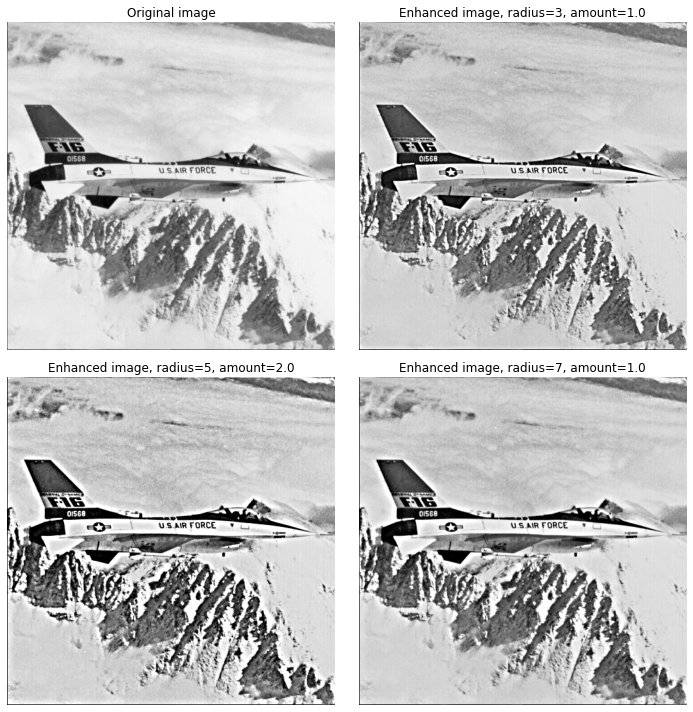

-------------Unsharp Mask Filter--Kernel Size:5-------------


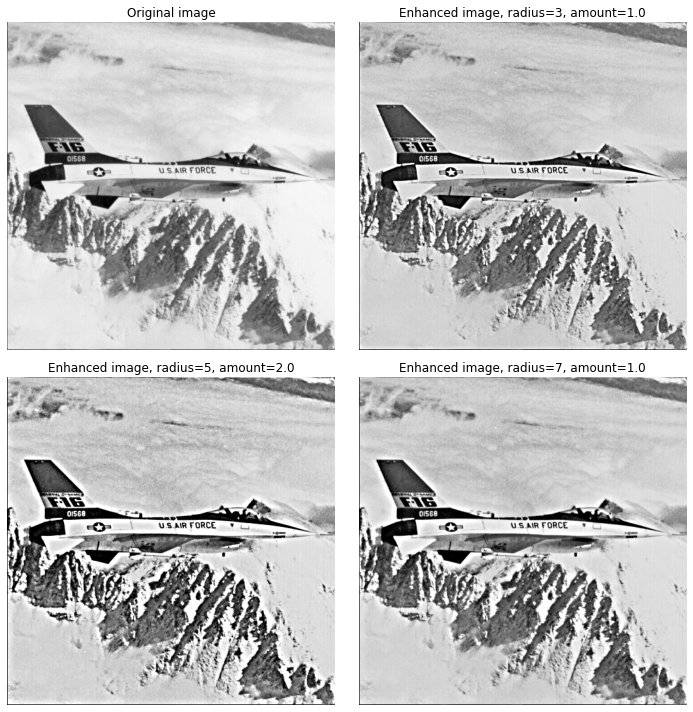

-------------Unsharp Mask Filter--Kernel Size:7-------------


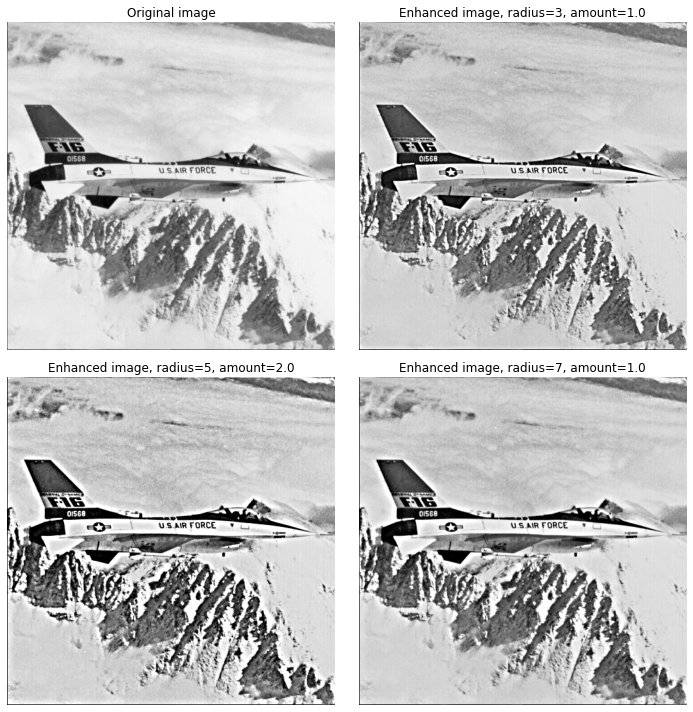

---------------File:baboon.png-------------
-------------Unsharp Mask Filter--Kernel Size:3-------------


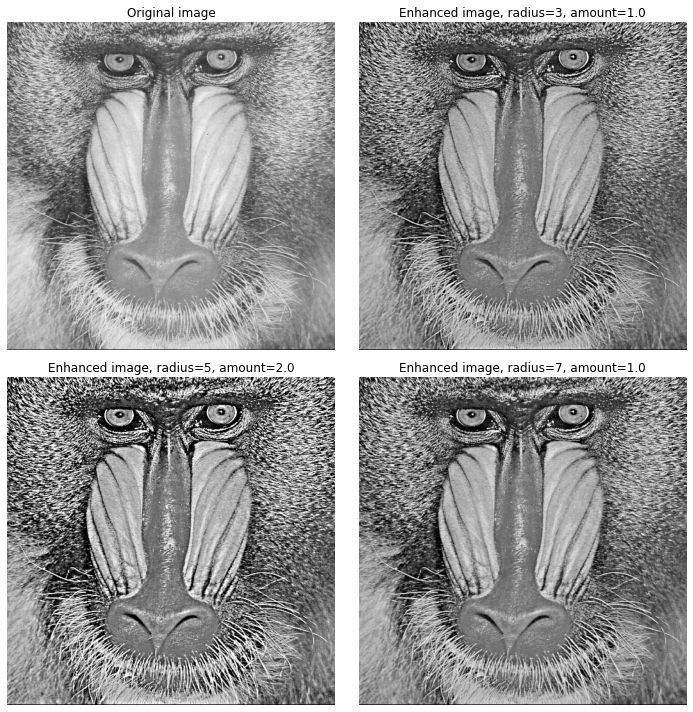

-------------Unsharp Mask Filter--Kernel Size:5-------------


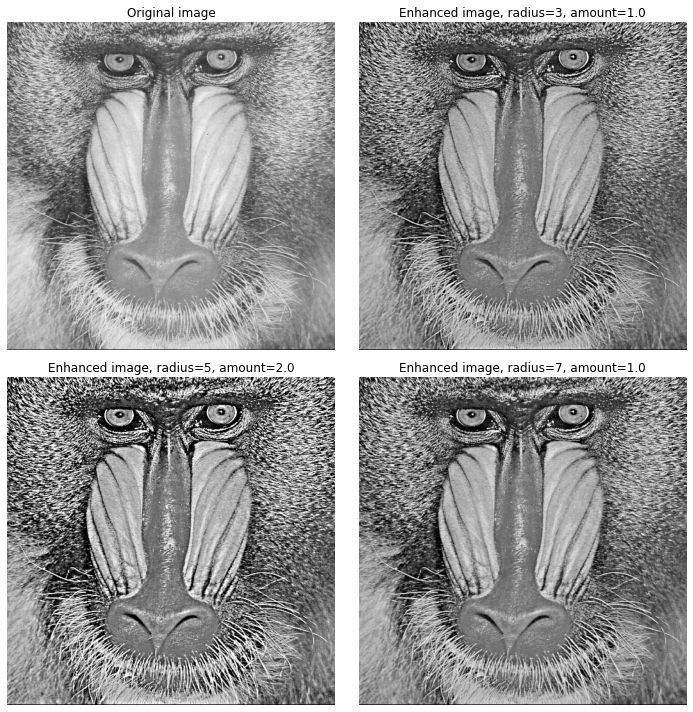

-------------Unsharp Mask Filter--Kernel Size:7-------------


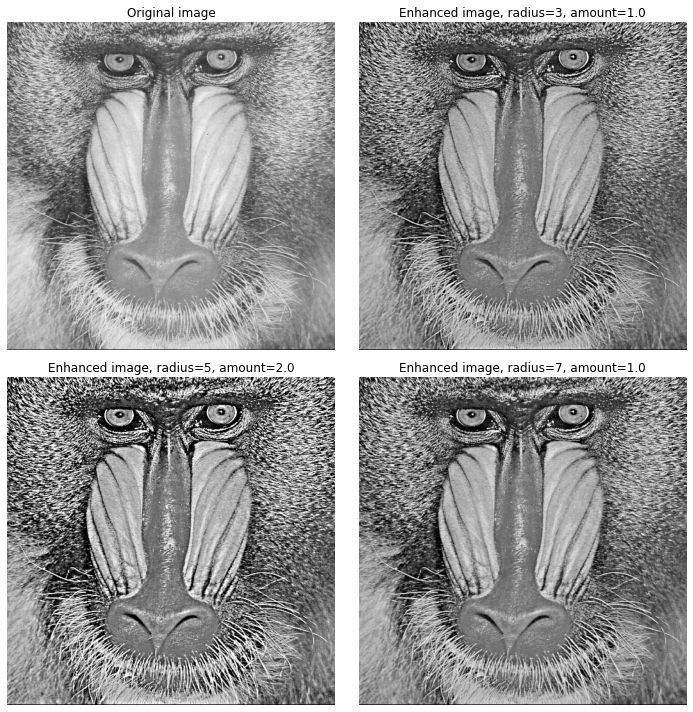

---------------File:lena.png-------------
-------------Unsharp Mask Filter--Kernel Size:3-------------


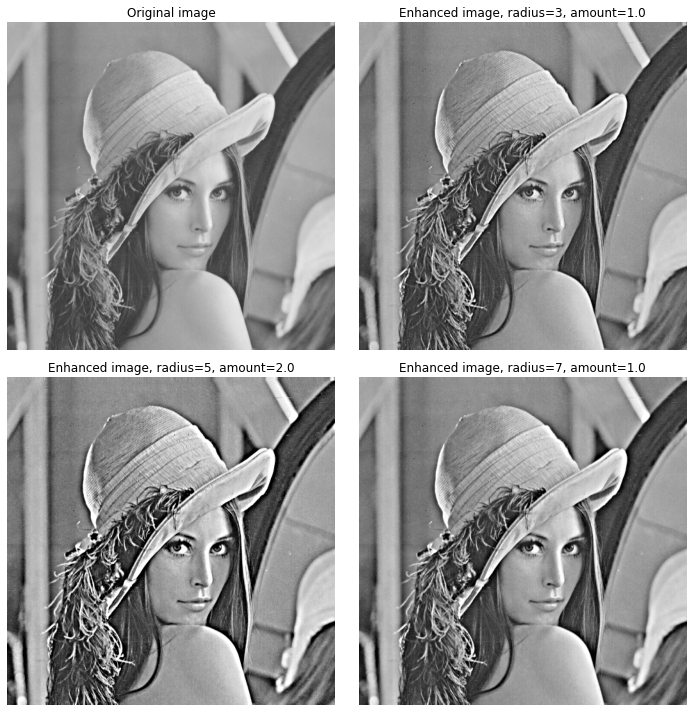

-------------Unsharp Mask Filter--Kernel Size:5-------------


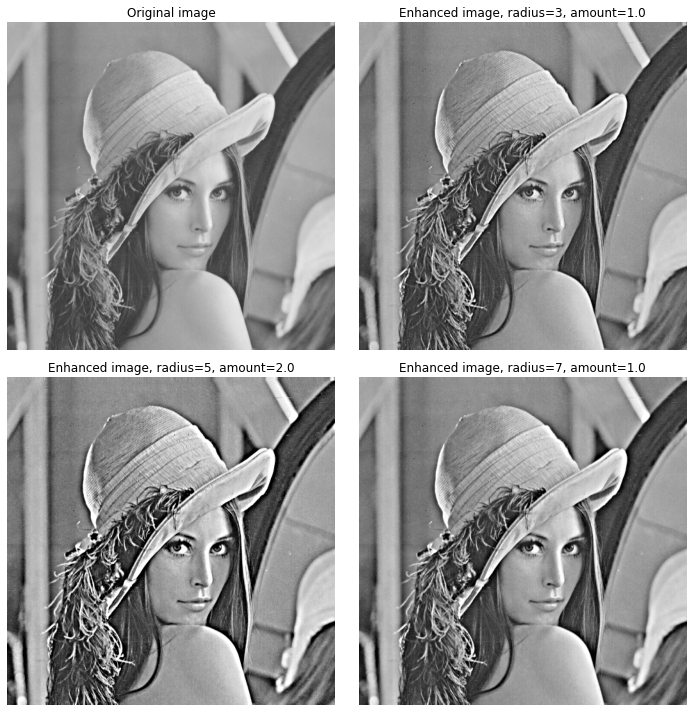

-------------Unsharp Mask Filter--Kernel Size:7-------------


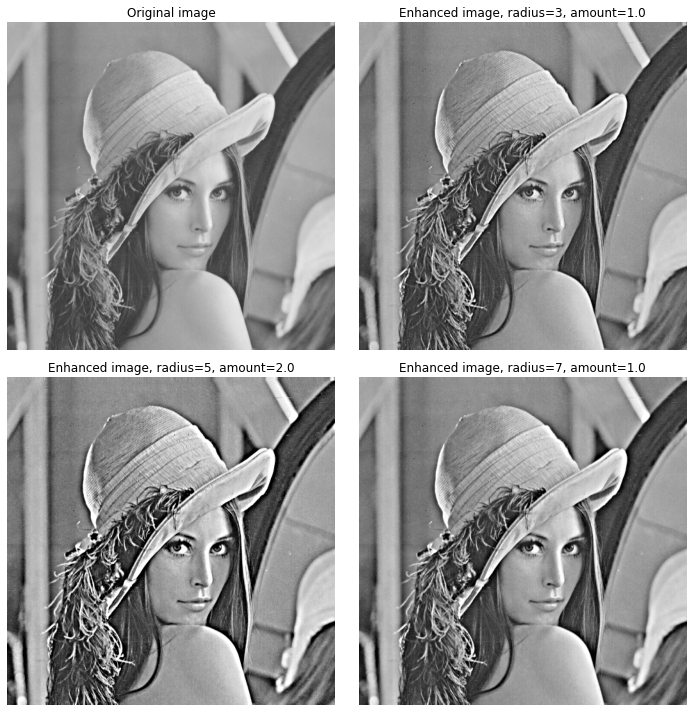

In [ ]:
for name in ['F16.png', 'baboon.png', 'lena.png']:
   
        matplotlib.rcParams['font.size'] = 10
                
        # Read image
        im = np.array(Image.open(name).convert('L'), dtype = 'uint8')

        print('---------------File:'+str(name)+'-------------')   
        # pyplot.imshow(im)
        # pyplot.show() 
        # pyplot.imshow(im, cmap=plt.cm.gray)
        # pyplot.show() 
        
        for i in [3, 5, 7]:


            #Unsharp Mask Filter
            result_1 = unsharp_mask(im, radius=3, amount=1)
            result_2 = unsharp_mask(im, radius=5, amount=2)
            result_3 = unsharp_mask(im, radius=7, amount=1)

            fig, axes = plt.subplots(nrows=2, ncols=2,sharex=True, sharey=True, figsize=(10, 10))
            ax = axes.ravel()

            ax[0].imshow(im, cmap=plt.cm.gray)
            ax[0].set_title('Original image')
            ax[1].imshow(result_1, cmap=plt.cm.gray)
            ax[1].set_title('Enhanced image, radius=3, amount=1.0')
            ax[2].imshow(result_2, cmap=plt.cm.gray)
            ax[2].set_title('Enhanced image, radius=5, amount=2.0')
            ax[3].imshow(result_3, cmap=plt.cm.gray)
            ax[3].set_title('Enhanced image, radius=7, amount=1.0')

            print('-------------'+'Unsharp Mask Filter'+'--Kernel Size:'+str(i)+'-------------')

            for a in ax:
                a.axis('off')
            fig.tight_layout()
            plt.show()

            

####Laplacian Filter

In [ ]:
import cv2
import math
import numpy as np
import matplotlib.pyplot as plot
import matplotlib.cm as cm
import sys
import pylab
from matplotlib.widgets import Slider

In [ ]:
# Copyright (C) 2003-2005 Peter J. Verveer
#
# Redistribution and use in source and binary forms, with or without
# modification, are permitted provided that the following conditions
# are met:
#
# 1. Redistributions of source code must retain the above copyright
#    notice, this list of conditions and the following disclaimer.
#
# 2. Redistributions in binary form must reproduce the above
#    copyright notice, this list of conditions and the following
#    disclaimer in the documentation and/or other materials provided
#    with the distribution.
#
# 3. The name of the author may not be used to endorse or promote
#    products derived from this software without specific prior
#    written permission.
#
# THIS SOFTWARE IS PROVIDED BY THE AUTHOR ``AS IS'' AND ANY EXPRESS
# OR IMPLIED WARRANTIES, INCLUDING, BUT NOT LIMITED TO, THE IMPLIED
# WARRANTIES OF MERCHANTABILITY AND FITNESS FOR A PARTICULAR PURPOSE
# ARE DISCLAIMED. IN NO EVENT SHALL THE AUTHOR BE LIABLE FOR ANY
# DIRECT, INDIRECT, INCIDENTAL, SPECIAL, EXEMPLARY, OR CONSEQUENTIAL
# DAMAGES (INCLUDING, BUT NOT LIMITED TO, PROCUREMENT OF SUBSTITUTE
# GOODS OR SERVICES; LOSS OF USE, DATA, OR PROFITS; OR BUSINESS
# INTERRUPTION) HOWEVER CAUSED AND ON ANY THEORY OF LIABILITY,
# WHETHER IN CONTRACT, STRICT LIABILITY, OR TORT (INCLUDING
# NEGLIGENCE OR OTHERWISE) ARISING IN ANY WAY OUT OF THE USE OF THIS
# SOFTWARE, EVEN IF ADVISED OF THE POSSIBILITY OF SUCH DAMAGE.

from collections.abc import Iterable
import warnings
import numpy


def _extend_mode_to_code(mode):
    """Convert an extension mode to the corresponding integer code.
    """
    if mode == 'nearest':
        return 0
    elif mode == 'wrap':
        return 1
    elif mode in ['reflect', 'grid-mirror']:
        return 2
    elif mode == 'mirror':
        return 3
    elif mode == 'constant':
        return 4
    elif mode == 'grid-wrap':
        return 5
    elif mode == 'grid-constant':
        return 6
    else:
        raise RuntimeError('boundary mode not supported')


def _normalize_sequence(input, rank):
    """If input is a scalar, create a sequence of length equal to the
    rank by duplicating the input. If input is a sequence,
    check if its length is equal to the length of array.
    """
    is_str = isinstance(input, str)
    if not is_str and isinstance(input, Iterable):
        normalized = list(input)
        if len(normalized) != rank:
            err = "sequence argument must have length equal to input rank"
            raise RuntimeError(err)
    else:
        normalized = [input] * rank
    return normalized


def _get_output(output, input, shape=None, complex_output=False):
    if shape is None:
        shape = input.shape
    if output is None:
        if not complex_output:
            output = numpy.zeros(shape, dtype=input.dtype.name)
        else:
            complex_type = numpy.promote_types(input.dtype, numpy.complex64)
            output = numpy.zeros(shape, dtype=complex_type)
    elif isinstance(output, (type, numpy.dtype)):
        # Classes (like `np.float32`) and dtypes are interpreted as dtype
        if complex_output and numpy.dtype(output).kind != 'c':
            warnings.warn("promoting specified output dtype to complex")
            output = numpy.promote_types(output, numpy.complex64)
        output = numpy.zeros(shape, dtype=output)
    elif isinstance(output, str):
        output = numpy.sctypeDict[output]
        if complex_output and numpy.dtype(output).kind != 'c':
            raise RuntimeError("output must have complex dtype")
        output = numpy.zeros(shape, dtype=output)
    elif output.shape != shape:
        raise RuntimeError("output shape not correct")
    elif complex_output and output.dtype.kind != 'c':
        raise RuntimeError("output must have complex dtype")
    return output

In [ ]:
__all__ = ['correlate1d', 'convolve1d', 'gaussian_filter1d', 'gaussian_filter',
           'prewitt', 'sobel', 'generic_laplace', 'laplace',
           'gaussian_laplace', 'generic_gradient_magnitude',
           'gaussian_gradient_magnitude', 'correlate', 'convolve',
           'uniform_filter1d', 'uniform_filter', 'minimum_filter1d',
           'maximum_filter1d', 'minimum_filter', 'maximum_filter',
           'rank_filter', 'median_filter', 'percentile_filter',
           'generic_filter1d', 'generic_filter']


def _invalid_origin(origin, lenw):
    return (origin < -(lenw // 2)) or (origin > (lenw - 1) // 2)


def _complex_via_real_components(func, input, weights, output, cval, **kwargs):
    """Complex convolution via a linear combination of real convolutions."""
    complex_input = input.dtype.kind == 'c'
    complex_weights = weights.dtype.kind == 'c'
    if complex_input and complex_weights:
        # real component of the output
        func(input.real, weights.real, output=output.real,
             cval=numpy.real(cval), **kwargs)
        output.real -= func(input.imag, weights.imag, output=None,
                            cval=numpy.imag(cval), **kwargs)
        # imaginary component of the output
        func(input.real, weights.imag, output=output.imag,
             cval=numpy.real(cval), **kwargs)
        output.imag += func(input.imag, weights.real, output=None,
                            cval=numpy.imag(cval), **kwargs)
    elif complex_input:
        func(input.real, weights, output=output.real, cval=numpy.real(cval),
             **kwargs)
        func(input.imag, weights, output=output.imag, cval=numpy.imag(cval),
             **kwargs)
    else:
        if numpy.iscomplexobj(cval):
            raise ValueError("Cannot provide a complex-valued cval when the "
                             "input is real.")
        func(input, weights.real, output=output.real, cval=cval, **kwargs)
        func(input, weights.imag, output=output.imag, cval=cval, **kwargs)
    return output

In [ ]:
from numpy.core.multiarray import normalize_axis_index
def correlate1d(input, weights, axis=-1, output=None, mode="reflect",
                cval=0.0, origin=0):
    """Calculate a 1-D correlation along the given axis.
    The lines of the array along the given axis are correlated with the
    given weights.
    Parameters
    ----------
    %(input)s
    weights : array
        1-D sequence of numbers.
    %(axis)s
    %(output)s
    %(mode_reflect)s
    %(cval)s
    %(origin)s
    Examples
    --------
    >>> from scipy.ndimage import correlate1d
    >>> correlate1d([2, 8, 0, 4, 1, 9, 9, 0], weights=[1, 3])
    array([ 8, 26,  8, 12,  7, 28, 36,  9])
    """
    input = numpy.asarray(input)
    weights = numpy.asarray(weights)
    complex_input = input.dtype.kind == 'c'
    complex_weights = weights.dtype.kind == 'c'
    if complex_input or complex_weights:
        if complex_weights:
            weights = weights.conj()
            weights = weights.astype(numpy.complex128, copy=False)
        kwargs = dict(axis=axis, mode=mode, origin=origin)
        output =_get_output(output, input, complex_output=True)
        return _complex_via_real_components(correlate1d, input, weights,
                                            output, cval, **kwargs)

    output = _get_output(output, input)
    weights = numpy.asarray(weights, dtype=numpy.float64)
    if weights.ndim != 1 or weights.shape[0] < 1:
        raise RuntimeError('no filter weights given')
    if not weights.flags.contiguous:
        weights = weights.copy()
    axis = normalize_axis_index(axis, input.ndim)
    if _invalid_origin(origin, len(weights)):
        raise ValueError('Invalid origin; origin must satisfy '
                         '-(len(weights) // 2) <= origin <= '
                         '(len(weights)-1) // 2')
    mode = _extend_mode_to_code(mode)
    correlate1d(input, weights, axis, output, mode, cval,
                          origin)
    return output

In [ ]:
def generic_laplace(input, derivative2, output=None, mode="reflect",
                    cval=0.0,
                    extra_arguments=(),
                    extra_keywords=None):
    """
    N-D Laplace filter using a provided second derivative function.
    Parameters
    ----------
    %(input)s
    derivative2 : callable
        Callable with the following signature::
            derivative2(input, axis, output, mode, cval,
                        *extra_arguments, **extra_keywords)
        See `extra_arguments`, `extra_keywords` below.
    %(output)s
    %(mode_multiple)s
    %(cval)s
    %(extra_keywords)s
    %(extra_arguments)s
    """
    if extra_keywords is None:
        extra_keywords = {}
    input = numpy.asarray(input)
    output = _get_output(output, input)
    axes = list(range(input.ndim))
    if len(axes) > 0:
        modes = _normalize_sequence(mode, len(axes))
        derivative2(input, axes[0], output, modes[0], cval,
                    *extra_arguments, **extra_keywords)
        for ii in range(1, len(axes)):
            tmp = derivative2(input, axes[ii], output.dtype, modes[ii], cval,
                              *extra_arguments, **extra_keywords)
            output += tmp
    else:
        output[...] = input[...]
    return output


In [ ]:
def laplace(input, output=None, mode="reflect", cval=0.0):
    """N-D Laplace filter based on approximate second derivatives.
    Parameters
    ----------
    %(input)s
    %(output)s
    %(mode_multiple)s
    %(cval)s
    Examples
    --------
    >>> from scipy import ndimage, misc
    >>> import matplotlib.pyplot as plt
    >>> fig = plt.figure()
    >>> plt.gray()  # show the filtered result in grayscale
    >>> ax1 = fig.add_subplot(121)  # left side
    >>> ax2 = fig.add_subplot(122)  # right side
    >>> ascent = misc.ascent()
    >>> result = ndimage.laplace(ascent)
    >>> ax1.imshow(ascent)
    >>> ax2.imshow(result)
    >>> plt.show()
    """
    def derivative2(input, axis, output, mode, cval):
        return correlate1d(input, [1, -2, 1], axis, output, mode, cval, 0)
    return generic_laplace(input, derivative2, output, mode, cval)

---------------File:F16.png-------------


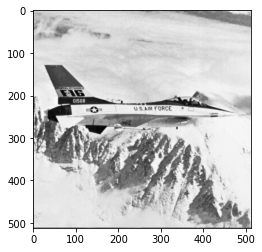

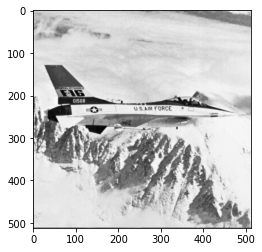

-------------Laplacian Filter--Kernel Size:3-------------


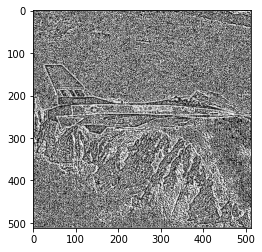

-------------Laplacian Filter--Kernel Size:5-------------


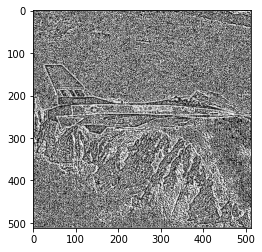

-------------Laplacian Filter--Kernel Size:7-------------


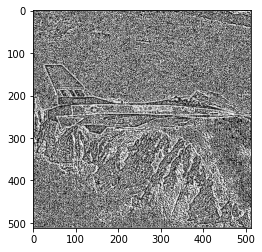

---------------File:baboon.png-------------


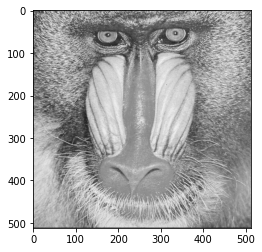

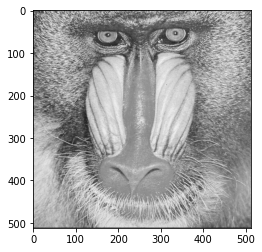

-------------Laplacian Filter--Kernel Size:3-------------


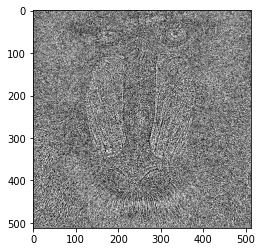

-------------Laplacian Filter--Kernel Size:5-------------


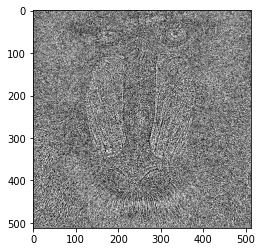

-------------Laplacian Filter--Kernel Size:7-------------


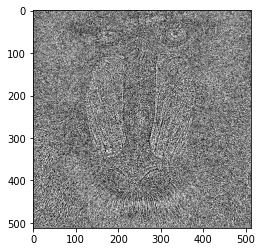

---------------File:lena.png-------------


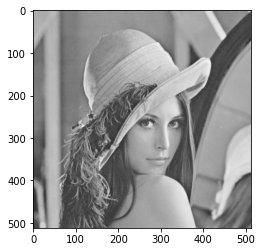

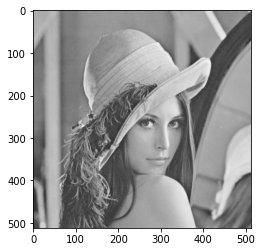

-------------Laplacian Filter--Kernel Size:3-------------


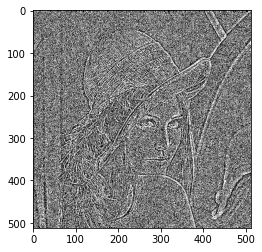

-------------Laplacian Filter--Kernel Size:5-------------


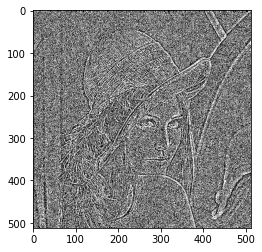

-------------Laplacian Filter--Kernel Size:7-------------


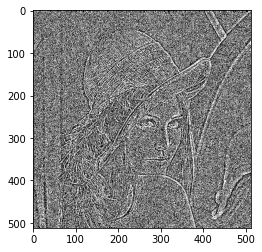

In [ ]:
from scipy import ndimage, misc
for name in ['F16.png', 'baboon.png', 'lena.png']:
   
        matplotlib.rcParams['font.size'] = 10
                
        # Read image
        im = np.array(Image.open(name).convert('L'), dtype = 'uint8')

        print('---------------File:'+str(name)+'-------------')   
        pyplot.imshow(im)
        pyplot.show() 
        pyplot.imshow(im, cmap=plt.cm.gray)
        pyplot.show() 
        
        for i in [3, 5, 7]:

            #Laplacian filter blur
            fig = plt.figure()
            result = ndimage.laplace(im)

            #cv2.imwrite('avg_blurred_'+str(name)+'.png', lp)
            print('-------------'+'Laplacian Filter'+'--Kernel Size:'+str(i)+'-------------')

            pyplot.imshow(result, cmap=plt.cm.gray)
            pyplot.show()

####Sobel Filter

In [ ]:
def sobel_edge_detection(image, filter, verbose=False):
    new_image_x = convolution(image, filter, verbose)
 
    if verbose:
        plt.imshow(new_image_x, cmap='gray')
        plt.title("Horizontal Edge")
        plt.show()
 
    new_image_y = convolution(image, np.flip(filter.T, axis=0), verbose)
 
    if verbose:
        plt.imshow(new_image_y, cmap='gray')
        plt.title("Vertical Edge")
        plt.show()
 
    gradient_magnitude = np.sqrt(np.square(new_image_x) + np.square(new_image_y))
 
    gradient_magnitude *= 255.0 / gradient_magnitude.max()
 
    if verbose:
        plt.imshow(gradient_magnitude, cmap='gray')
        plt.title("Gradient Magnitude")
        plt.show()
 
    return gradient_magnitude

---------------File:F16.png-------------


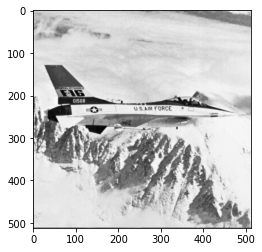

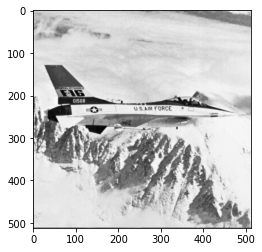

Image Shape : (512, 512)
Kernel Shape : (3, 3)
Output Image size : (512, 512)
Image Shape : (512, 512)
Kernel Shape : (3, 3)
Output Image size : (512, 512)
-------------Sobel_edge_detection--Kernel Size:3-------------


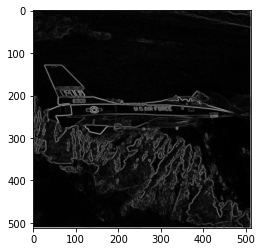

Image Shape : (512, 512)
Kernel Shape : (5, 5)
Output Image size : (512, 512)
Image Shape : (512, 512)
Kernel Shape : (5, 5)
Output Image size : (512, 512)
-------------Sobel_edge_detection--Kernel Size:5-------------


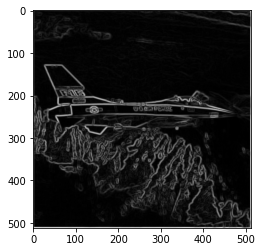

Image Shape : (512, 512)
Kernel Shape : (7, 7)
Output Image size : (512, 512)
Image Shape : (512, 512)
Kernel Shape : (7, 7)
Output Image size : (512, 512)
-------------Sobel_edge_detection--Kernel Size:7-------------


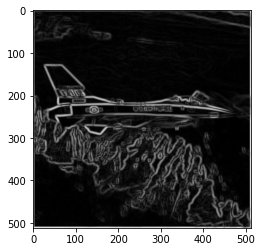

---------------File:baboon.png-------------


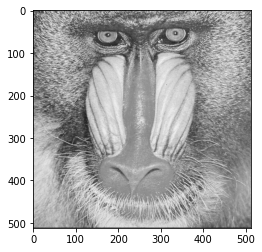

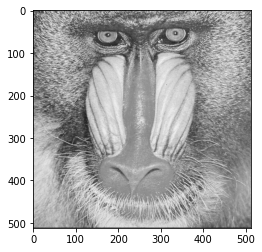

Image Shape : (512, 512)
Kernel Shape : (3, 3)
Output Image size : (512, 512)
Image Shape : (512, 512)
Kernel Shape : (3, 3)
Output Image size : (512, 512)
-------------Sobel_edge_detection--Kernel Size:3-------------


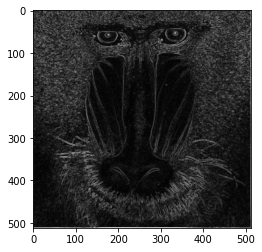

Image Shape : (512, 512)
Kernel Shape : (5, 5)
Output Image size : (512, 512)
Image Shape : (512, 512)
Kernel Shape : (5, 5)
Output Image size : (512, 512)
-------------Sobel_edge_detection--Kernel Size:5-------------


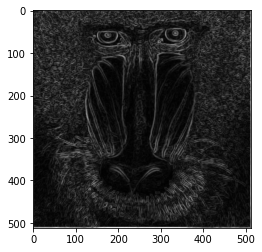

Image Shape : (512, 512)
Kernel Shape : (7, 7)
Output Image size : (512, 512)
Image Shape : (512, 512)
Kernel Shape : (7, 7)
Output Image size : (512, 512)
-------------Sobel_edge_detection--Kernel Size:7-------------


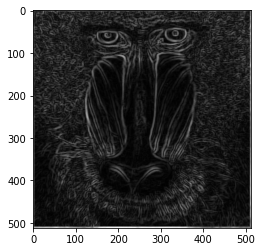

---------------File:lena.png-------------


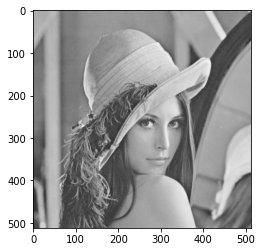

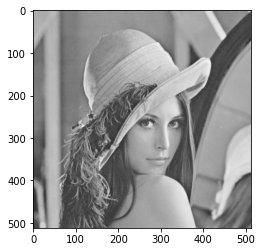

Image Shape : (512, 512)
Kernel Shape : (3, 3)
Output Image size : (512, 512)
Image Shape : (512, 512)
Kernel Shape : (3, 3)
Output Image size : (512, 512)
-------------Sobel_edge_detection--Kernel Size:3-------------


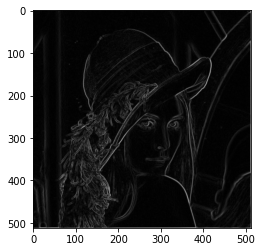

Image Shape : (512, 512)
Kernel Shape : (5, 5)
Output Image size : (512, 512)
Image Shape : (512, 512)
Kernel Shape : (5, 5)
Output Image size : (512, 512)
-------------Sobel_edge_detection--Kernel Size:5-------------


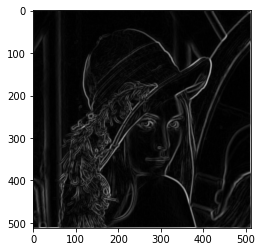

Image Shape : (512, 512)
Kernel Shape : (7, 7)
Output Image size : (512, 512)
Image Shape : (512, 512)
Kernel Shape : (7, 7)
Output Image size : (512, 512)
-------------Sobel_edge_detection--Kernel Size:7-------------


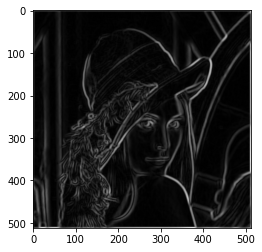

In [ ]:
for name in ['F16.png', 'baboon.png', 'lena.png']:
   
        matplotlib.rcParams['font.size'] = 10
                
        # Read image
        im = np.array(Image.open(name).convert('L'), dtype = 'uint8')

        print('---------------File:'+str(name)+'-------------')   
        pyplot.imshow(im)
        pyplot.show() 
        pyplot.imshow(im, cmap=plt.cm.gray)
        pyplot.show() 
        
        

        #Sobel filter blur
        filter = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
        fig = plt.figure()
        result = sobel_edge_detection(im, filter)
        #cv2.imwrite('Sobel_blurred_'+str(name)+'.png', lp)
        print('-------------'+'Sobel_edge_detection'+'--Kernel Size:3-------------')

        pyplot.imshow(result, cmap=plt.cm.gray)
        pyplot.show()

        #Sobel filter blur
        filter = np.array([[-2, -1, 0, 1,2],[-2, -1, 0, 1,2],[-2, -1, 0, 1,2], [-2,-1, 0, 1,2], [-2, -1, 0, 1,2]])
        fig = plt.figure()
        result = sobel_edge_detection(im, filter)
        #cv2.imwrite('Sobel_blurred_'+str(name)+'.png', lp)
        print('-------------'+'Sobel_edge_detection'+'--Kernel Size:5-------------')

        pyplot.imshow(result, cmap=plt.cm.gray)
        pyplot.show()

        #Sobel filter blur
        filter = np.array([[-4,-2, -1, 0, 1,2,4],[-4,-2, -1, 0, 1,2,4],[-4,-2, -1, 0, 1,2,4], [-4,-2, -1, 0, 1,2,4], [-4,-2, -1, 0, 1,2,4], [-4,-2, -1, 0, 1,2,4], [-4,-2, -1, 0, 1,2,4]])
        fig = plt.figure()
        result = sobel_edge_detection(im, filter)
        #cv2.imwrite('Sobel_blurred_'+str(name)+'.png', lp)
        print('-------------'+'Sobel_edge_detection'+'--Kernel Size:7-------------')

        pyplot.imshow(result, cmap=plt.cm.gray)
        pyplot.show()

##3.Convolution-2

####Kernel 1

---------------File:F16.png-------------


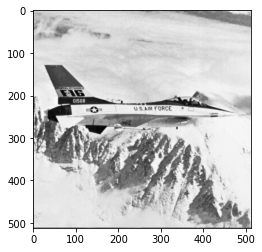

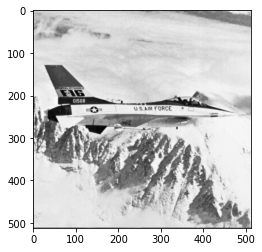

Image Shape : (512, 512)
Kernel Shape : (3, 3)
Output Image size : (512, 512)
Image Shape : (512, 512)
Kernel Shape : (3, 3)
Output Image size : (512, 512)
-------------Kernel 1--Kernel Size:3-------------


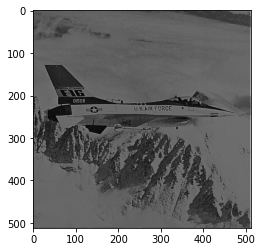

---------------File:baboon.png-------------


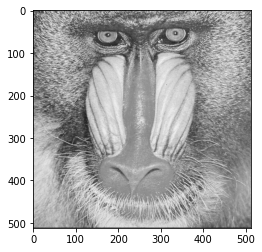

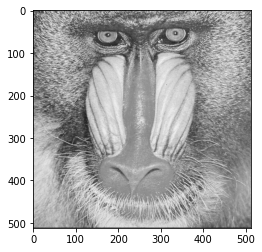

Image Shape : (512, 512)
Kernel Shape : (3, 3)
Output Image size : (512, 512)
Image Shape : (512, 512)
Kernel Shape : (3, 3)
Output Image size : (512, 512)
-------------Kernel 1--Kernel Size:3-------------


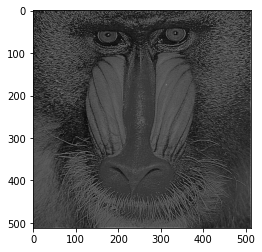

---------------File:lena.png-------------


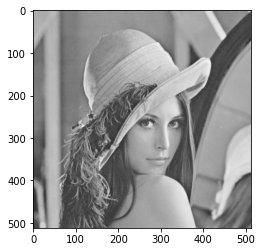

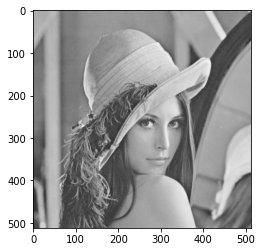

Image Shape : (512, 512)
Kernel Shape : (3, 3)
Output Image size : (512, 512)
Image Shape : (512, 512)
Kernel Shape : (3, 3)
Output Image size : (512, 512)
-------------Kernel 1--Kernel Size:3-------------


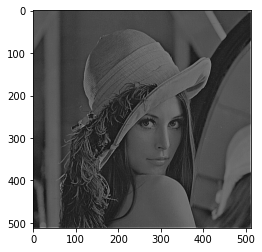

In [ ]:
for name in ['F16.png', 'baboon.png', 'lena.png']:
   
        matplotlib.rcParams['font.size'] = 10
                
        # Read image
        im = np.array(Image.open(name).convert('L'), dtype = 'uint8')

        print('---------------File:'+str(name)+'-------------')   
        pyplot.imshow(im)
        pyplot.show() 
        pyplot.imshow(im, cmap=plt.cm.gray)
        pyplot.show() 
        
        

        #k1 filter blur
        filter = np.array([[-1, 0, -1], [0, 7, -1], [-1, 0, -1]])
        fig = plt.figure()
        result = sobel_edge_detection(im, filter)
        #cv2.imwrite('Sobel_blurred_'+str(name)+'.png', lp)
        print('-------------'+'Kernel 1'+'--Kernel Size:3-------------')

        pyplot.imshow(result, cmap=plt.cm.gray)
        pyplot.show()

##4.Image denoising

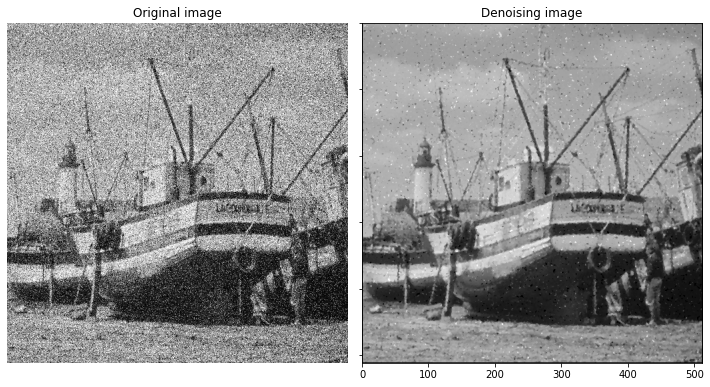

In [ ]:
#Median Filtering
# Read the image
img_noisy1 = np.array(Image.open('Noisy.png').convert('L'), dtype = 'uint8')
im = img_noisy1
# Obtain the number of rows and columns
# of the image
m, n = img_noisy1.shape
  
# Traverse the image. For every 3X3 area,
# find the median of the pixels and
# replace the center pixel by the median
img_new1 = np.zeros([m, n])
 
for i in range(1, m-1):
    for j in range(1, n-1):
        temp = [img_noisy1[i-1, j-1],
               img_noisy1[i-1, j],
               img_noisy1[i-1, j + 1],
               img_noisy1[i, j-1],
               img_noisy1[i, j],
               img_noisy1[i, j + 1],
               img_noisy1[i + 1, j-1],
               img_noisy1[i + 1, j],
               img_noisy1[i + 1, j + 1]]
         
        temp = sorted(temp)
        img_new1[i, j]= temp[4]
 
img_new1 = img_new1.astype(np.uint8)
cv2.imwrite('new_median_filtered.png', img_new1)

fig, axes = plt.subplots(nrows=1, ncols=2,sharex= True, sharey= True, figsize=(10, 10))
ax = axes.ravel()

ax[0].imshow(im, cmap=plt.cm.gray)
ax[0].set_title('Original image')
ax[1].imshow(img_new1, cmap=plt.cm.gray)
ax[1].set_title('Denoising image')

for a in ax:
  a.axis('off')
  fig.tight_layout()
  plt.show()            

##5.Bilateral Filter
A filter that smooths images while preserving edges.

According to mathematical formulas, we implemented a filter. This code visits all pixels and changes their intensities with the new, calculated values. Changing pixels one by one is a big thing so it takes some time.

####Without Gaussian Smoothing

In [ ]:
def distance(i, j):
    return np.absolute(i-j)

def bilateral_filter_without_gaussian(i,j,d,I,sigma_r):
    arr=[]
    sum_num=0
    sum_den=0
    for k in range(i-math.floor(d/2),i+math.ceil(d/2)):
        for l in range(j-math.floor(d/2),j+math.ceil(d/2)):
            term=(distance(I[i,j],I[k,l]))/(sigma_r**2*2)
            w=math.exp(-term)
            arr.append(w)
            sum_num=sum_num+(I[k,l]*w)
            sum_den=sum_den+w      
    return sum_num/sum_den 

In [ ]:
"""
The bilateral filter is controlled by important parameters. Two of them are sigma values.
Generally, the bilateral filter gives us more control over image.
If we increment both sigma values at the same time, the bigger sigma values gives us a
more blurred image. If we give sigma values near zero, smoothing does not occur. Changing sigma i
directly affects the blur effect on the image. However, sigma s does not affect blur rate. There
is no big effect on the image after changing only the sigma s. Sharpness does not necessary that
much with sigma s rather than sigma i. To have a more blurred image, we should take sigma values
bigger.
"""

'\nThe bilateral filter is controlled by important parameters. Two of them are sigma values.\nGenerally, the bilateral filter gives us more control over image.\nIf we increment both sigma values at the same time, the bigger sigma values gives us a\nmore blurred image. If we give sigma values near zero, smoothing does not occur. Changing sigma i\ndirectly affects the blur effect on the image. However, sigma s does not affect blur rate. There\nis no big effect on the image after changing only the sigma s. Sharpness does not necessary that\nmuch with sigma s rather than sigma i. To have a more blurred image, we should take sigma values\nbigger.\n'

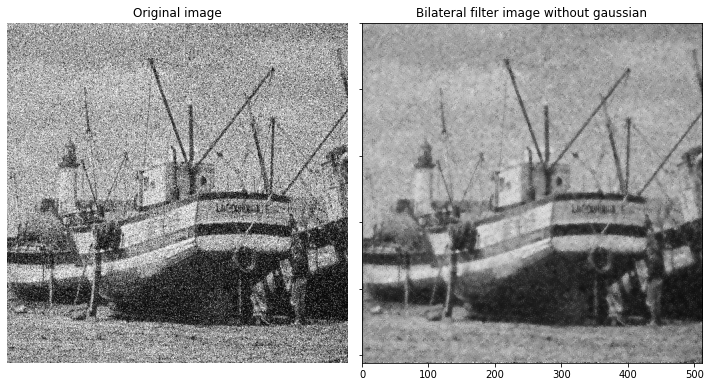

In [ ]:
img = Image.open('Noisy.png').convert('L')      
img.load()
I = np.asarray( img, dtype="float" )
data=I
radius=7
#print(I)

I=np.lib.pad(I, 1, 'mean')
I_new=np.copy(data)
for i in range(1,data.shape[0]):
    for j in range(1,data.shape[1]):
        I_new[i-1,j-1]=bilateral_filter_without_gaussian(i-1,j-1,radius,I,6.5)
        #print(I_new[i-1,j-1])
plt.imsave('bilateral_filtering_without gaussian.png',I_new,cmap='gray')
    #isnr_calc(img,Image.fromarray(I_new))

fig, axes = plt.subplots(nrows=1, ncols=2,sharex= True, sharey= True, figsize=(10, 10))
ax = axes.ravel()

ax[0].imshow(img, cmap=plt.cm.gray)
ax[0].set_title('Original image')
ax[1].imshow(I_new, cmap=plt.cm.gray)
ax[1].set_title('Bilateral filter image without gaussian')

for a in ax:
  a.axis('off')
  fig.tight_layout()
  plt.show() 

####With Gaussian Smoothing

In [ ]:
def distance(i, j):
    return np.absolute(i-j)

def bilateral_filter(i,j,d,I,sigma_d,sigma_r):
    arr=[]
    sum_num=0
    sum_den=0
    
    for k in range(i-math.floor(d/2),i+math.ceil(d/2)):
        for l in range(j-math.floor(d/2),j+math.ceil(d/2)):
            term1=(((i-k)**2)+(j-l)**2)/(sigma_d**2*2)
            term2=(distance(I[i,j],I[k,l]))/(sigma_r**2*2)
            term=term1+term2
            w=math.exp(-term)
            arr.append(w)
            sum_num=sum_num+(I[k,l]*w)
            sum_den=sum_den+w      
    return sum_num/sum_den 

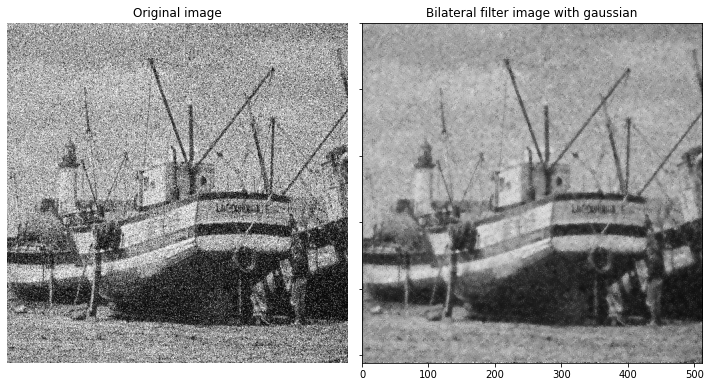

In [ ]:
img = Image.open('Noisy.png').convert('L')      
img.load()
I = np.asarray( img, dtype="float" )
data=I
radius=7
#print(I)

I=np.lib.pad(I, 1, 'mean')
I_new=np.copy(data)
for i in range(1,data.shape[0]):
    for j in range(1,data.shape[1]):
        I_new[i-1,j-1]=bilateral_filter(i-1,j-1,radius,I,7,6.5)
        #print(I_new[i-1,j-1])
plt.imsave('bilateral_filtering_Noisy.png',I_new,cmap='gray')
    #isnr_calc(img,Image.fromarray(I_new))

fig, axes = plt.subplots(nrows=1, ncols=2,sharex= True, sharey= True, figsize=(10, 10))
ax = axes.ravel()

ax[0].imshow(img, cmap=plt.cm.gray)
ax[0].set_title('Original image')
ax[1].imshow(I_new, cmap=plt.cm.gray)
ax[1].set_title('Bilateral filter image with gaussian')

for a in ax:
  a.axis('off')
  fig.tight_layout()
  plt.show() 